<center><h1>1-ab: Introduction to Neural Networks</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [ ]:
!wget https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
!unzip -j 2-ab.zip
!wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-ab/utils-data.py

In [2]:
import warnings

import math
import torch
import torch.nn as nn
from torch.autograd import Variable
from tqdm import tqdm
import numpy as np
#from torchmetrics import Accuracy

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib as mpl

%run 'utils-data.py'

In [4]:
mpl.rcParams['lines.linewidth'] = 2
mpl.rcParams['lines.linestyle'] = '--'

plt.style.use('seaborn')

warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Part 1 : Forward and backward passes "by hands"

In [5]:
def init_params(nx, nh, ny, std = 0.3, mean = 0):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by

    # requires_grad = False because of manual backprob. This is the default for new tensors.
    # all weights will be initialized according to a normal distribution of mean 0 and standard deviation 0.3.

    #Initialize randomly
    params["Wh"] = torch.randn(nx, nh) * std
    params["Wy"] = torch.randn(nh, ny) * std

    #Initialize as zero vectors
    params["bh"] = torch.randn(nh) #* std
    params["by"] = torch.randn(ny) #* std #

    ####################
    ##      END        #
    ####################

    return params

In [6]:
#Test init_params function
my_params = init_params(nx = 4, nh = 3, ny = 5)
my_params

{'Wh': tensor([[-0.0820,  0.6908,  0.3176],
         [-0.3905, -0.0112,  0.5601],
         [-0.0677, -0.2372,  0.1140],
         [-0.1383,  0.1798,  0.1425]]),
 'Wy': tensor([[ 0.1058, -0.5081,  0.1909, -0.0531, -0.5755],
         [-0.3616, -0.0563, -0.0008, -0.3137,  0.1832],
         [ 0.5028, -0.0449,  0.2730,  0.0451,  0.2290]]),
 'bh': tensor([-0.7003, -0.4668,  1.0122]),
 'by': tensor([ 0.4152,  0.6649,  0.2289,  1.5147, -1.3492])}

In [8]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.shape[0]

    #Use shape instead of size
    nh = params['Wh'].shape[0]  #nh = params['Wh'].size(0)
    ny = params['Wy'].shape[0]  #ny = params['Wy'].size(0)
    nx = X.shape[-1]

    outputs = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for X, htilde, h, ytilde, yhat

    Wh = params['Wh']
    bh = params['bh']
    Wy = params['Wy']
    by = params['by']

    # Calculate htilde before activation of hidden layer --> make sure it works with batches
    htilde = torch.mm(X, Wh) + bh

    # Apply the activation function tanh to get h (hidden layer activation)
    h = torch.tanh(htilde)

    # Calculate ytilde
    ytilde = torch.matmul(h, Wy) + by

    # Apply activation function for the output layer = softmax for multi-class classification
    yhat = torch.softmax(ytilde, dim=1)

    # Store intermediate values in outputs dictionary = cache
    outputs["X"] = X #handover new X
    outputs["htilde"] = htilde
    outputs["h"] = h
    outputs["ytilde"] = ytilde
    outputs["yhat"] = yhat

    ##      END        #
    ####################

    return outputs['yhat'], outputs

In [9]:
# define input dimensions (batch_size, input_dimension)
batch_size = 3
input_dimension = 4
X_sample = torch.randn(batch_size, input_dimension)

# Define the number of hidden units and output classes
num_hidden_units = 5
num_output_classes = 2

params = init_params(input_dimension, num_hidden_units, num_output_classes)

Yhat_sample, _ = forward(params, X_sample)

print("Sample input data:")
print(X_sample)
print("\nSample output predictions:")
print(Yhat_sample)

Sample input data:
tensor([[-1.2182,  0.4153,  0.7116, -0.6882],
        [ 0.3312,  1.9374,  1.1476, -1.0360],
        [ 0.7405,  0.4365, -1.3853, -0.8794]])

Sample output predictions:
tensor([[0.5650, 0.4350],
        [0.4908, 0.5092],
        [0.6517, 0.3483]])


In [10]:
import torch.nn.functional as F

def loss_accuracy(Yhat, Y):
    """
    Calculate the loss and accuracy of the model's predictions.

    Parameters:
    - Yhat: Predicted values (torch.Tensor) with shape (batch_size, num_classes)
    - Y: Ground truth labels (torch.Tensor) with shape (batch_size, num_classes)

    Returns:
    - L: Loss (scalar, torch.Tensor)
    - acc: Accuracy (percentage, float)
    """

    assert Yhat.size() == Y.size() # catch dimension errors early on
    epsilon = 1e-10

    L = -torch.sum(Y * torch.log(Yhat + epsilon)) / Y.size(0) # normalize by batch size, add epsilon to avoir log errors

    # Get the predicted class labels by taking the argmax along axis 1 (columns)
    _, indsY = torch.max(Yhat, 1)

    # Convert one-hot encoded true labels back to class indices
    _, inds_true = torch.max(Y, 1)

    # Compare the predicted labels with the true labels and calculate accuracy
    correct = torch.sum(indsY == inds_true)
    total = Y.size(0)  # Number of samples in the batch
    acc = correct.item() / total

    return L, acc

In [11]:
#test loss accuracy by generating samples
#3 samples (= 1 batch) with 2 classes

batch_size = 3
num_output_classes = 2

Yhat = torch.tensor([[0.7, 0.3], [0.4, 0.6], [0.9, 0.1]], dtype=torch.float32)  #predicted probabilities

Y = torch.tensor([[1, 0], [0, 1], [1, 0]], dtype=torch.float32) #one-hot encoding of classes

# Calculate loss and accuracy
loss, acc = loss_accuracy(Yhat, Y)

print("Cross-Entropy Loss:", loss.item())
print("Accuracy:", acc)

Cross-Entropy Loss: 0.3242870271205902
Accuracy: 1.0


In [12]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wy, Wh, by, bh

    # Retrieve intermediate values from the forward pass
    X = outputs["X"]
    htilde = outputs["htilde"]
    h = outputs["h"]
    ytilde = outputs["ytilde"]
    yhat = outputs["yhat"]

    dWh = torch.zeros_like(params['Wh'])
    dbh = torch.zeros_like(params['bh'])
    dWy = torch.zeros_like(params['Wy'])
    dby = torch.zeros_like(params['by'])

    # Compute the gradient of the loss with respect to yhat (cross-entropy loss derivative)

    dyhat = yhat - Y

    # Compute the gradients for the output layer
    dWy += torch.matmul(h.t(), dyhat)  # dWy = h^T * dyhat
    dby += torch.sum(dyhat, dim=0)     # dby = sum(dyhat)

    # Compute the gradient for Wh and bh
    dh = torch.matmul(dyhat, params["Wy"].t())
    dhtilde = dh * (htilde > 0).float()  # Gradient for ReLU activation

    # Backpropagate the gradients to the hidden layer
    dh = torch.matmul(dyhat, params['Wy'].t())  # dh = dyhat * Wy^T
    dh *= (1 - h * h)  # Gradient of tanh activation function

    # Compute the gradients for the hidden layer
    dWh += torch.matmul(X.t(), dh)  # dWh = X^T * dh
    dbh += torch.sum(dh, dim=0)      # dbh = sum(dh)

    # Store the gradients in a dictionary
    grads = {
        'Wh': dWh,
        'bh': dbh,
        'Wy': dWy,
        'by': dby
    }

    ####################
    ##      END        #
    ####################
    return grads

In [13]:
def sgd(params, grads, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the params values

    # batch version of sgd

    params["Wh"] -= eta * grads["Wh"]
    params["Wy"] -= eta * grads["Wy"]
    params["bh"] -= eta * grads["bh"]
    params["by"] -= eta * grads["by"]

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure "by hands"

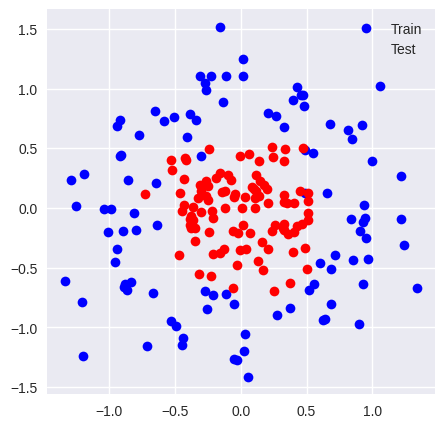

nx =  2
ny =  2
{'Wh': tensor([[ 0.2771,  0.0647, -0.1145,  0.1236, -0.1678, -0.0634,  0.1746, -0.3681,
          0.4533,  0.1265],
        [ 0.0095, -0.0105,  0.1941, -0.1614,  0.1224, -0.3891, -0.0184, -0.0489,
         -0.0658, -0.8051]]), 'Wy': tensor([[ 0.2084,  0.2287],
        [ 0.1412,  0.2701],
        [ 0.5102, -0.1939],
        [ 0.3009,  0.1886],
        [-0.1788, -0.0228],
        [-0.3970,  0.1546],
        [ 0.2493, -0.2166],
        [-0.0094, -0.2410],
        [-0.0761, -0.6773],
        [ 0.1614, -0.2215]]), 'bh': tensor([ 1.2268,  0.8069, -0.8271,  0.8652, -0.0673,  1.1568, -0.7695, -0.8884,
        -1.6487, -0.5091]), 'by': tensor([ 1.2823, -0.5151])}


  0%|          | 0/100 [00:00<?, ?it/s]

torch.Size([200, 2])
Iter 0: Acc train 0.5% (0.71), acc test 0.5% (0.71)


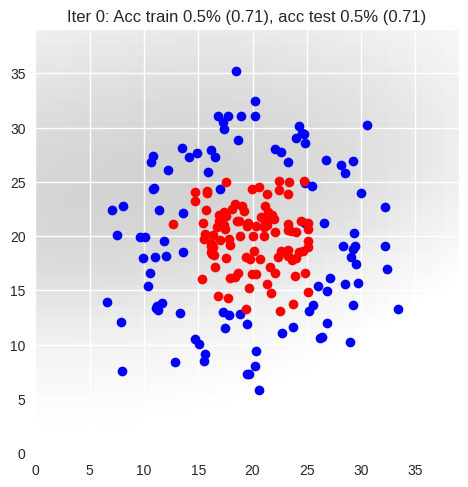

  1%|          | 1/100 [00:00<00:45,  2.17it/s]

torch.Size([200, 2])
Iter 1: Acc train 0.6% (0.67), acc test 0.6% (0.67)


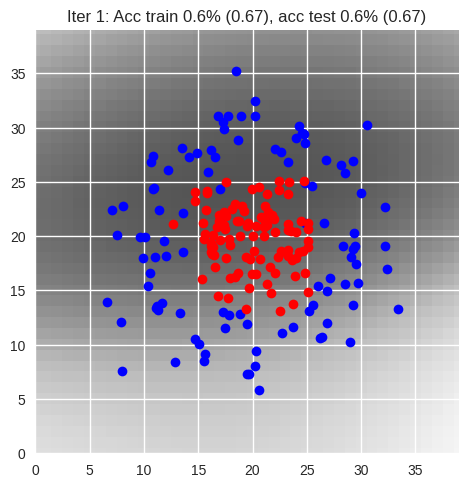

  2%|▏         | 2/100 [00:00<00:49,  1.99it/s]

torch.Size([200, 2])
Iter 2: Acc train 0.7% (0.66), acc test 0.7% (0.66)


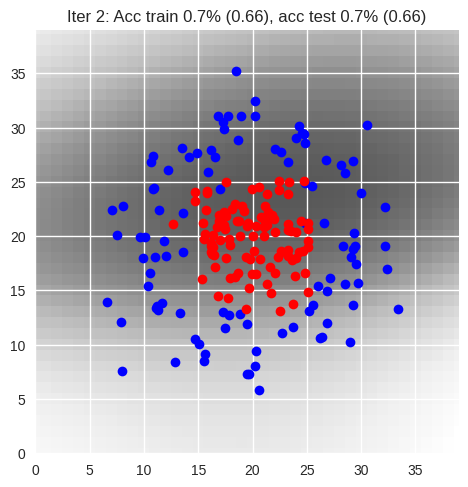

  3%|▎         | 3/100 [00:01<00:42,  2.30it/s]

torch.Size([200, 2])
Iter 3: Acc train 0.6% (0.64), acc test 0.6% (0.65)


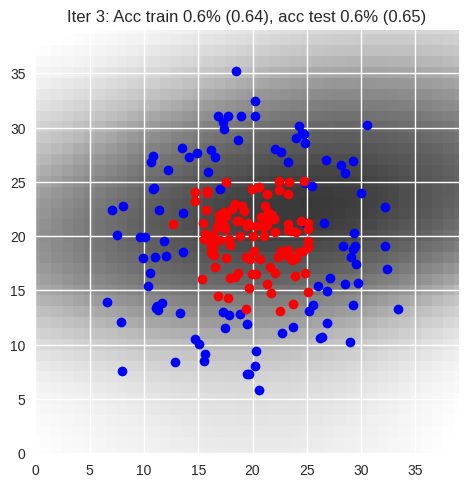

  4%|▍         | 4/100 [00:01<00:39,  2.44it/s]

torch.Size([200, 2])
Iter 4: Acc train 0.8% (0.62), acc test 0.8% (0.62)


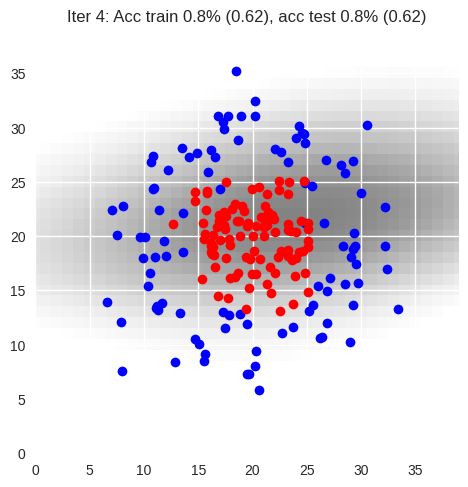

  5%|▌         | 5/100 [00:02<00:37,  2.52it/s]

torch.Size([200, 2])
Iter 5: Acc train 0.6% (0.60), acc test 0.6% (0.61)


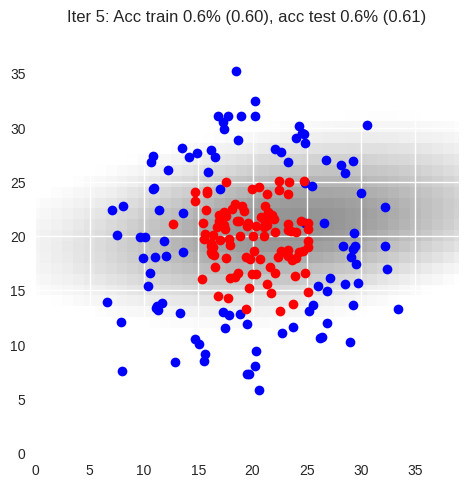

  6%|▌         | 6/100 [00:02<00:36,  2.61it/s]

torch.Size([200, 2])
Iter 6: Acc train 0.6% (0.64), acc test 0.6% (0.65)


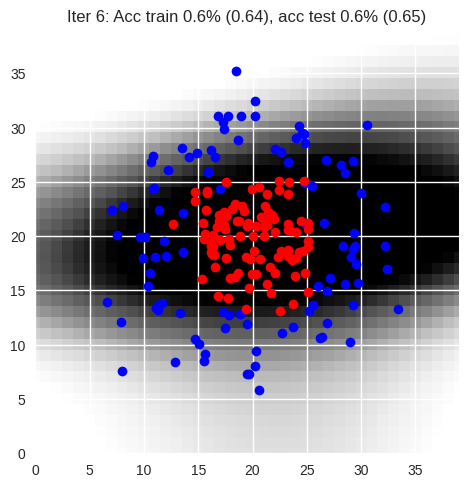

  7%|▋         | 7/100 [00:02<00:34,  2.70it/s]

torch.Size([200, 2])
Iter 7: Acc train 0.8% (0.53), acc test 0.8% (0.53)


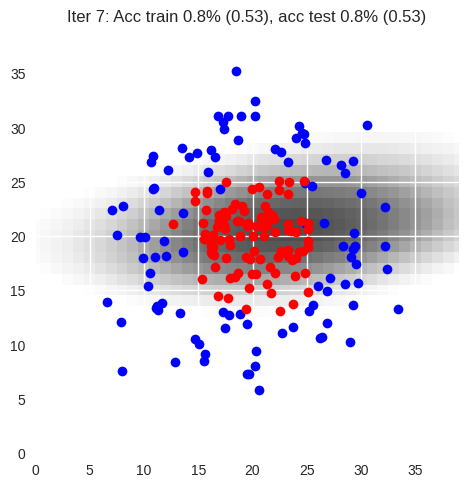

  8%|▊         | 8/100 [00:03<00:33,  2.71it/s]

torch.Size([200, 2])
Iter 8: Acc train 0.7% (0.56), acc test 0.7% (0.56)


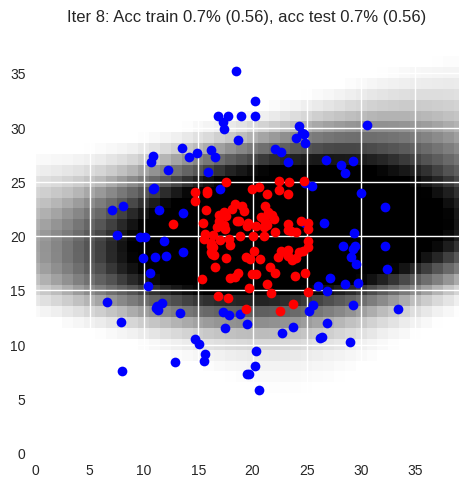

  9%|▉         | 9/100 [00:03<00:33,  2.75it/s]

torch.Size([200, 2])
Iter 9: Acc train 0.8% (0.46), acc test 0.9% (0.46)


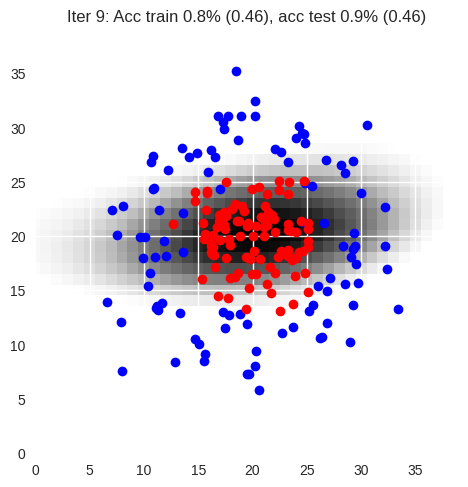

 10%|█         | 10/100 [00:03<00:32,  2.76it/s]

torch.Size([200, 2])
Iter 10: Acc train 0.9% (0.43), acc test 0.9% (0.43)


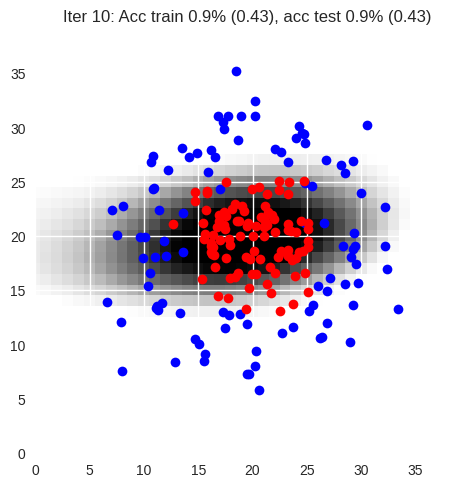

 11%|█         | 11/100 [00:04<00:32,  2.74it/s]

torch.Size([200, 2])
Iter 11: Acc train 0.9% (0.40), acc test 0.9% (0.40)


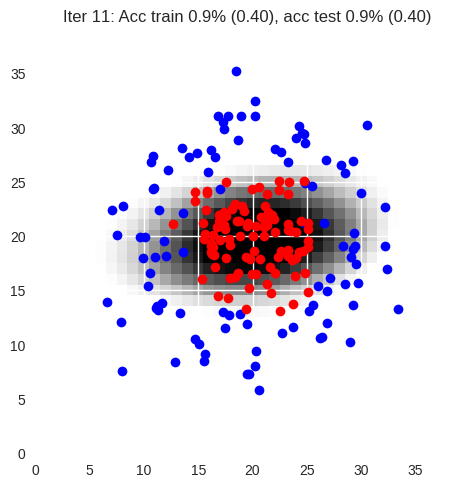

 12%|█▏        | 12/100 [00:04<00:31,  2.75it/s]

torch.Size([200, 2])
Iter 12: Acc train 0.9% (0.37), acc test 0.9% (0.37)


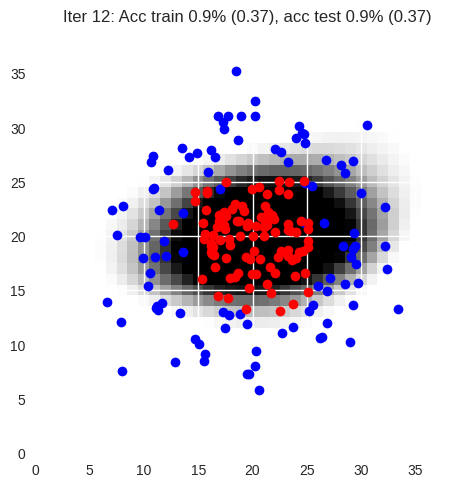

 13%|█▎        | 13/100 [00:04<00:31,  2.78it/s]

torch.Size([200, 2])
Iter 13: Acc train 0.9% (0.34), acc test 0.9% (0.34)


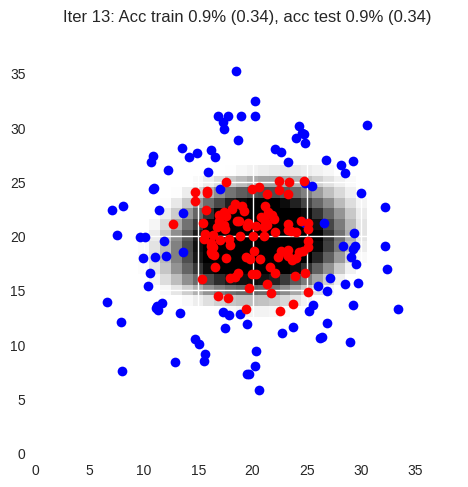

 14%|█▍        | 14/100 [00:05<00:31,  2.73it/s]

torch.Size([200, 2])
Iter 14: Acc train 0.9% (0.32), acc test 0.9% (0.33)


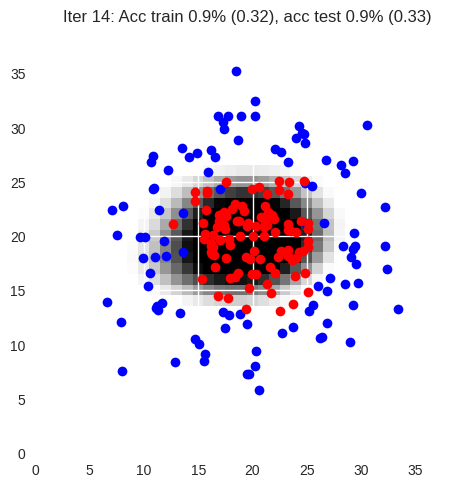

 15%|█▌        | 15/100 [00:05<00:34,  2.45it/s]

torch.Size([200, 2])
Iter 15: Acc train 0.9% (0.28), acc test 0.9% (0.28)


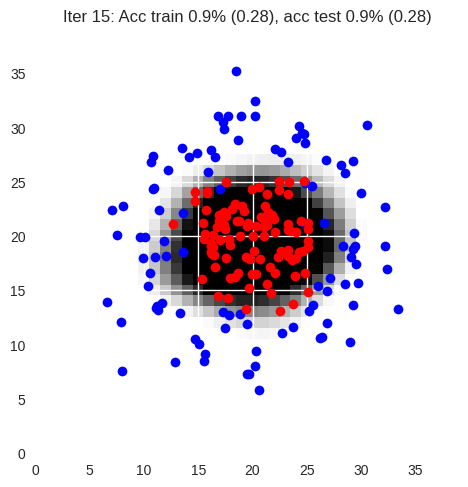

 16%|█▌        | 16/100 [00:06<00:37,  2.25it/s]

torch.Size([200, 2])
Iter 16: Acc train 0.9% (0.25), acc test 0.9% (0.26)


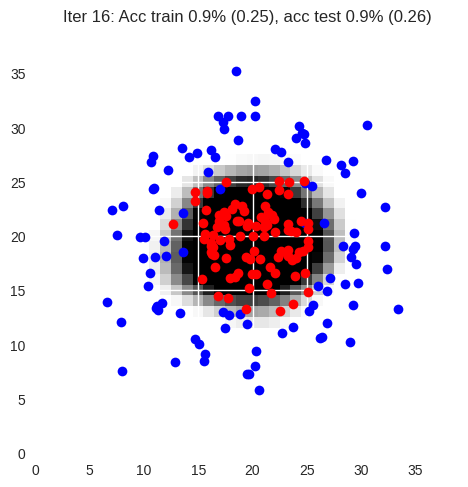

 17%|█▋        | 17/100 [00:06<00:37,  2.20it/s]

torch.Size([200, 2])
Iter 17: Acc train 0.9% (0.24), acc test 0.9% (0.25)


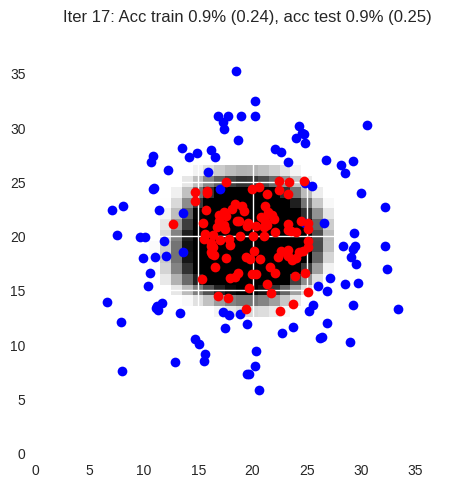

 18%|█▊        | 18/100 [00:07<00:39,  2.10it/s]

torch.Size([200, 2])
Iter 18: Acc train 1.0% (0.23), acc test 1.0% (0.23)


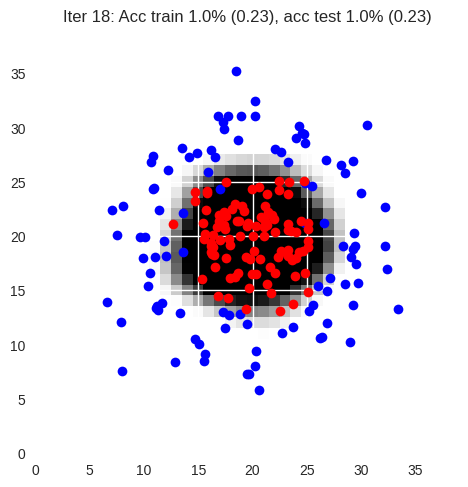

 19%|█▉        | 19/100 [00:07<00:39,  2.07it/s]

torch.Size([200, 2])
Iter 19: Acc train 0.9% (0.22), acc test 0.9% (0.23)


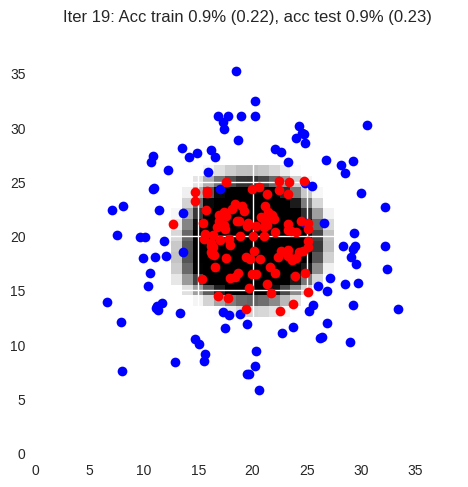

 20%|██        | 20/100 [00:08<00:39,  2.01it/s]

torch.Size([200, 2])
Iter 20: Acc train 0.9% (0.21), acc test 0.9% (0.22)


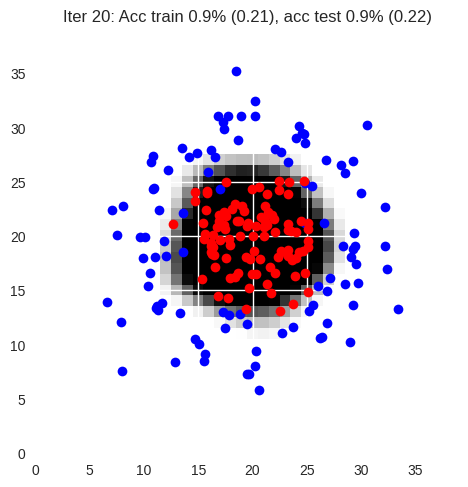

 21%|██        | 21/100 [00:08<00:36,  2.17it/s]

torch.Size([200, 2])
Iter 21: Acc train 1.0% (0.19), acc test 0.9% (0.21)


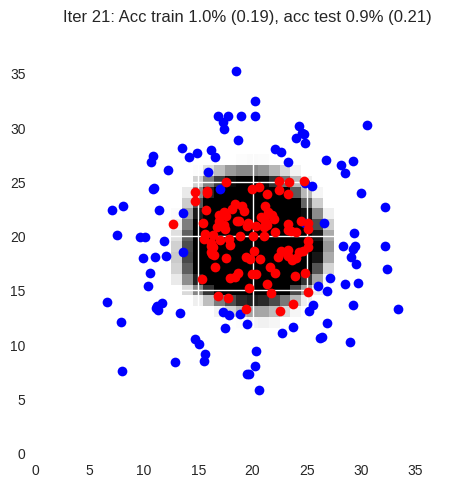

 22%|██▏       | 22/100 [00:09<00:33,  2.32it/s]

torch.Size([200, 2])
Iter 22: Acc train 1.0% (0.19), acc test 0.9% (0.20)


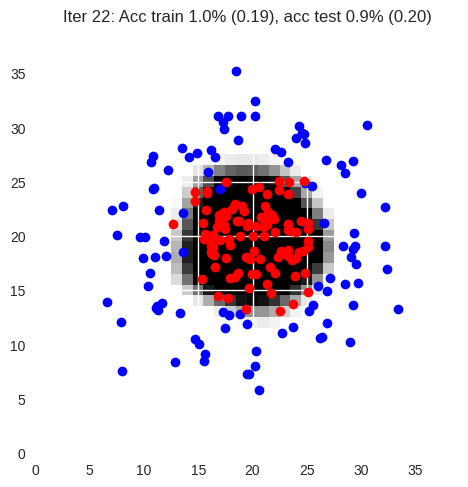

 23%|██▎       | 23/100 [00:09<00:32,  2.40it/s]

torch.Size([200, 2])
Iter 23: Acc train 0.9% (0.18), acc test 0.9% (0.20)


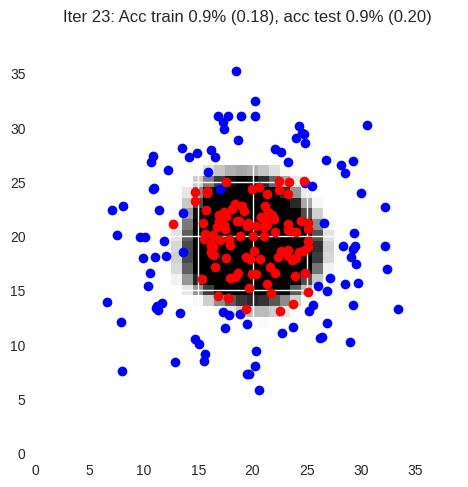

 24%|██▍       | 24/100 [00:09<00:30,  2.52it/s]

torch.Size([200, 2])
Iter 24: Acc train 1.0% (0.18), acc test 0.9% (0.19)


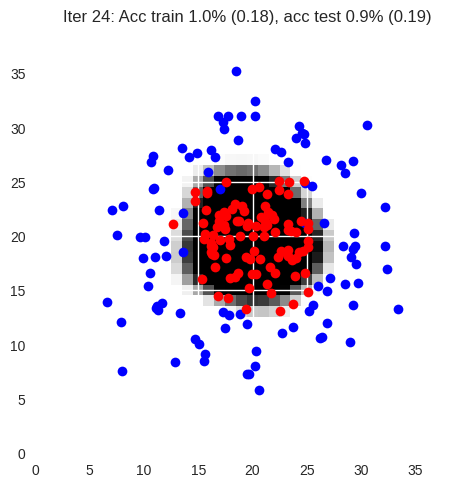

 25%|██▌       | 25/100 [00:10<00:29,  2.59it/s]

torch.Size([200, 2])
Iter 25: Acc train 1.0% (0.17), acc test 0.9% (0.18)


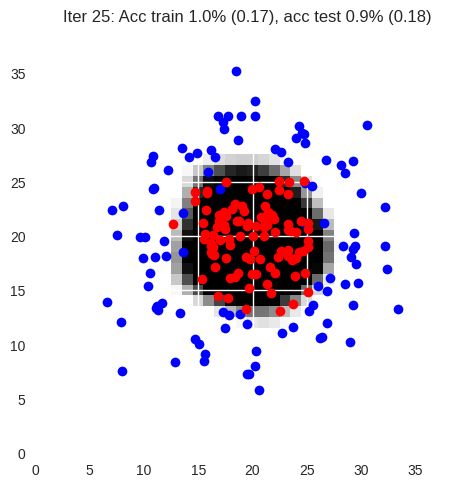

 26%|██▌       | 26/100 [00:10<00:28,  2.59it/s]

torch.Size([200, 2])
Iter 26: Acc train 1.0% (0.17), acc test 0.9% (0.18)


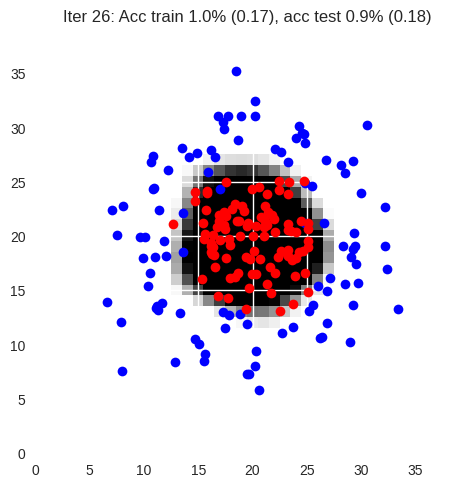

 27%|██▋       | 27/100 [00:10<00:27,  2.61it/s]

torch.Size([200, 2])
Iter 27: Acc train 0.9% (0.17), acc test 0.9% (0.18)


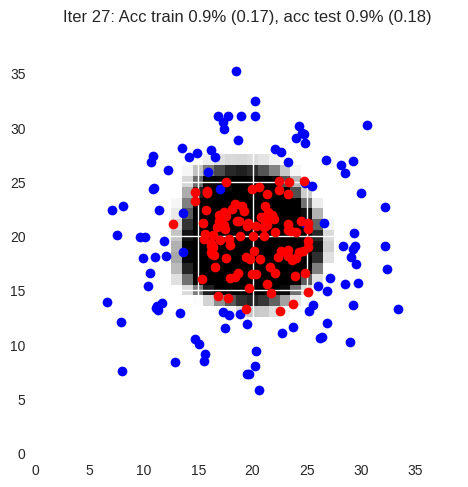

 28%|██▊       | 28/100 [00:11<00:27,  2.61it/s]

torch.Size([200, 2])
Iter 28: Acc train 1.0% (0.16), acc test 0.9% (0.17)


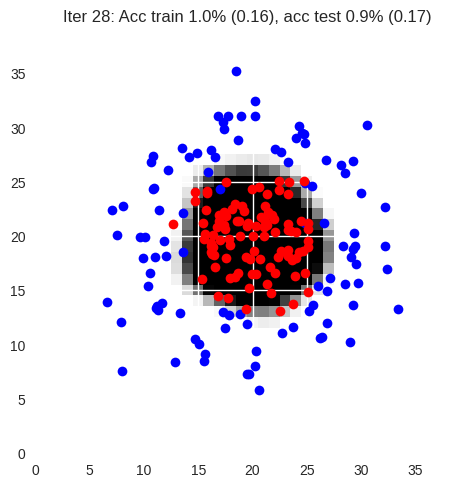

 29%|██▉       | 29/100 [00:11<00:27,  2.63it/s]

torch.Size([200, 2])
Iter 29: Acc train 1.0% (0.16), acc test 0.9% (0.17)


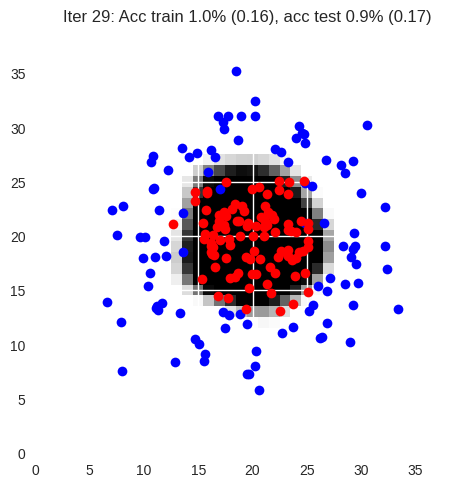

 30%|███       | 30/100 [00:12<00:26,  2.67it/s]

torch.Size([200, 2])
Iter 30: Acc train 1.0% (0.15), acc test 0.9% (0.17)


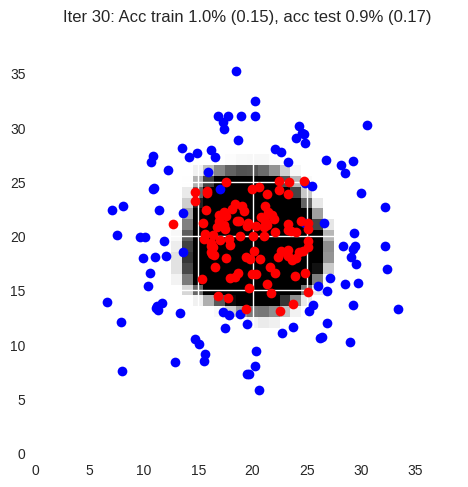

 31%|███       | 31/100 [00:12<00:25,  2.66it/s]

torch.Size([200, 2])
Iter 31: Acc train 1.0% (0.15), acc test 0.9% (0.17)


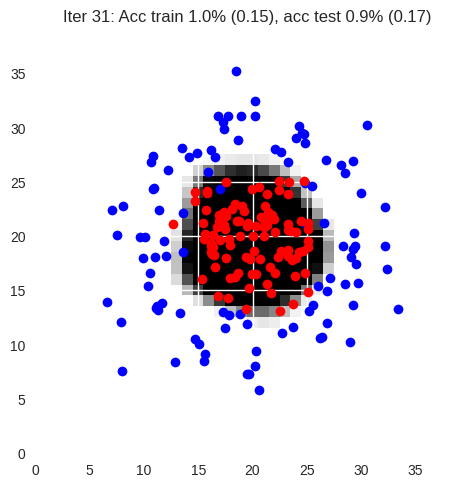

 32%|███▏      | 32/100 [00:12<00:25,  2.68it/s]

torch.Size([200, 2])
Iter 32: Acc train 1.0% (0.15), acc test 0.9% (0.17)


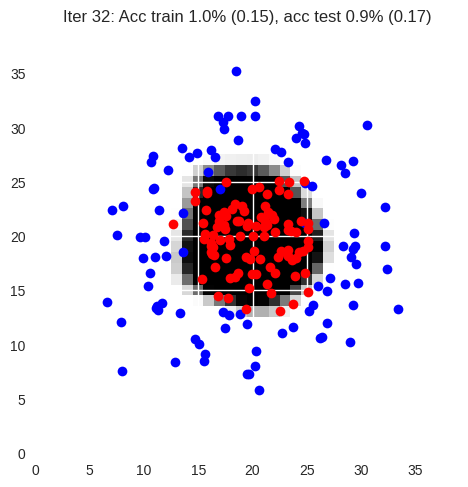

 33%|███▎      | 33/100 [00:13<00:24,  2.71it/s]

torch.Size([200, 2])
Iter 33: Acc train 1.0% (0.15), acc test 0.9% (0.17)


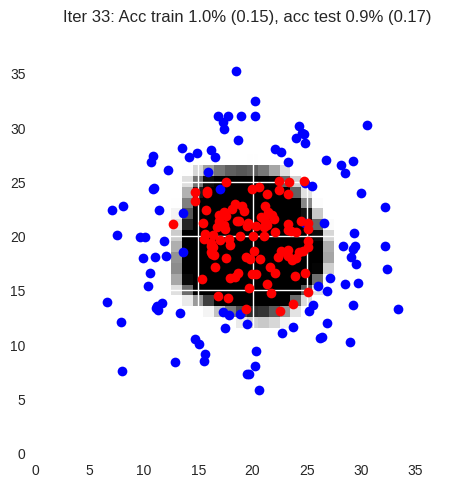

 34%|███▍      | 34/100 [00:13<00:24,  2.70it/s]

torch.Size([200, 2])
Iter 34: Acc train 1.0% (0.14), acc test 0.9% (0.17)


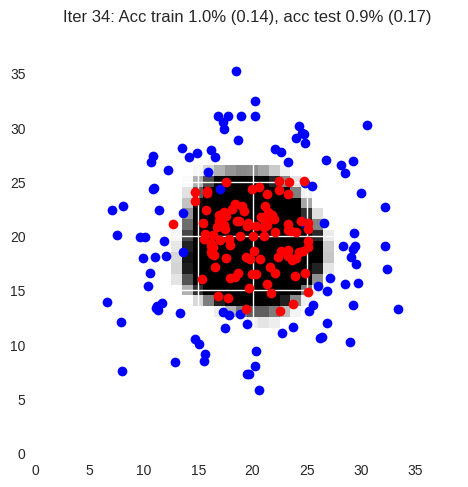

 35%|███▌      | 35/100 [00:13<00:23,  2.73it/s]

torch.Size([200, 2])
Iter 35: Acc train 1.0% (0.14), acc test 0.9% (0.16)


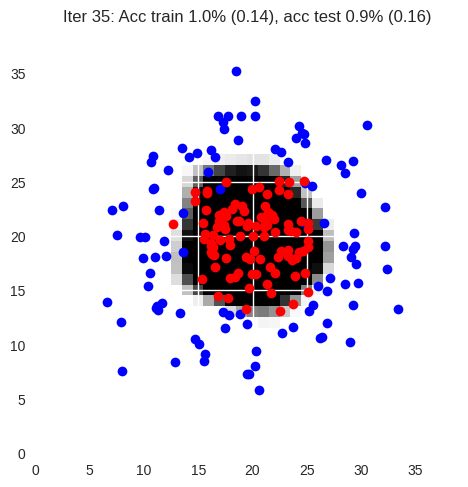

 36%|███▌      | 36/100 [00:14<00:28,  2.27it/s]

torch.Size([200, 2])
Iter 36: Acc train 1.0% (0.14), acc test 0.9% (0.17)


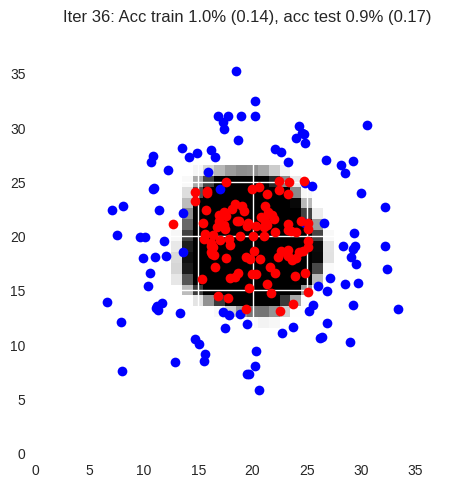

 37%|███▋      | 37/100 [00:14<00:26,  2.41it/s]

torch.Size([200, 2])
Iter 37: Acc train 1.0% (0.14), acc test 0.9% (0.17)


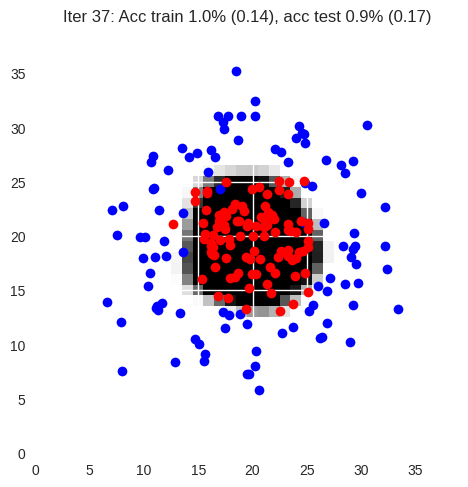

 38%|███▊      | 38/100 [00:15<00:24,  2.50it/s]

torch.Size([200, 2])
Iter 38: Acc train 1.0% (0.14), acc test 0.9% (0.16)


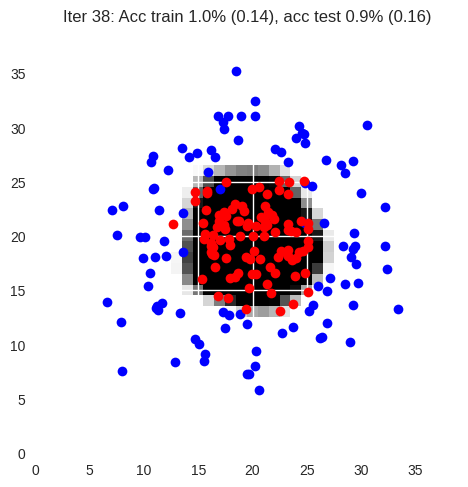

 39%|███▉      | 39/100 [00:15<00:23,  2.56it/s]

torch.Size([200, 2])
Iter 39: Acc train 0.9% (0.14), acc test 1.0% (0.18)


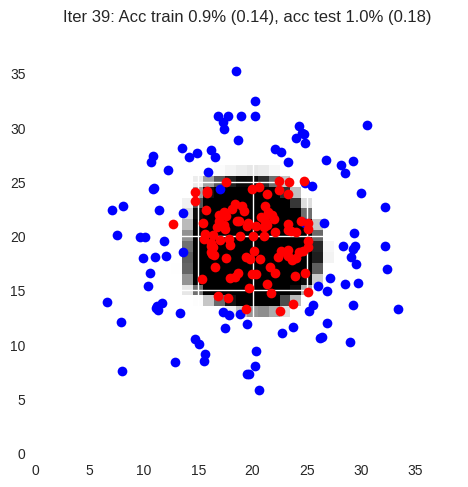

 40%|████      | 40/100 [00:16<00:23,  2.60it/s]

torch.Size([200, 2])
Iter 40: Acc train 1.0% (0.14), acc test 0.9% (0.15)


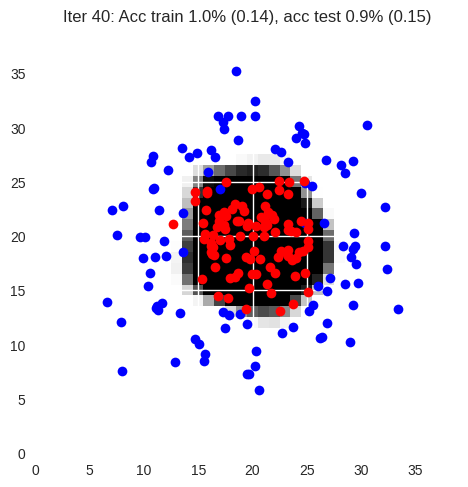

 41%|████      | 41/100 [00:16<00:22,  2.65it/s]

torch.Size([200, 2])
Iter 41: Acc train 1.0% (0.13), acc test 0.9% (0.15)


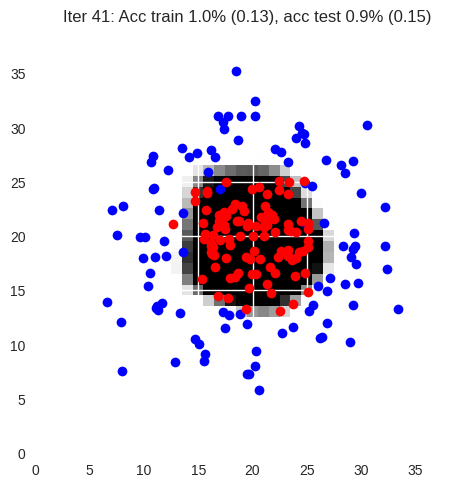

 42%|████▏     | 42/100 [00:16<00:21,  2.67it/s]

torch.Size([200, 2])
Iter 42: Acc train 1.0% (0.13), acc test 0.9% (0.16)


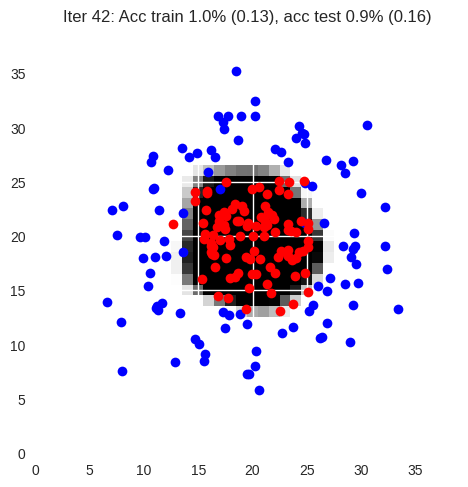

 43%|████▎     | 43/100 [00:17<00:21,  2.71it/s]

torch.Size([200, 2])
Iter 43: Acc train 1.0% (0.14), acc test 1.0% (0.16)


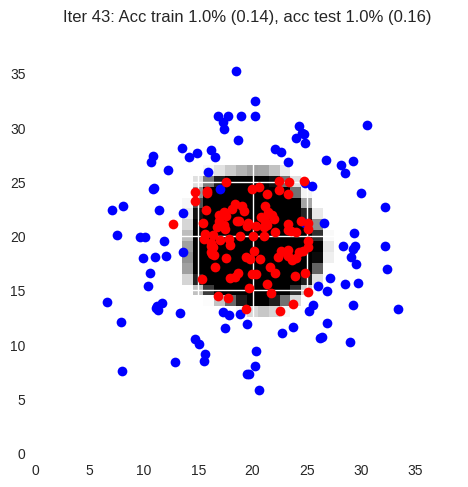

 44%|████▍     | 44/100 [00:17<00:20,  2.74it/s]

torch.Size([200, 2])
Iter 44: Acc train 1.0% (0.13), acc test 0.9% (0.16)


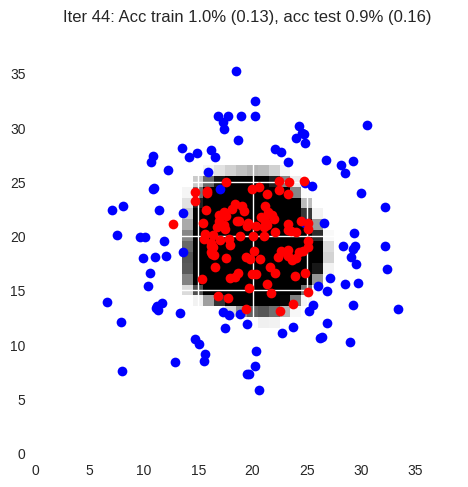

 45%|████▌     | 45/100 [00:17<00:20,  2.70it/s]

torch.Size([200, 2])
Iter 45: Acc train 1.0% (0.13), acc test 0.9% (0.16)


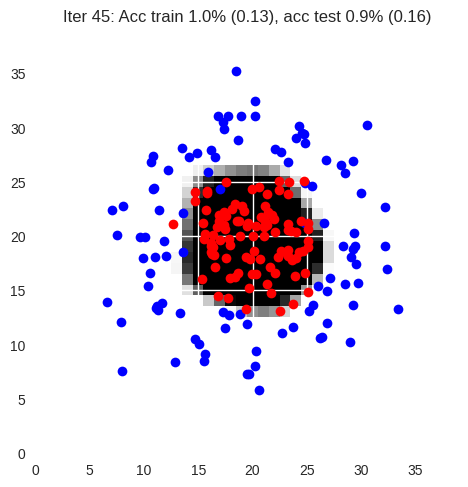

 46%|████▌     | 46/100 [00:18<00:19,  2.71it/s]

torch.Size([200, 2])
Iter 46: Acc train 1.0% (0.13), acc test 0.9% (0.16)


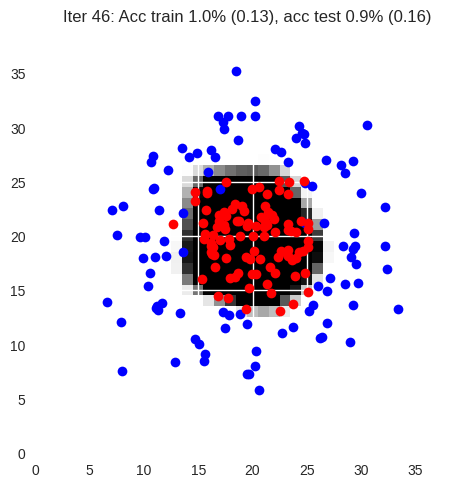

 47%|████▋     | 47/100 [00:18<00:20,  2.57it/s]

torch.Size([200, 2])
Iter 47: Acc train 1.0% (0.13), acc test 0.9% (0.15)


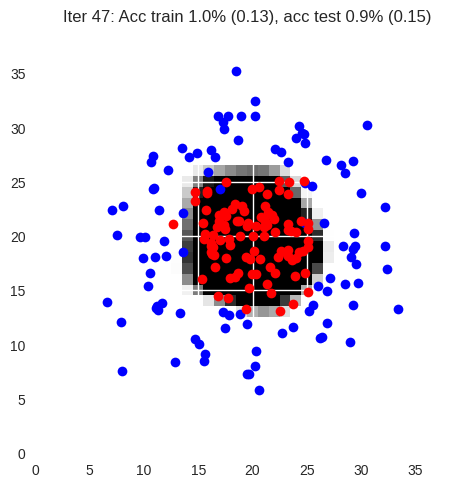

 48%|████▊     | 48/100 [00:19<00:22,  2.34it/s]

torch.Size([200, 2])
Iter 48: Acc train 1.0% (0.12), acc test 0.9% (0.16)


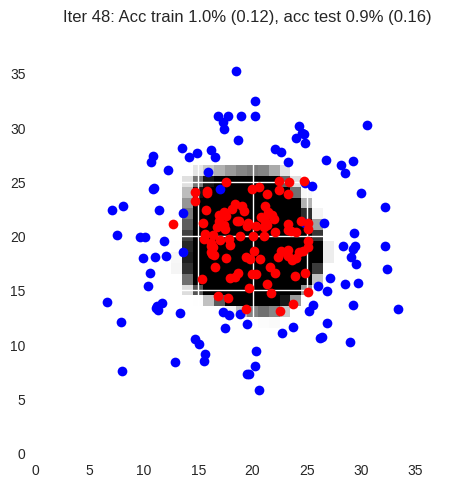

 49%|████▉     | 49/100 [00:19<00:23,  2.16it/s]

torch.Size([200, 2])
Iter 49: Acc train 1.0% (0.13), acc test 1.0% (0.17)


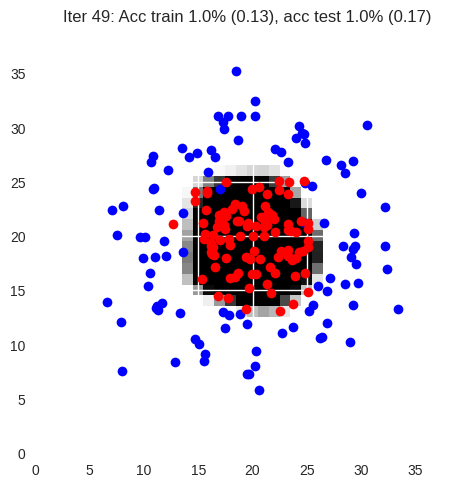

 50%|█████     | 50/100 [00:20<00:24,  2.07it/s]

torch.Size([200, 2])
Iter 50: Acc train 1.0% (0.12), acc test 0.9% (0.16)


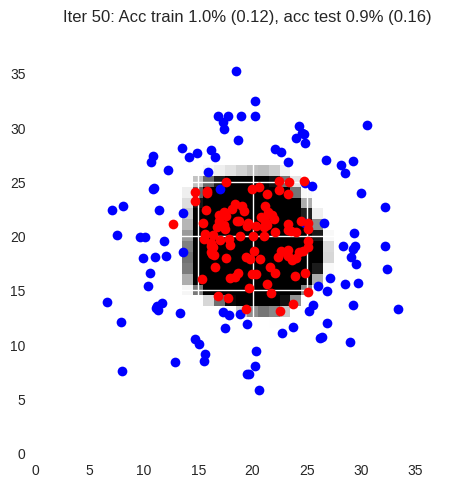

 51%|█████     | 51/100 [00:20<00:24,  1.98it/s]

torch.Size([200, 2])
Iter 51: Acc train 1.0% (0.13), acc test 0.9% (0.14)


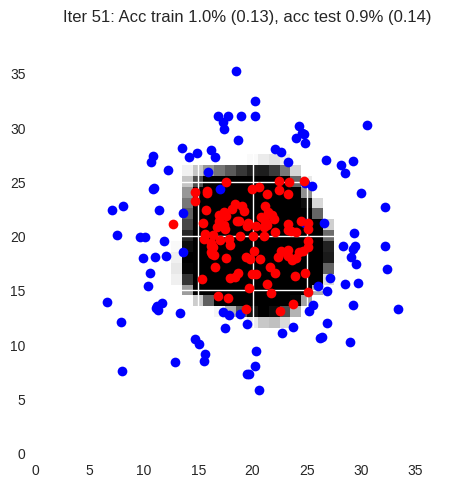

 52%|█████▏    | 52/100 [00:21<00:24,  1.99it/s]

torch.Size([200, 2])
Iter 52: Acc train 1.0% (0.12), acc test 0.9% (0.15)


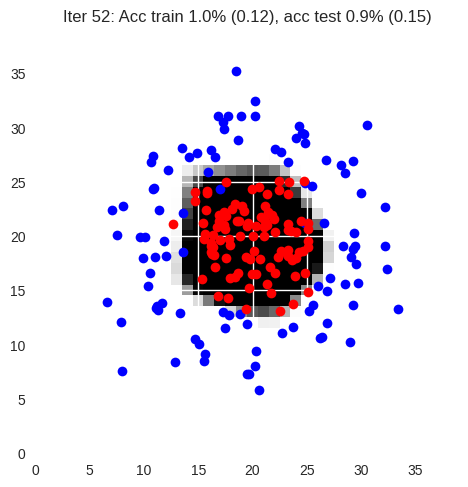

 53%|█████▎    | 53/100 [00:21<00:24,  1.94it/s]

torch.Size([200, 2])
Iter 53: Acc train 1.0% (0.12), acc test 0.9% (0.14)


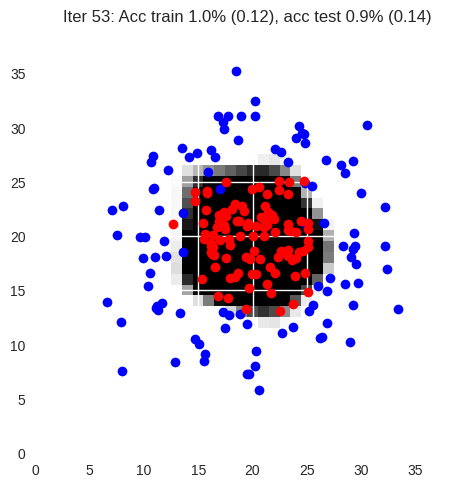

 54%|█████▍    | 54/100 [00:22<00:21,  2.11it/s]

torch.Size([200, 2])
Iter 54: Acc train 1.0% (0.13), acc test 1.0% (0.18)


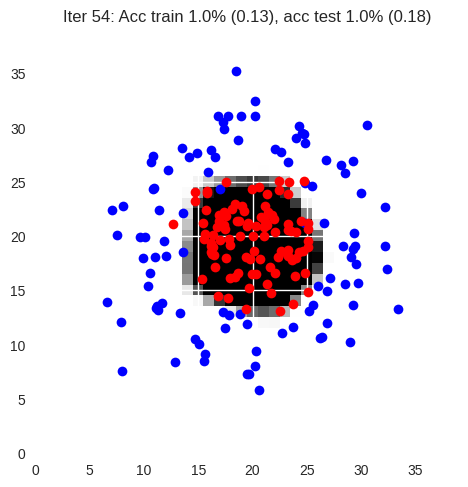

 55%|█████▌    | 55/100 [00:22<00:20,  2.22it/s]

torch.Size([200, 2])
Iter 55: Acc train 1.0% (0.12), acc test 0.9% (0.16)


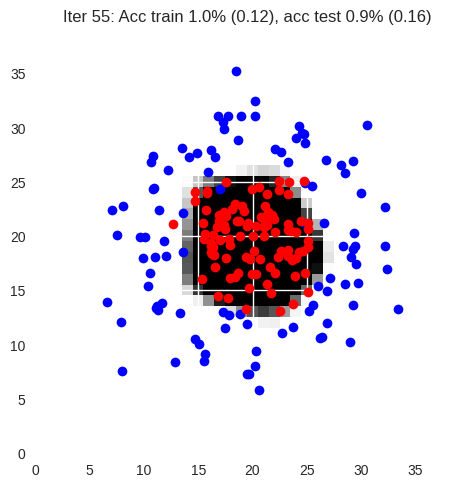

 56%|█████▌    | 56/100 [00:23<00:19,  2.29it/s]

torch.Size([200, 2])
Iter 56: Acc train 1.0% (0.12), acc test 1.0% (0.16)


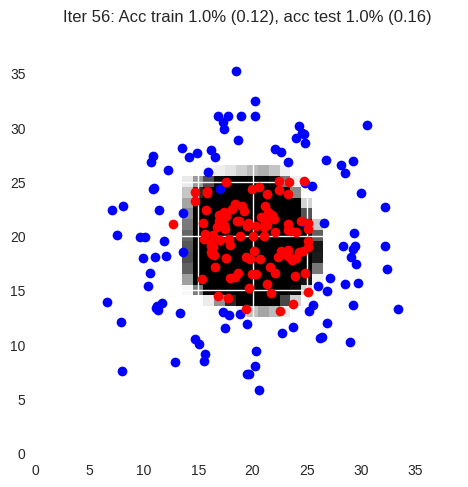

 57%|█████▋    | 57/100 [00:23<00:18,  2.37it/s]

torch.Size([200, 2])
Iter 57: Acc train 1.0% (0.12), acc test 0.9% (0.15)


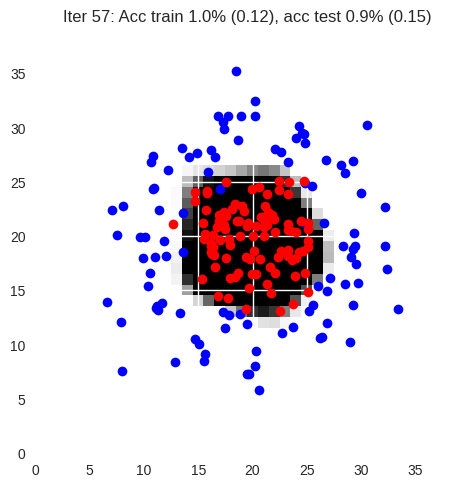

 58%|█████▊    | 58/100 [00:23<00:17,  2.40it/s]

torch.Size([200, 2])
Iter 58: Acc train 1.0% (0.12), acc test 0.9% (0.14)


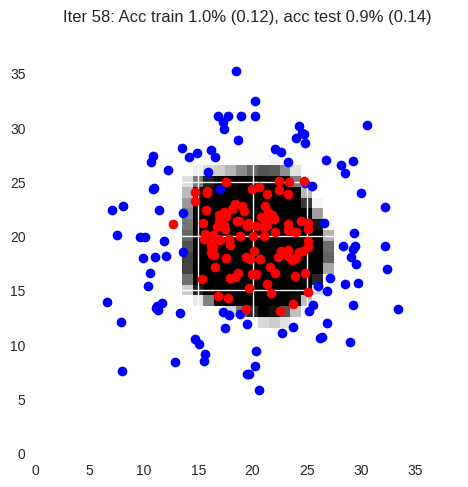

 59%|█████▉    | 59/100 [00:24<00:16,  2.42it/s]

torch.Size([200, 2])
Iter 59: Acc train 1.0% (0.13), acc test 0.9% (0.15)


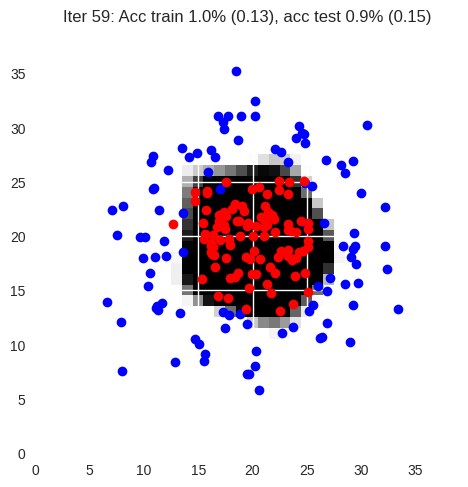

 60%|██████    | 60/100 [00:24<00:16,  2.46it/s]

torch.Size([200, 2])
Iter 60: Acc train 1.0% (0.12), acc test 0.9% (0.15)


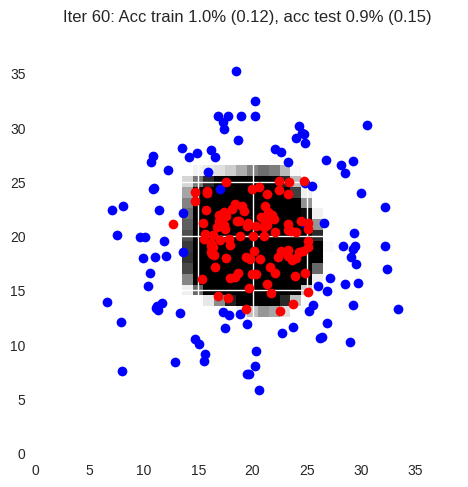

 61%|██████    | 61/100 [00:24<00:15,  2.54it/s]

torch.Size([200, 2])
Iter 61: Acc train 1.0% (0.11), acc test 0.9% (0.14)


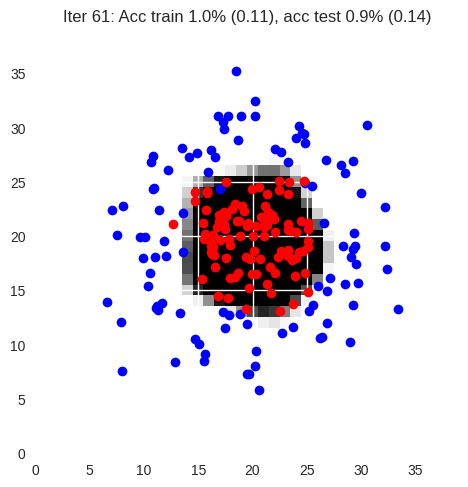

 62%|██████▏   | 62/100 [00:25<00:14,  2.56it/s]

torch.Size([200, 2])
Iter 62: Acc train 1.0% (0.12), acc test 0.9% (0.17)


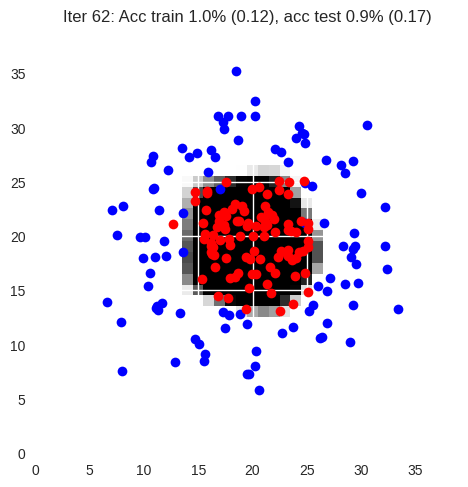

 63%|██████▎   | 63/100 [00:25<00:14,  2.60it/s]

torch.Size([200, 2])
Iter 63: Acc train 0.9% (0.14), acc test 0.9% (0.19)


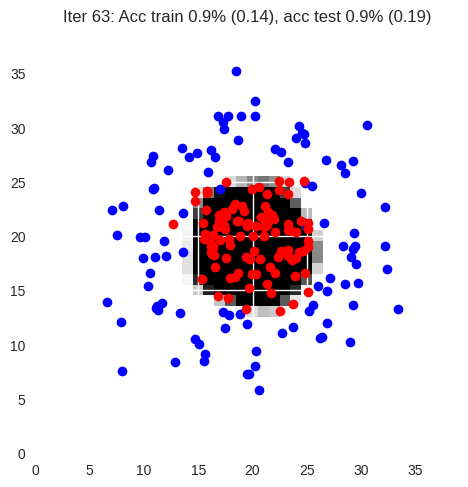

 64%|██████▍   | 64/100 [00:26<00:13,  2.60it/s]

torch.Size([200, 2])
Iter 64: Acc train 1.0% (0.11), acc test 0.9% (0.14)


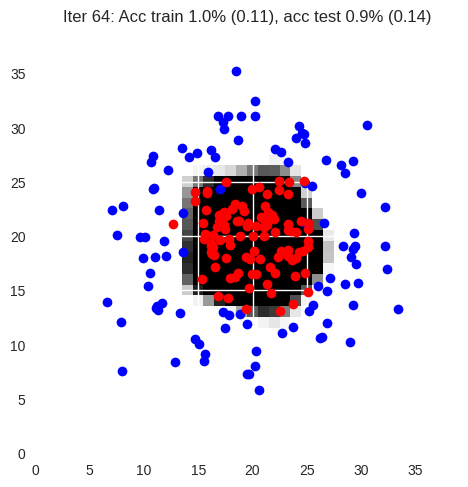

 65%|██████▌   | 65/100 [00:26<00:13,  2.61it/s]

torch.Size([200, 2])
Iter 65: Acc train 1.0% (0.12), acc test 1.0% (0.17)


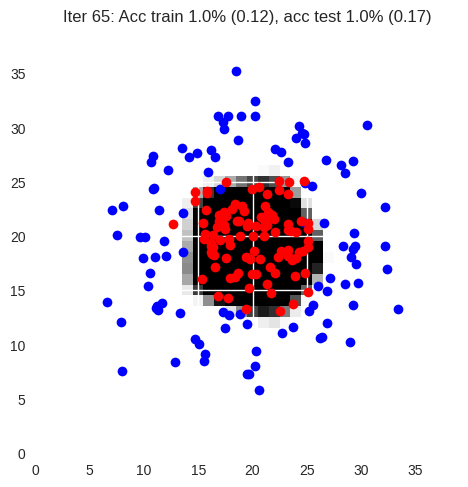

 66%|██████▌   | 66/100 [00:26<00:12,  2.66it/s]

torch.Size([200, 2])
Iter 66: Acc train 1.0% (0.11), acc test 0.9% (0.15)


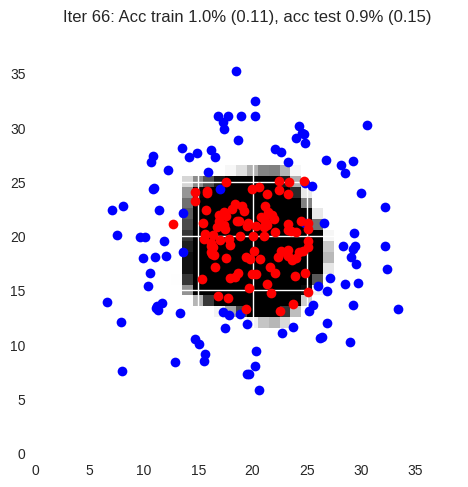

 67%|██████▋   | 67/100 [00:27<00:12,  2.65it/s]

torch.Size([200, 2])
Iter 67: Acc train 1.0% (0.11), acc test 0.9% (0.14)


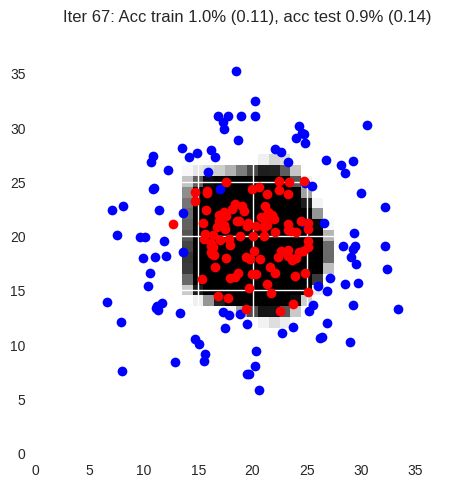

 68%|██████▊   | 68/100 [00:27<00:12,  2.65it/s]

torch.Size([200, 2])
Iter 68: Acc train 1.0% (0.12), acc test 0.9% (0.14)


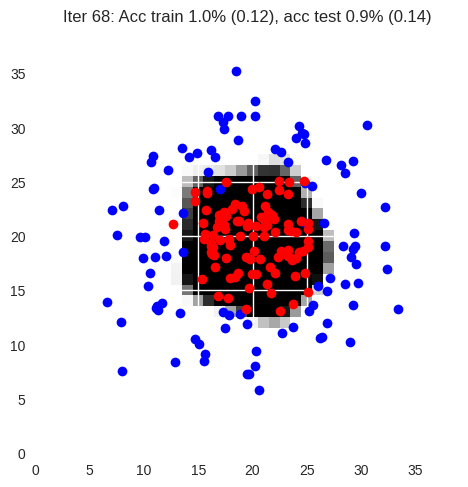

 69%|██████▉   | 69/100 [00:27<00:11,  2.63it/s]

torch.Size([200, 2])
Iter 69: Acc train 1.0% (0.11), acc test 0.9% (0.15)


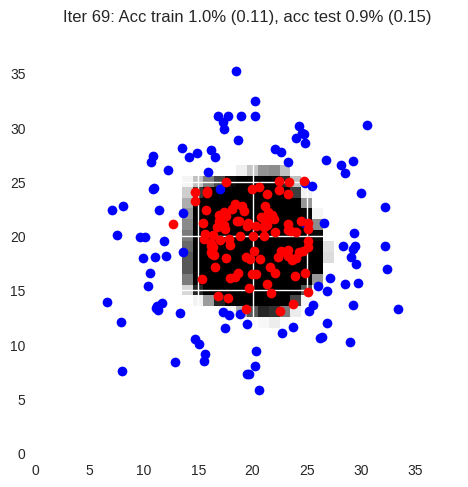

 70%|███████   | 70/100 [00:28<00:11,  2.58it/s]

torch.Size([200, 2])
Iter 70: Acc train 1.0% (0.11), acc test 0.9% (0.15)


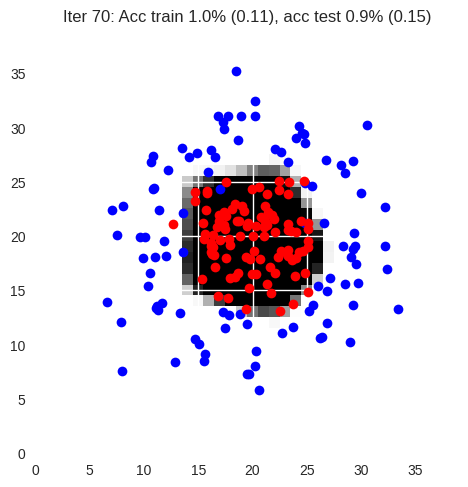

 71%|███████   | 71/100 [00:29<00:13,  2.07it/s]

torch.Size([200, 2])
Iter 71: Acc train 1.0% (0.11), acc test 0.9% (0.17)


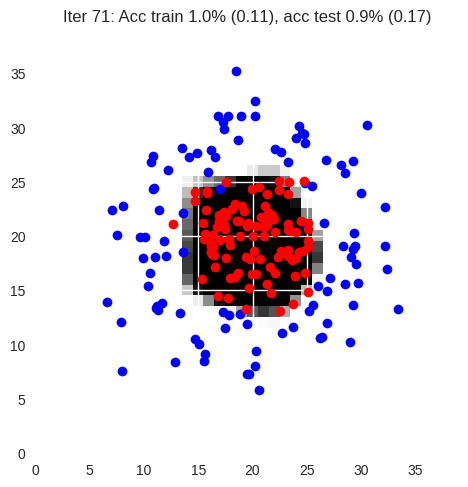

 72%|███████▏  | 72/100 [00:29<00:12,  2.18it/s]

torch.Size([200, 2])
Iter 72: Acc train 1.0% (0.11), acc test 1.0% (0.16)


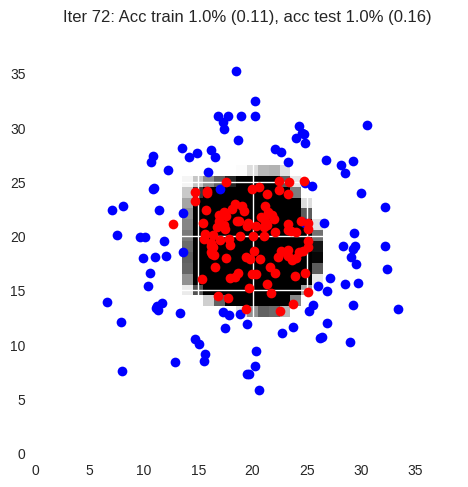

 73%|███████▎  | 73/100 [00:29<00:11,  2.27it/s]

torch.Size([200, 2])
Iter 73: Acc train 1.0% (0.12), acc test 0.9% (0.17)


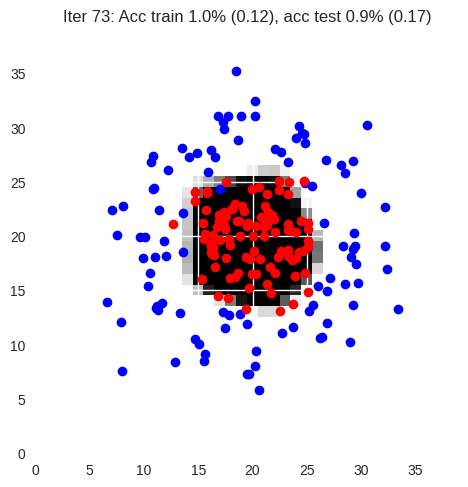

 74%|███████▍  | 74/100 [00:30<00:11,  2.31it/s]

torch.Size([200, 2])
Iter 74: Acc train 1.0% (0.11), acc test 0.9% (0.15)


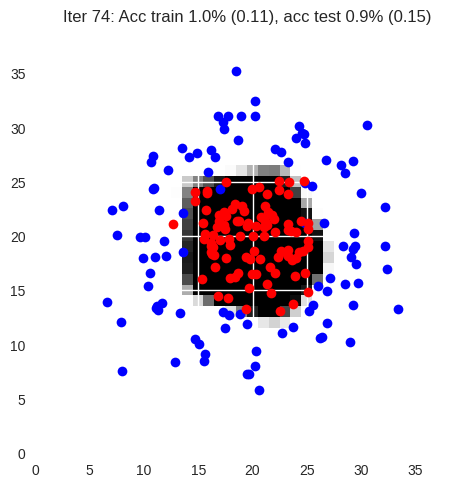

 75%|███████▌  | 75/100 [00:30<00:10,  2.37it/s]

torch.Size([200, 2])
Iter 75: Acc train 1.0% (0.11), acc test 0.9% (0.15)


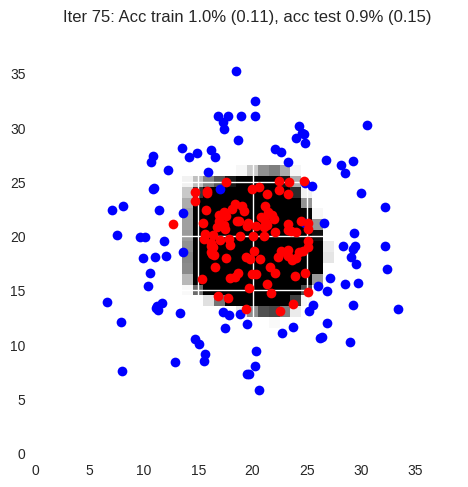

 76%|███████▌  | 76/100 [00:31<00:09,  2.43it/s]

torch.Size([200, 2])
Iter 76: Acc train 1.0% (0.11), acc test 0.9% (0.17)


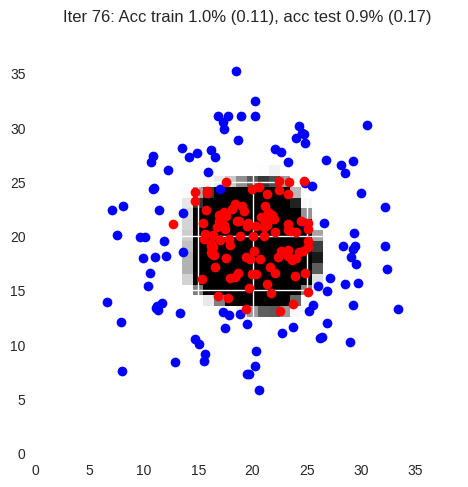

 77%|███████▋  | 77/100 [00:31<00:09,  2.47it/s]

torch.Size([200, 2])
Iter 77: Acc train 1.0% (0.11), acc test 0.9% (0.17)


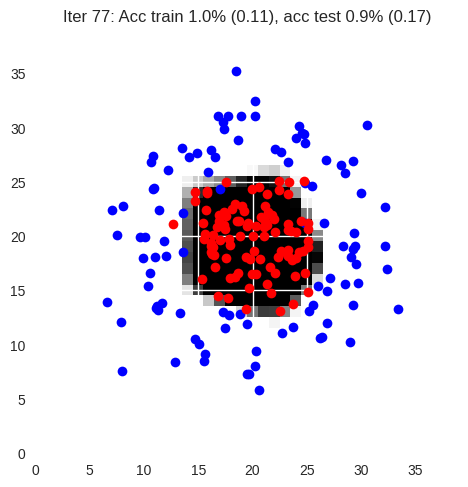

 78%|███████▊  | 78/100 [00:31<00:09,  2.38it/s]

torch.Size([200, 2])
Iter 78: Acc train 1.0% (0.12), acc test 0.9% (0.15)


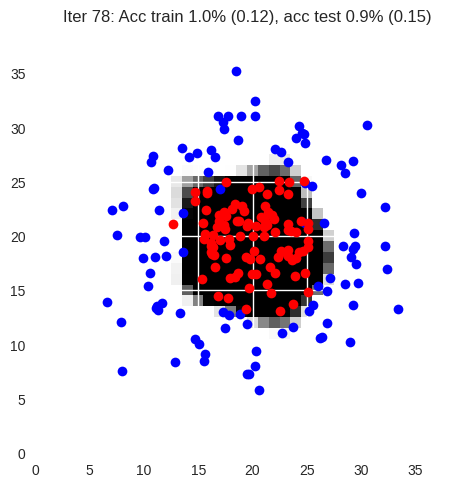

 79%|███████▉  | 79/100 [00:32<00:09,  2.19it/s]

torch.Size([200, 2])
Iter 79: Acc train 1.0% (0.11), acc test 0.9% (0.16)


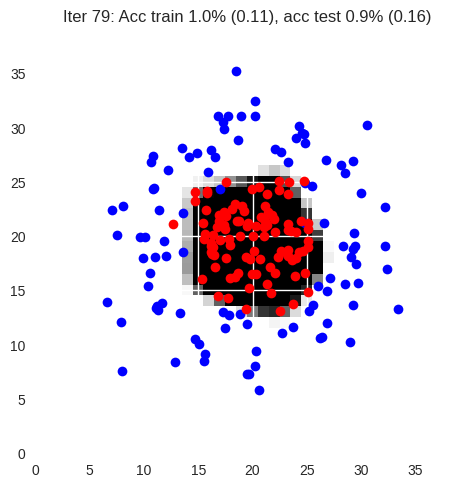

 80%|████████  | 80/100 [00:33<00:09,  2.01it/s]

torch.Size([200, 2])
Iter 80: Acc train 1.0% (0.10), acc test 0.9% (0.16)


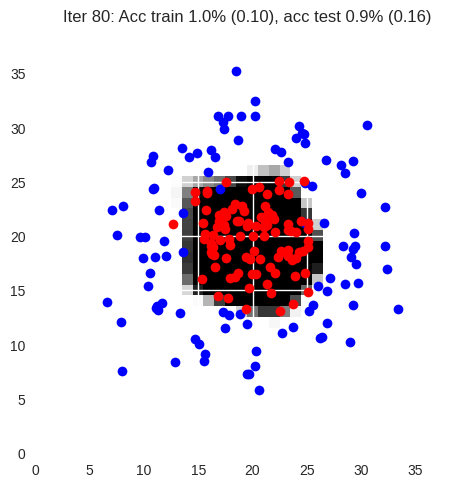

 81%|████████  | 81/100 [00:33<00:09,  1.94it/s]

torch.Size([200, 2])
Iter 81: Acc train 1.0% (0.11), acc test 0.9% (0.17)


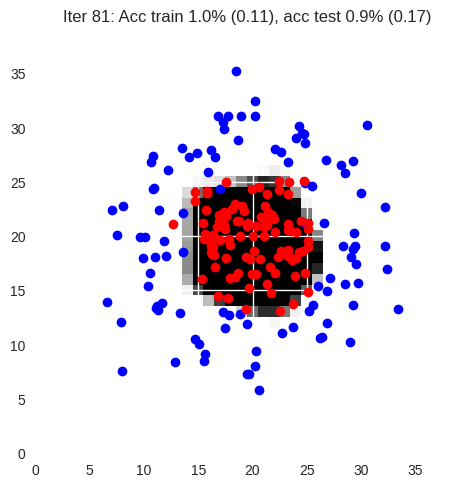

 82%|████████▏ | 82/100 [00:34<00:09,  1.90it/s]

torch.Size([200, 2])
Iter 82: Acc train 1.0% (0.11), acc test 0.9% (0.14)


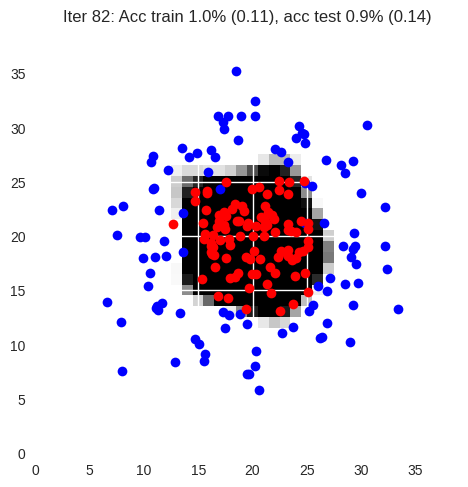

 83%|████████▎ | 83/100 [00:34<00:09,  1.86it/s]

torch.Size([200, 2])
Iter 83: Acc train 1.0% (0.10), acc test 1.0% (0.16)


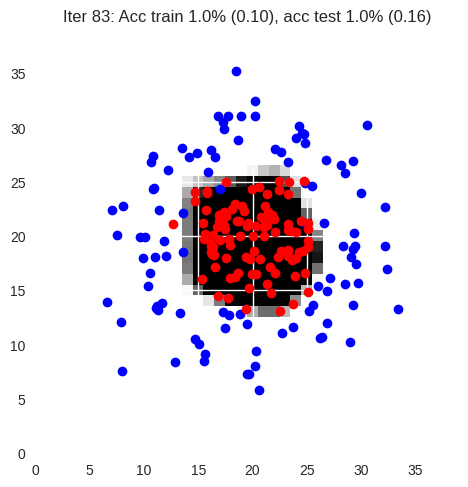

 84%|████████▍ | 84/100 [00:35<00:08,  1.86it/s]

torch.Size([200, 2])
Iter 84: Acc train 1.0% (0.10), acc test 0.9% (0.15)


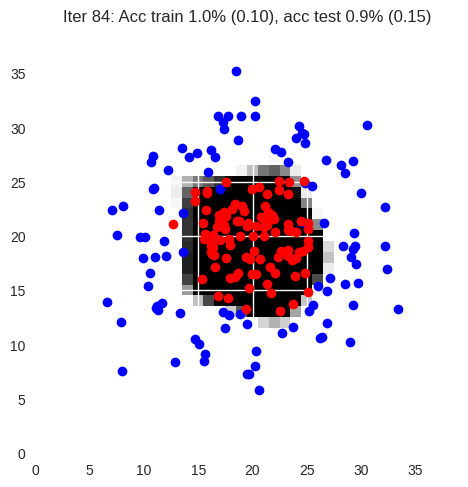

 85%|████████▌ | 85/100 [00:35<00:07,  1.97it/s]

torch.Size([200, 2])
Iter 85: Acc train 1.0% (0.10), acc test 0.9% (0.16)


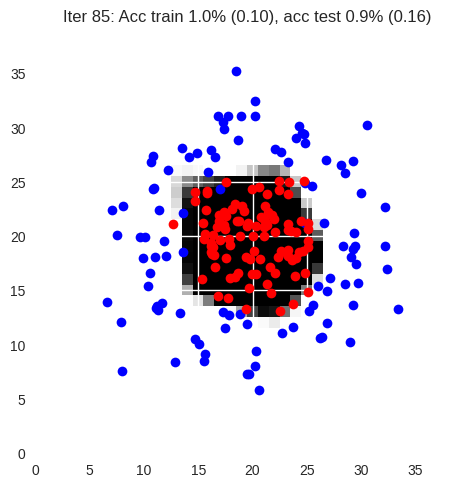

 86%|████████▌ | 86/100 [00:36<00:06,  2.13it/s]

torch.Size([200, 2])
Iter 86: Acc train 1.0% (0.11), acc test 0.9% (0.17)


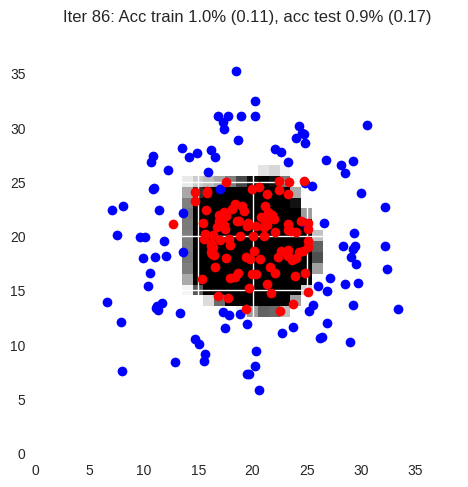

 87%|████████▋ | 87/100 [00:36<00:05,  2.22it/s]

torch.Size([200, 2])
Iter 87: Acc train 1.0% (0.10), acc test 1.0% (0.14)


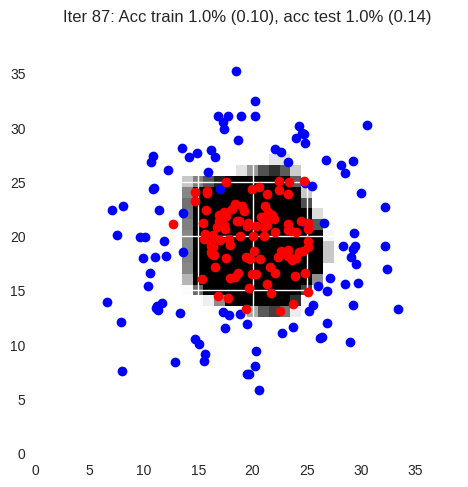

 88%|████████▊ | 88/100 [00:36<00:05,  2.35it/s]

torch.Size([200, 2])
Iter 88: Acc train 1.0% (0.10), acc test 1.0% (0.15)


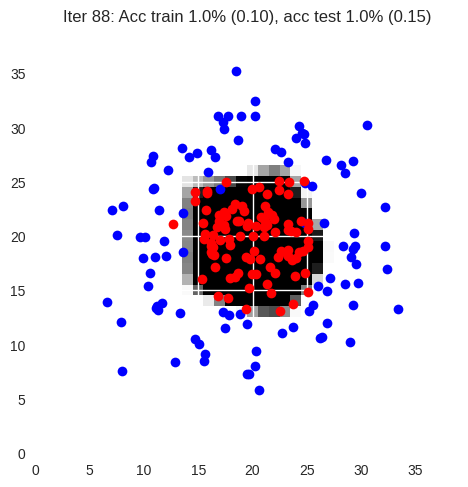

 89%|████████▉ | 89/100 [00:37<00:04,  2.43it/s]

torch.Size([200, 2])
Iter 89: Acc train 1.0% (0.10), acc test 0.9% (0.14)


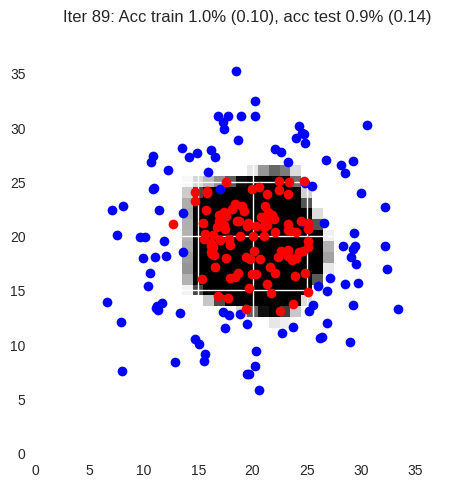

 90%|█████████ | 90/100 [00:37<00:04,  2.45it/s]

torch.Size([200, 2])
Iter 90: Acc train 1.0% (0.10), acc test 1.0% (0.15)


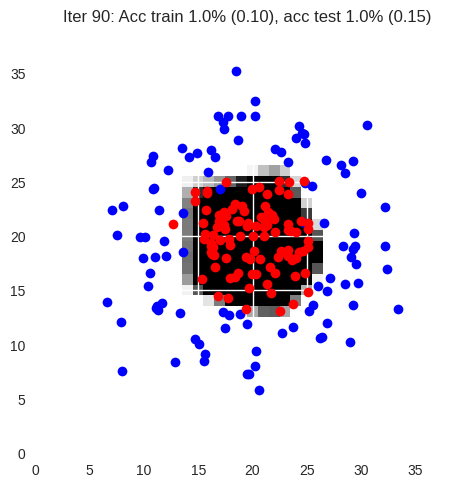

 91%|█████████ | 91/100 [00:38<00:03,  2.44it/s]

torch.Size([200, 2])
Iter 91: Acc train 1.0% (0.10), acc test 0.9% (0.14)


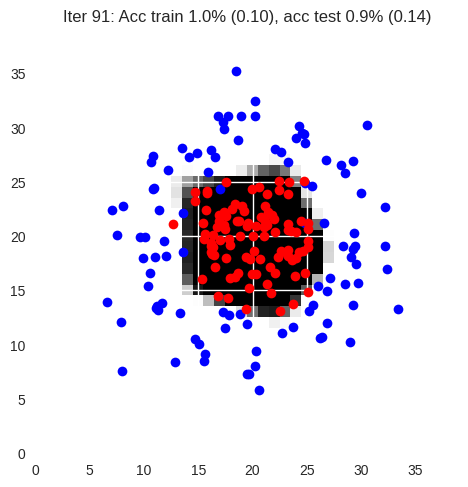

 92%|█████████▏| 92/100 [00:38<00:03,  2.46it/s]

torch.Size([200, 2])
Iter 92: Acc train 1.0% (0.10), acc test 0.9% (0.15)


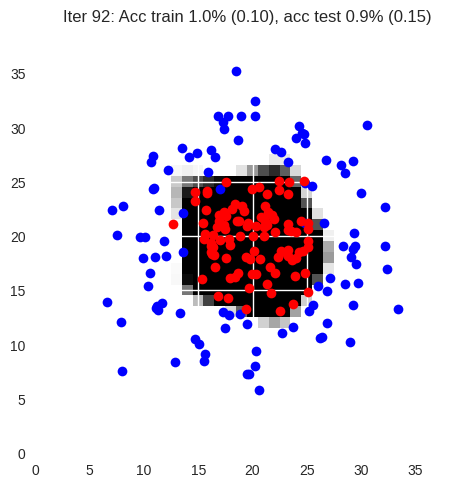

 93%|█████████▎| 93/100 [00:38<00:02,  2.46it/s]

torch.Size([200, 2])
Iter 93: Acc train 1.0% (0.10), acc test 1.0% (0.17)


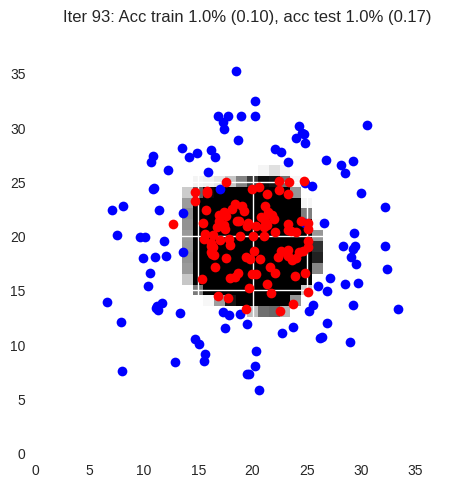

 94%|█████████▍| 94/100 [00:39<00:02,  2.49it/s]

torch.Size([200, 2])
Iter 94: Acc train 1.0% (0.11), acc test 0.9% (0.14)


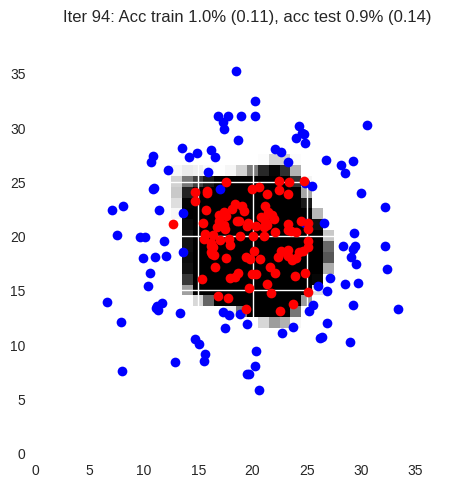

 95%|█████████▌| 95/100 [00:39<00:02,  2.46it/s]

torch.Size([200, 2])
Iter 95: Acc train 1.0% (0.10), acc test 0.9% (0.16)


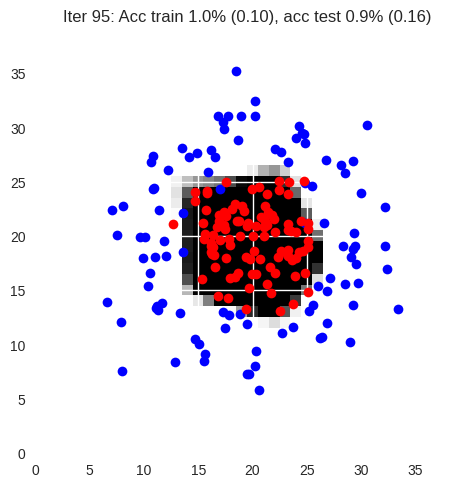

 96%|█████████▌| 96/100 [00:40<00:01,  2.45it/s]

torch.Size([200, 2])
Iter 96: Acc train 1.0% (0.10), acc test 0.9% (0.16)


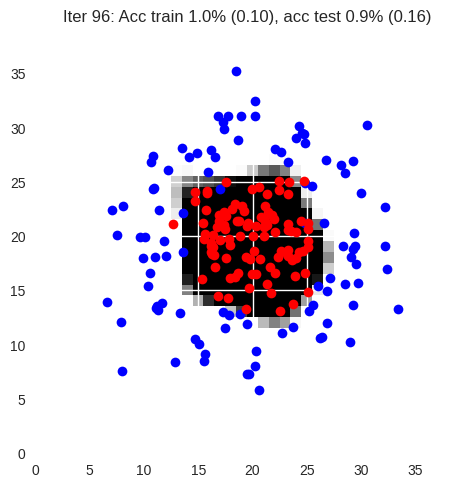

 97%|█████████▋| 97/100 [00:40<00:01,  2.44it/s]

torch.Size([200, 2])
Iter 97: Acc train 1.0% (0.10), acc test 0.9% (0.14)


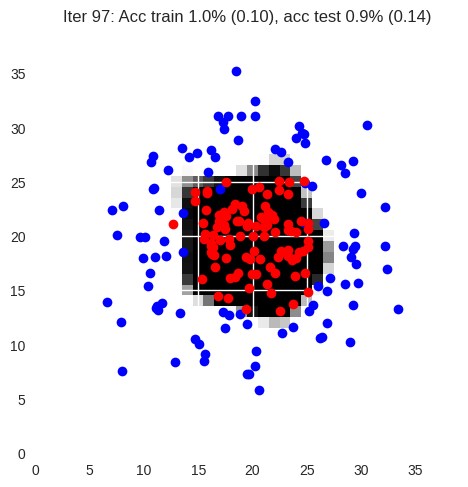

 98%|█████████▊| 98/100 [00:40<00:00,  2.45it/s]

torch.Size([200, 2])
Iter 98: Acc train 1.0% (0.12), acc test 0.9% (0.15)


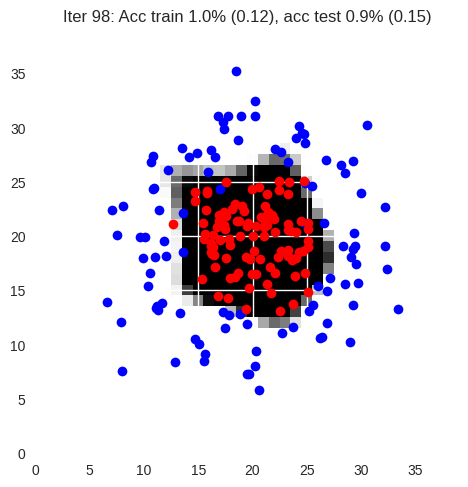

 99%|█████████▉| 99/100 [00:41<00:00,  2.49it/s]

torch.Size([200, 2])
Iter 99: Acc train 1.0% (0.10), acc test 0.9% (0.17)


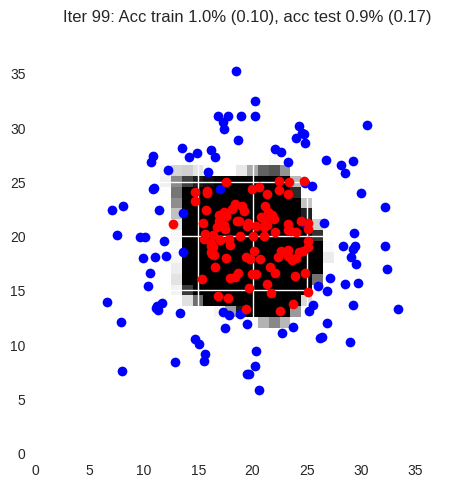

100%|██████████| 100/100 [00:41<00:00,  2.40it/s]


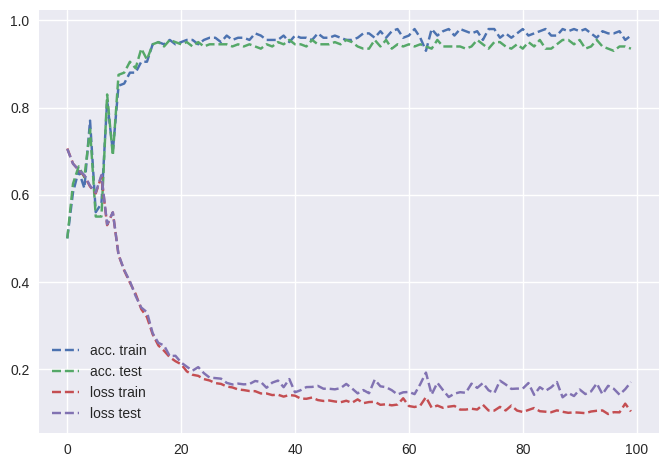

In [14]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 16
nx = data.Xtrain.shape[1]
print('nx = ', nx)
nh = 10
ny = data.Ytrain.shape[1]
print('ny = ', ny)
eta = 0.02

params = init_params(nx, nh, ny)
print(params)
curves = [[],[], [], []]

iterations = 100
# epoch
for iteration in tqdm(range(iterations)):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    print(Ytrain.shape)

    #####################
    ## Your code here  ##
    #####################
    # batches

    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)

        X = torch.tensor(Xtrain[indsBatch, :], dtype=torch.float32)
        Y = torch.tensor(Ytrain[indsBatch, :], dtype=torch.float32)

        # Forward pass
        Yhat, cache = forward(params, X)

        # Compute loss and accuracy
        loss, accuracy = loss_accuracy(Yhat, Y)

        # Backward pass
        grads = backward(params, cache, Y)

        # Update parameters using SGD
        params = sgd(params, grads, eta)

    ####################
    ##      END        #
    ####################

    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.grid(True)
plt.legend()
plt.show()

# Part 2 : Simplification of the backward pass with `torch.autograd`



In [15]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by
    # activaye autograd on the network weights

    params["Wh"] = torch.randn(nx, nh, requires_grad=True)
    params["Wy"] = torch.randn(nh, ny, requires_grad=True)
    params["bh"] = torch.randn(nh, requires_grad=True)
    params["by"] = torch.randn(ny, requires_grad=True)

    ####################
    ##      END        #
    ####################
    return params

The function `forward` remains unchanged from previous part.

The function `backward` is no longer used because of "autograd".

In [16]:
def sgd(params, eta):
    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators
    # Update the network weights using gradient descent

    with torch.no_grad():
        for param in params.values():
            param -= eta * param.grad
            param.grad.zero_()

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure with autograd

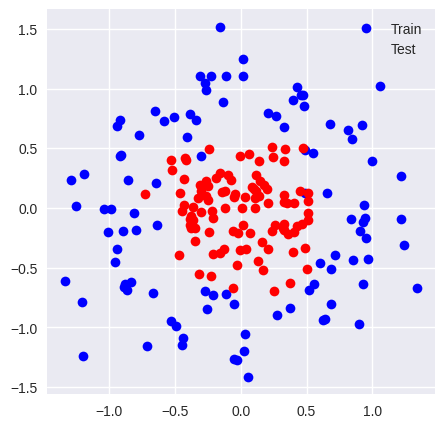

Iter 0: Acc train 0.5% (0.77), acc test 0.5% (0.74)


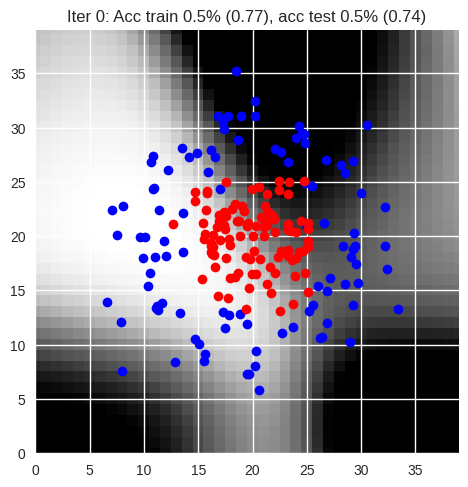

Iter 1: Acc train 0.5% (0.75), acc test 0.5% (0.72)


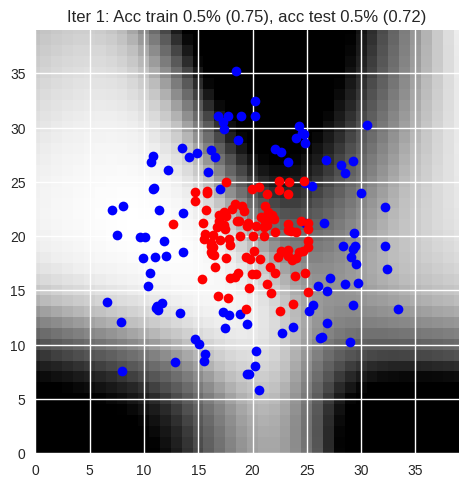

Iter 2: Acc train 0.6% (0.73), acc test 0.6% (0.70)


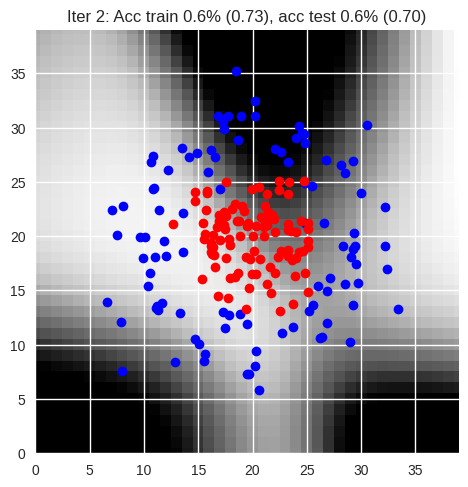

Iter 3: Acc train 0.6% (0.72), acc test 0.6% (0.68)


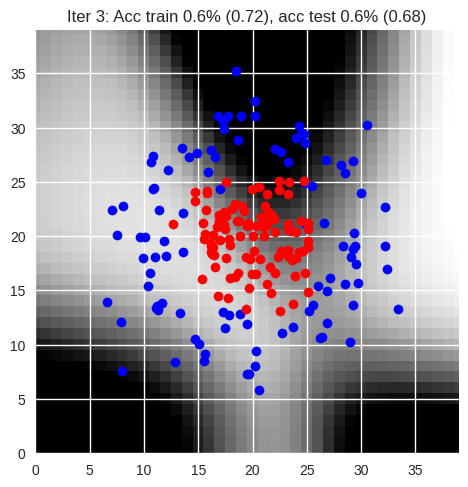

Iter 4: Acc train 0.6% (0.71), acc test 0.6% (0.68)


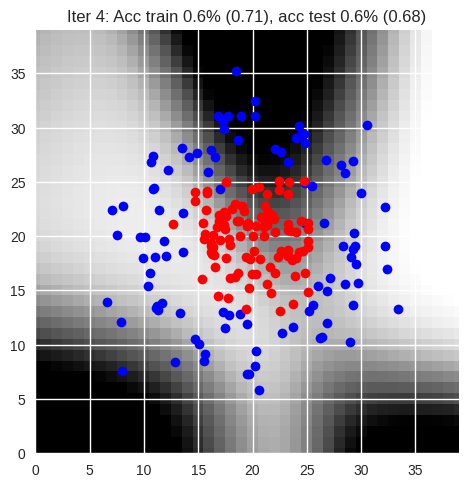

Iter 5: Acc train 0.6% (0.70), acc test 0.7% (0.66)


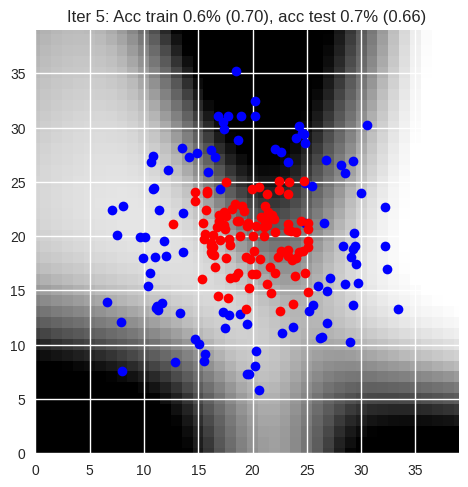

Iter 6: Acc train 0.7% (0.69), acc test 0.7% (0.66)


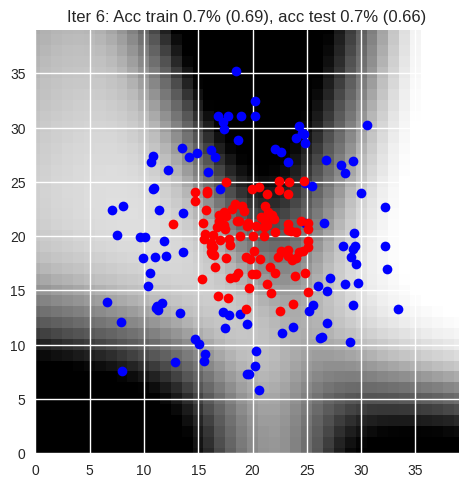

Iter 7: Acc train 0.7% (0.68), acc test 0.8% (0.65)


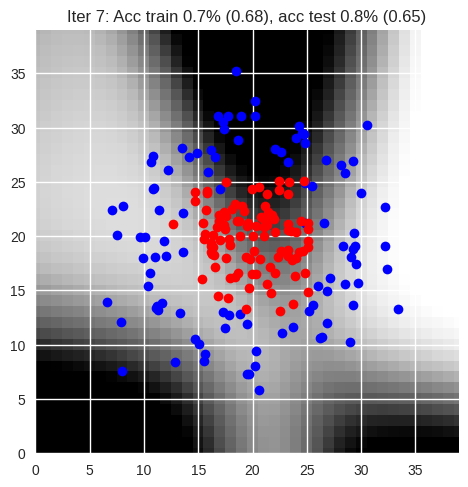

Iter 8: Acc train 0.7% (0.67), acc test 0.7% (0.64)


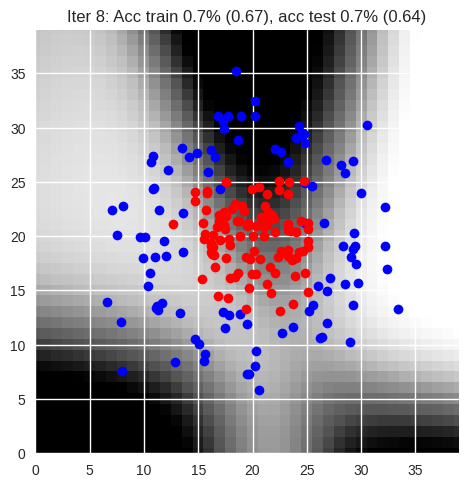

Iter 9: Acc train 0.7% (0.66), acc test 0.7% (0.63)


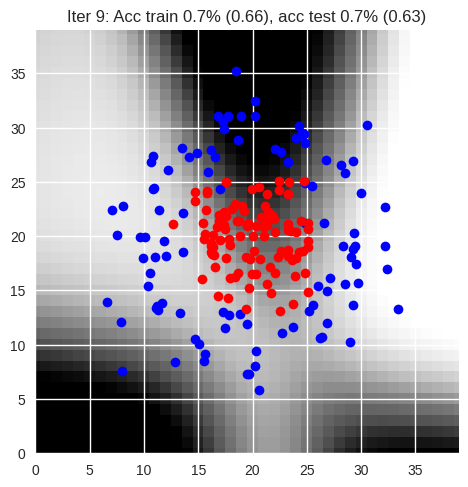

Iter 10: Acc train 0.7% (0.66), acc test 0.8% (0.63)


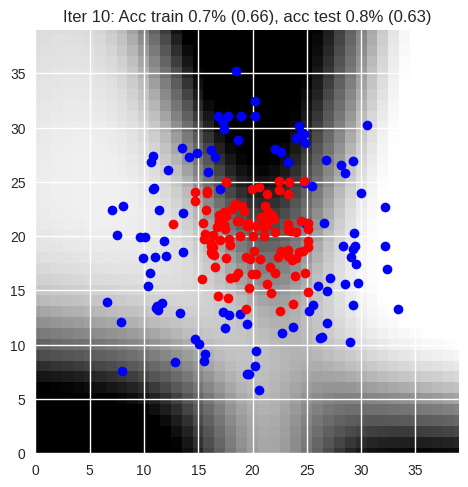

Iter 11: Acc train 0.7% (0.65), acc test 0.8% (0.62)


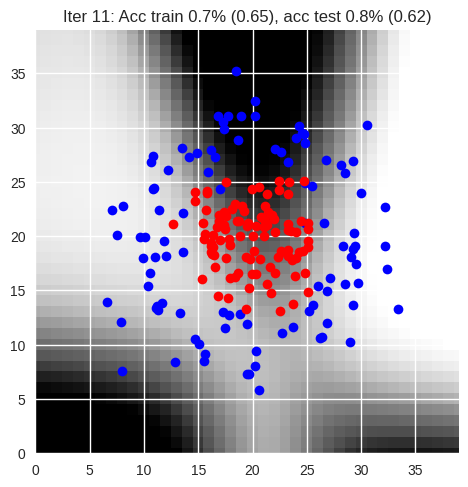

Iter 12: Acc train 0.7% (0.64), acc test 0.8% (0.61)


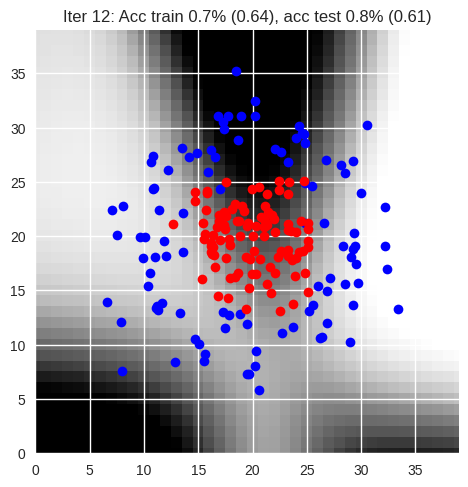

Iter 13: Acc train 0.7% (0.64), acc test 0.8% (0.61)


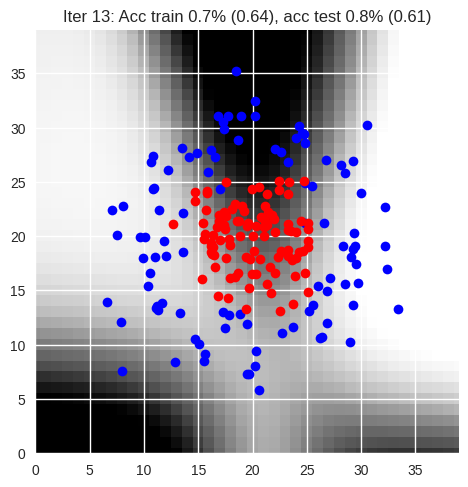

Iter 14: Acc train 0.7% (0.63), acc test 0.8% (0.60)


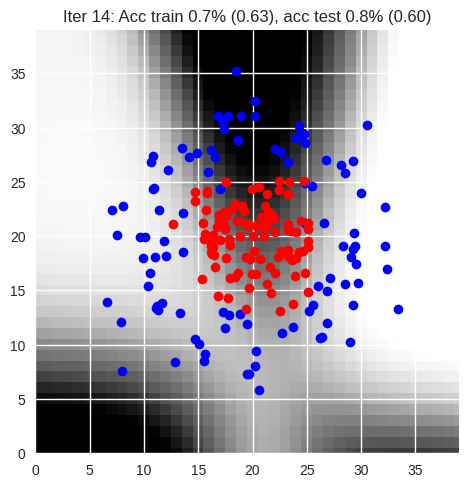

Iter 15: Acc train 0.8% (0.63), acc test 0.8% (0.60)


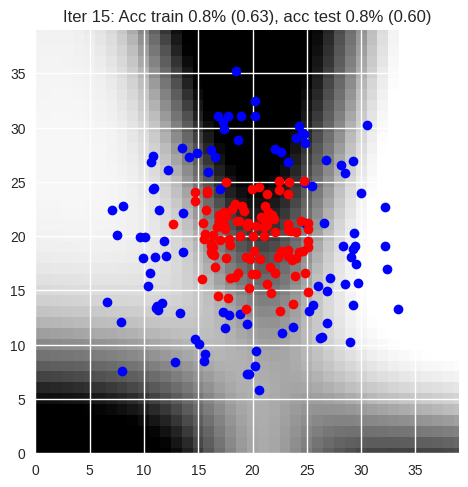

Iter 16: Acc train 0.7% (0.62), acc test 0.8% (0.59)


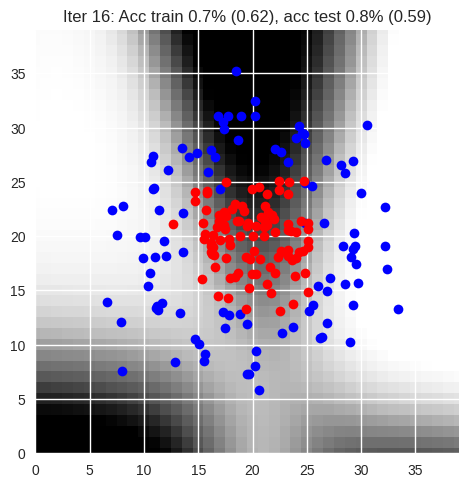

Iter 17: Acc train 0.7% (0.62), acc test 0.8% (0.59)


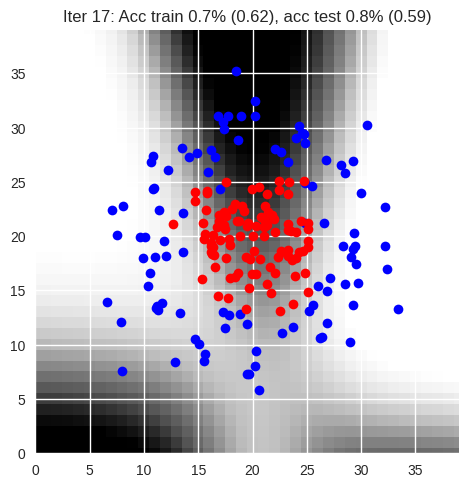

Iter 18: Acc train 0.7% (0.61), acc test 0.8% (0.59)


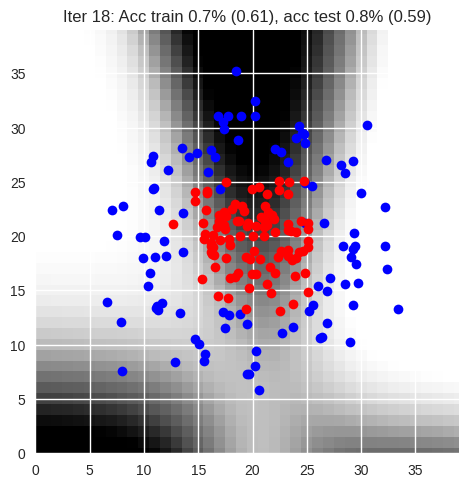

Iter 19: Acc train 0.8% (0.61), acc test 0.8% (0.58)


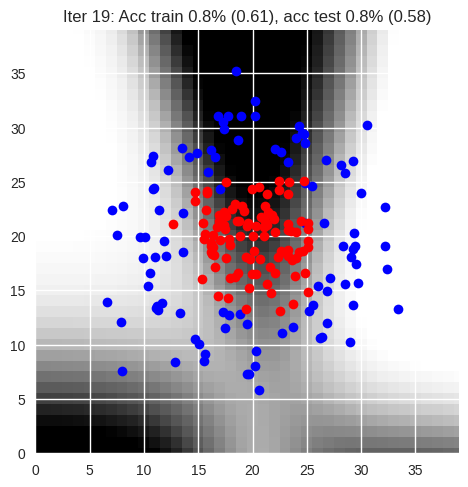

Iter 20: Acc train 0.7% (0.60), acc test 0.8% (0.58)


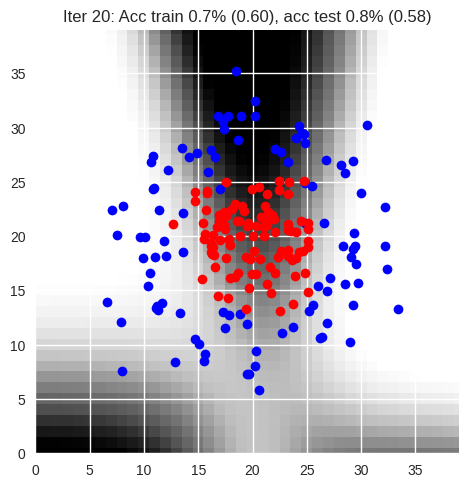

Iter 21: Acc train 0.8% (0.60), acc test 0.8% (0.57)


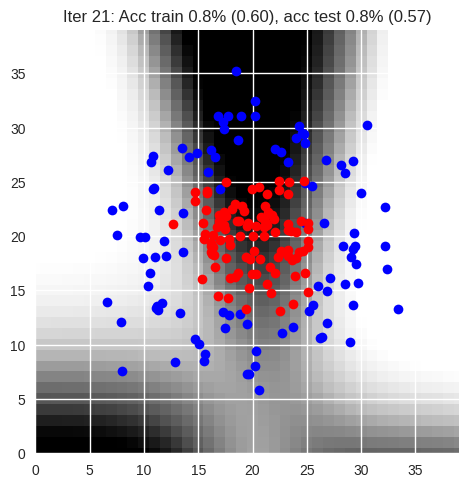

Iter 22: Acc train 0.8% (0.59), acc test 0.8% (0.57)


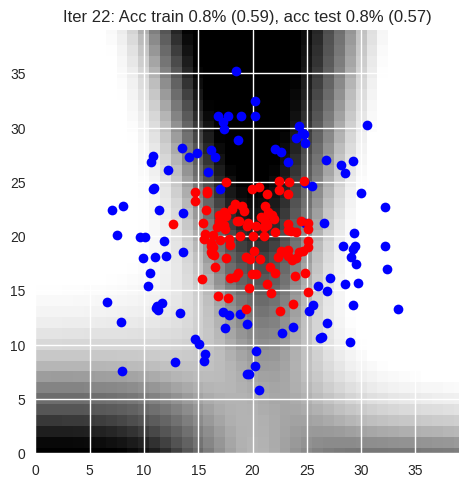

Iter 23: Acc train 0.8% (0.59), acc test 0.8% (0.57)


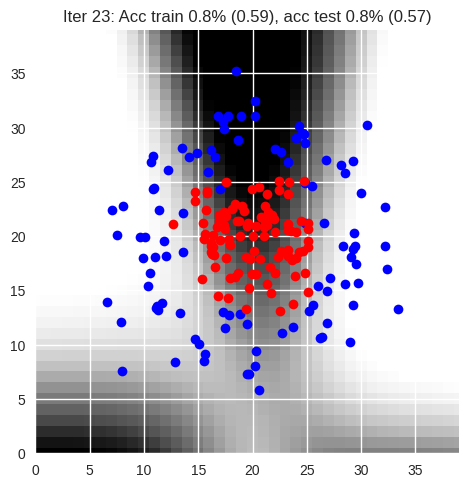

Iter 24: Acc train 0.8% (0.59), acc test 0.8% (0.56)


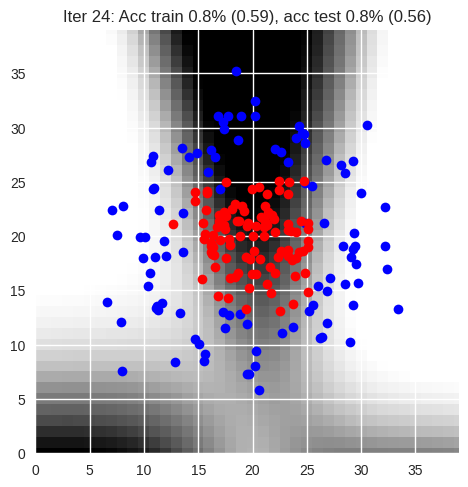

Iter 25: Acc train 0.8% (0.58), acc test 0.8% (0.56)


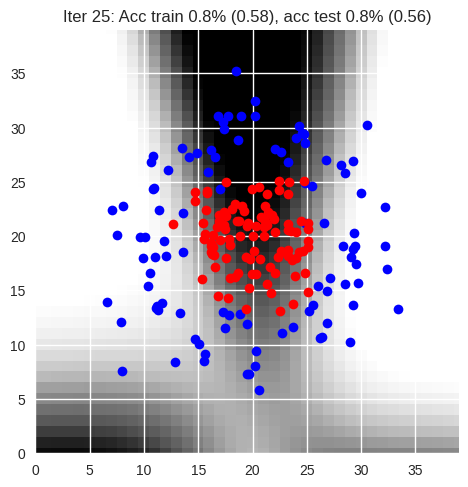

Iter 26: Acc train 0.8% (0.58), acc test 0.8% (0.56)


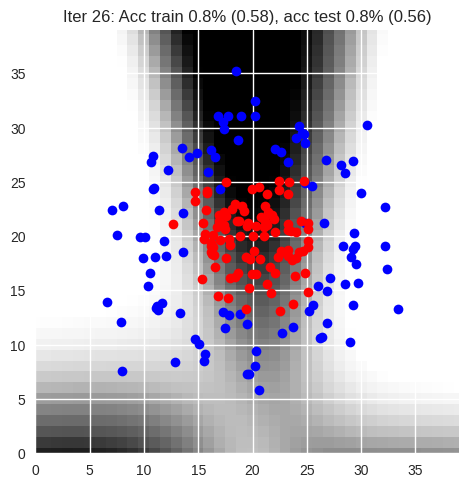

Iter 27: Acc train 0.8% (0.57), acc test 0.8% (0.55)


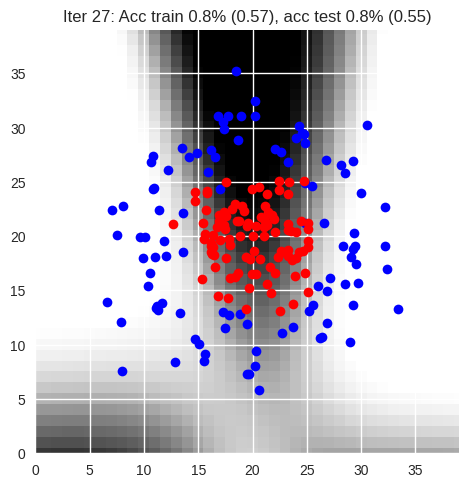

Iter 28: Acc train 0.8% (0.57), acc test 0.8% (0.55)


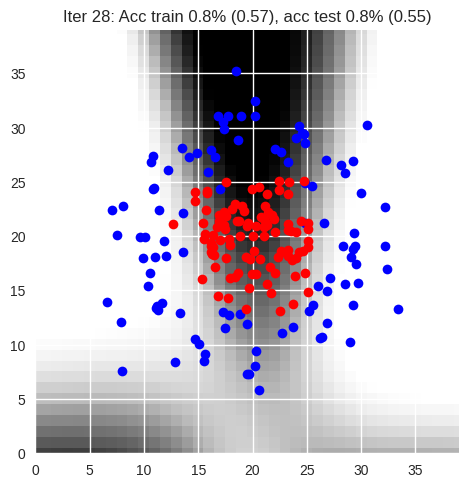

Iter 29: Acc train 0.8% (0.57), acc test 0.8% (0.55)


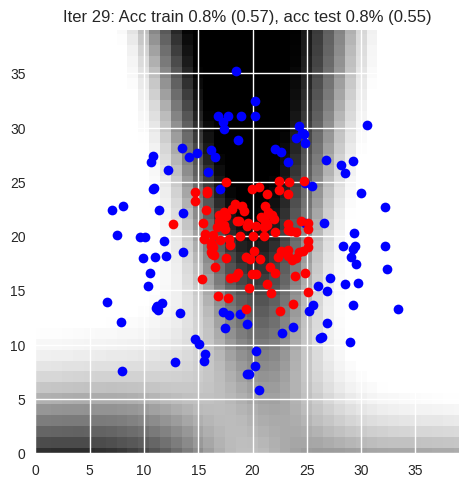

Iter 30: Acc train 0.8% (0.57), acc test 0.8% (0.54)


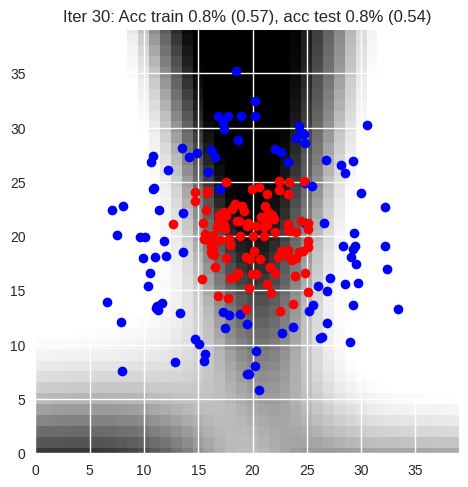

Iter 31: Acc train 0.8% (0.56), acc test 0.8% (0.54)


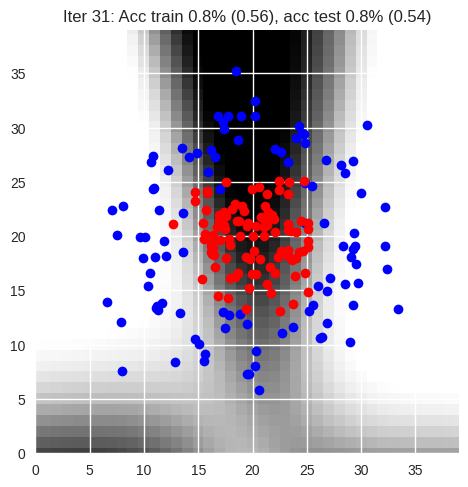

Iter 32: Acc train 0.8% (0.56), acc test 0.8% (0.54)


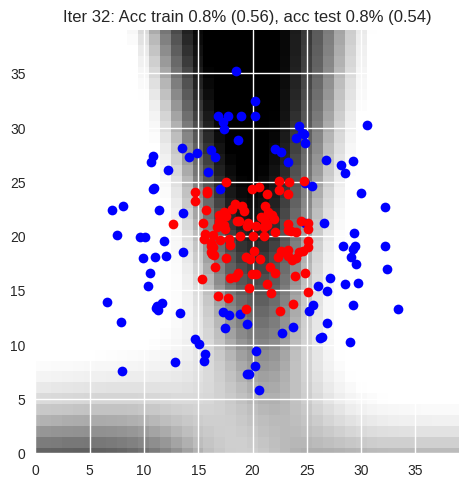

Iter 33: Acc train 0.8% (0.56), acc test 0.8% (0.54)


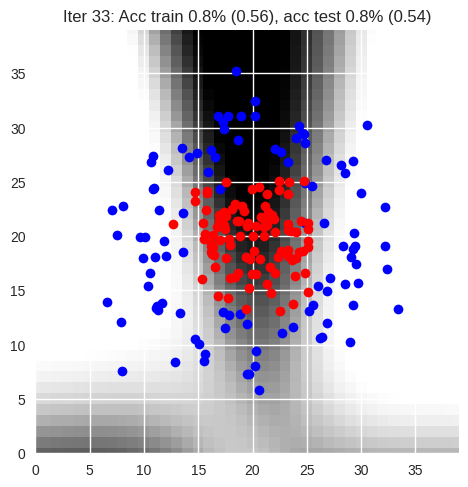

Iter 34: Acc train 0.8% (0.55), acc test 0.8% (0.53)


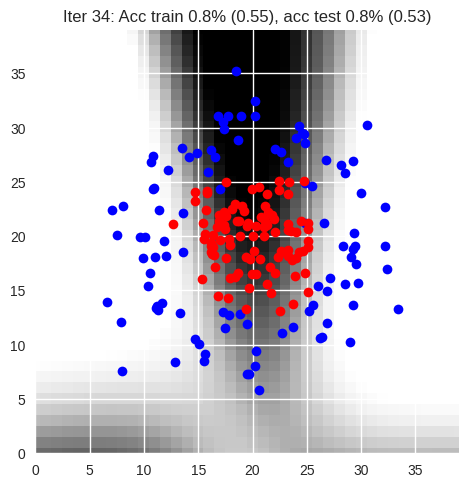

Iter 35: Acc train 0.8% (0.55), acc test 0.8% (0.53)


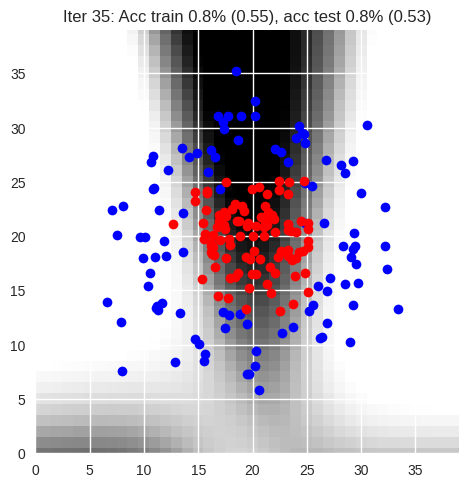

Iter 36: Acc train 0.8% (0.55), acc test 0.8% (0.53)


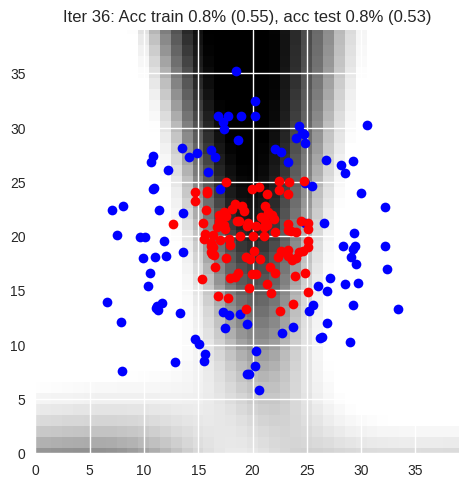

Iter 37: Acc train 0.8% (0.55), acc test 0.8% (0.53)


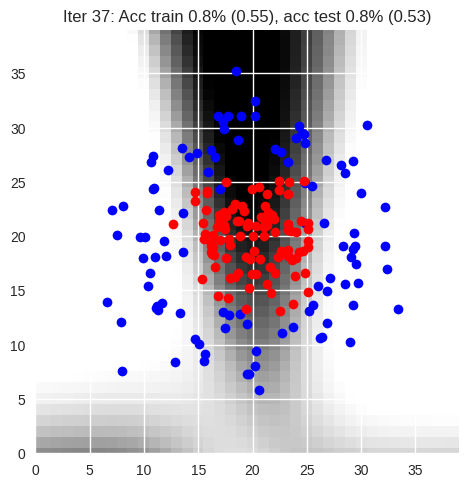

Iter 38: Acc train 0.8% (0.54), acc test 0.8% (0.52)


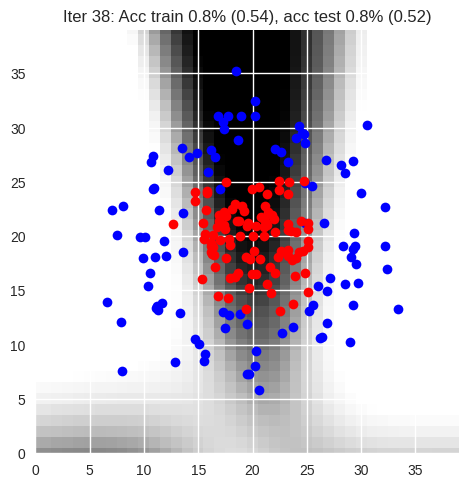

Iter 39: Acc train 0.8% (0.54), acc test 0.8% (0.52)


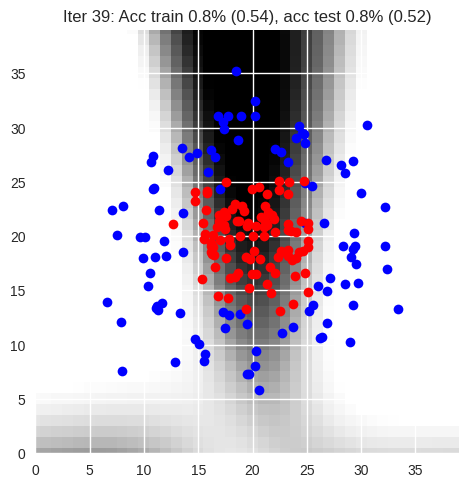

Iter 40: Acc train 0.8% (0.54), acc test 0.8% (0.52)


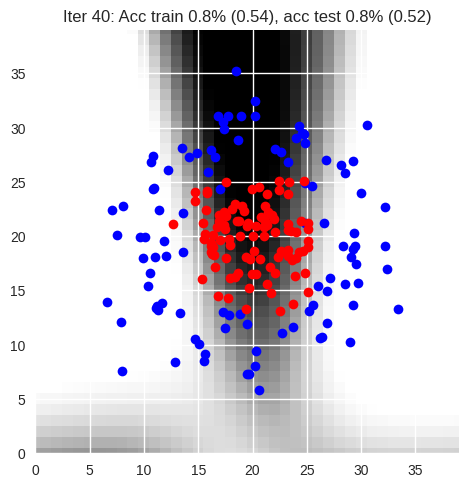

Iter 41: Acc train 0.8% (0.54), acc test 0.8% (0.52)


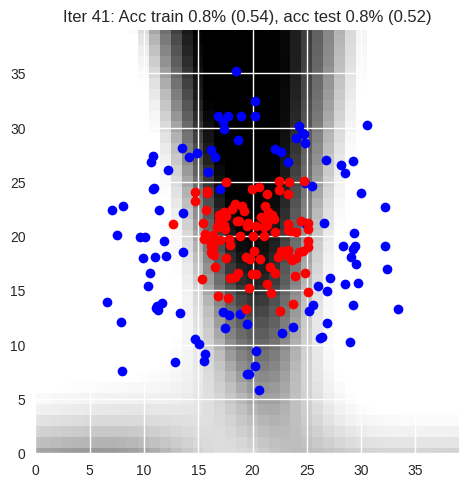

Iter 42: Acc train 0.8% (0.53), acc test 0.8% (0.52)


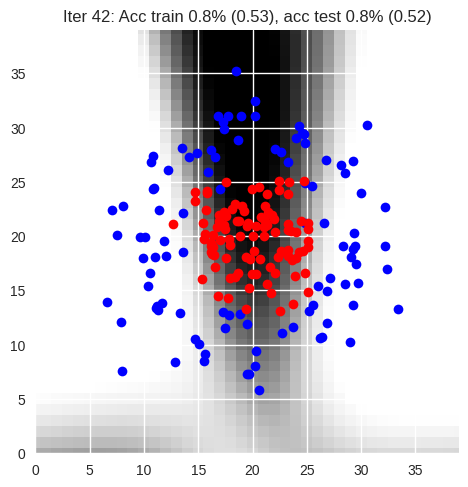

Iter 43: Acc train 0.8% (0.53), acc test 0.8% (0.51)


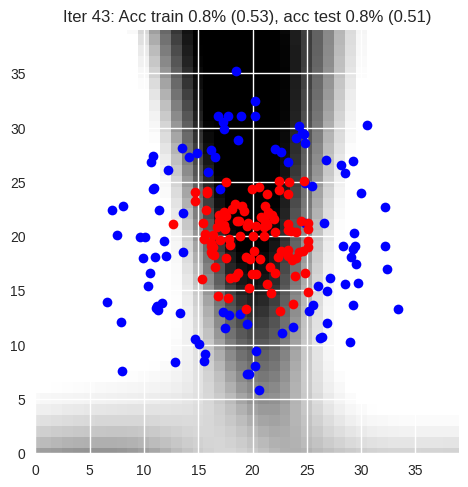

Iter 44: Acc train 0.8% (0.53), acc test 0.8% (0.51)


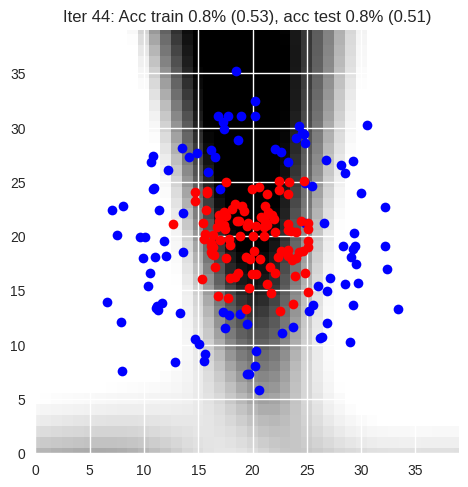

Iter 45: Acc train 0.8% (0.53), acc test 0.8% (0.51)


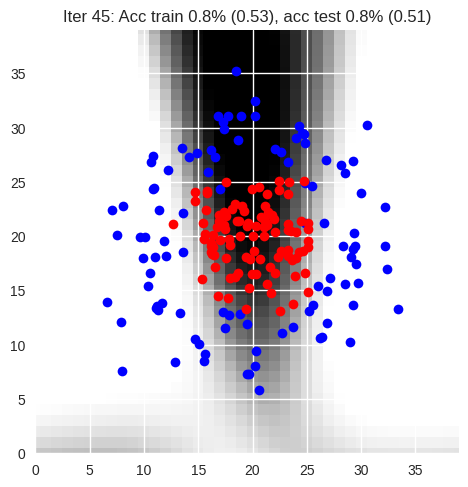

Iter 46: Acc train 0.8% (0.53), acc test 0.8% (0.51)


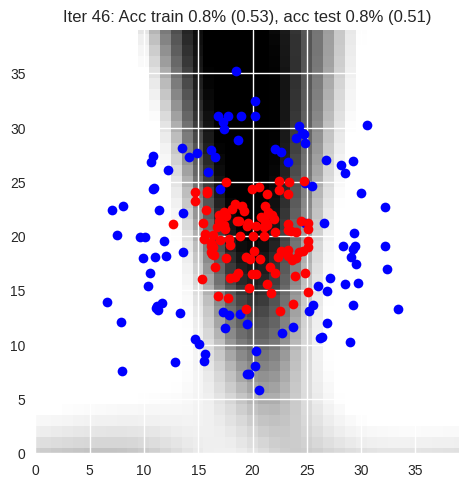

Iter 47: Acc train 0.8% (0.52), acc test 0.8% (0.51)


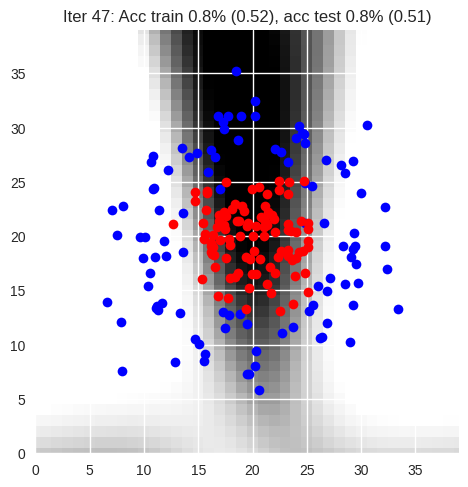

Iter 48: Acc train 0.8% (0.52), acc test 0.8% (0.50)


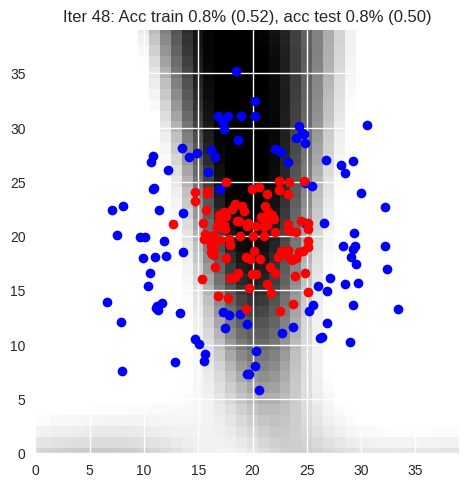

Iter 49: Acc train 0.8% (0.52), acc test 0.8% (0.50)


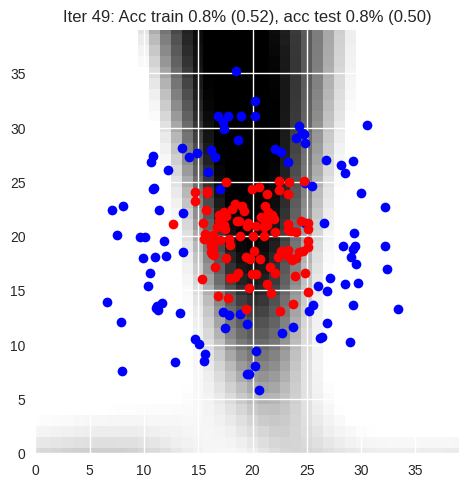

Iter 50: Acc train 0.8% (0.52), acc test 0.8% (0.50)


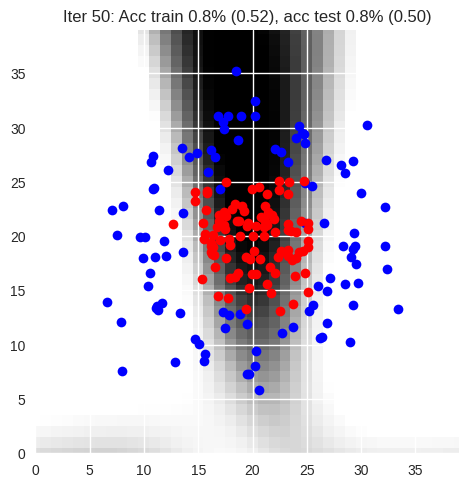

Iter 51: Acc train 0.8% (0.52), acc test 0.8% (0.50)


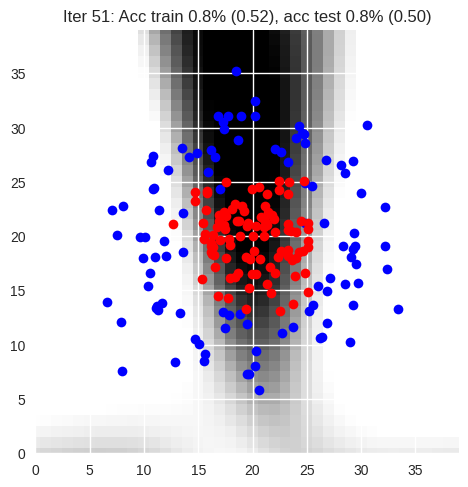

Iter 52: Acc train 0.8% (0.52), acc test 0.8% (0.50)


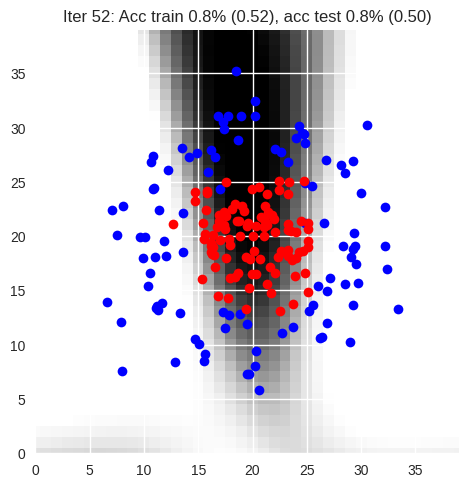

Iter 53: Acc train 0.8% (0.51), acc test 0.8% (0.50)


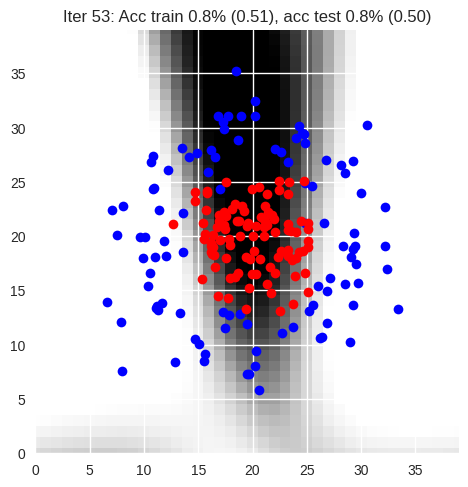

Iter 54: Acc train 0.8% (0.51), acc test 0.8% (0.49)


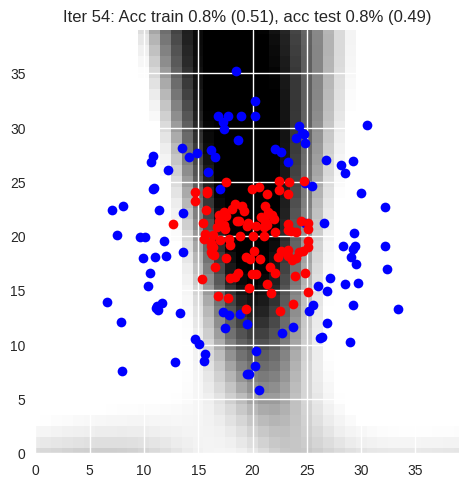

Iter 55: Acc train 0.8% (0.51), acc test 0.8% (0.49)


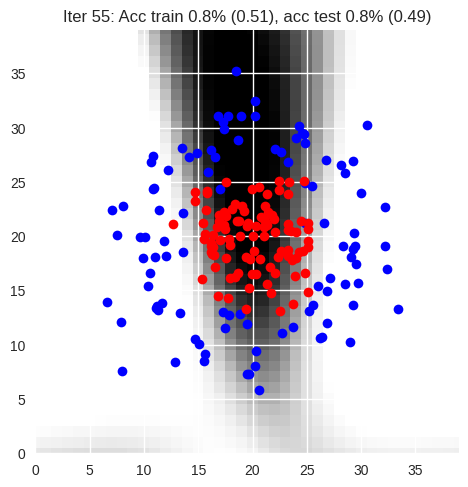

Iter 56: Acc train 0.8% (0.51), acc test 0.8% (0.49)


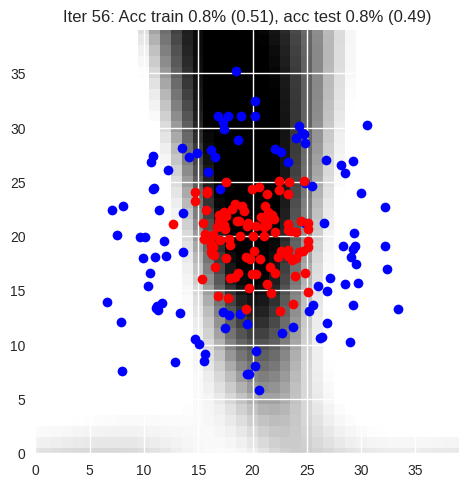

Iter 57: Acc train 0.8% (0.51), acc test 0.8% (0.49)


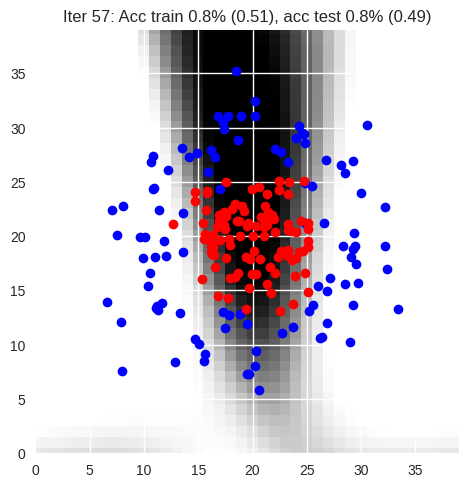

Iter 58: Acc train 0.8% (0.50), acc test 0.8% (0.49)


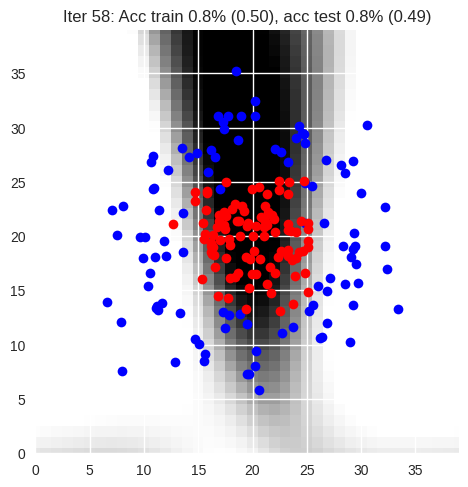

Iter 59: Acc train 0.8% (0.50), acc test 0.8% (0.49)


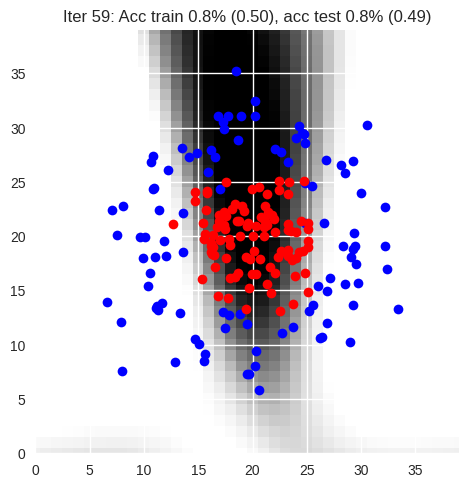

Iter 60: Acc train 0.8% (0.50), acc test 0.8% (0.48)


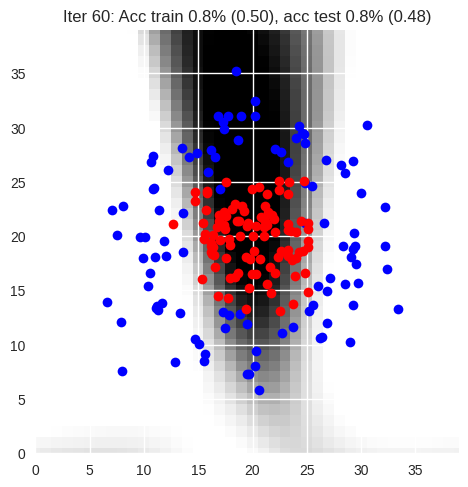

Iter 61: Acc train 0.8% (0.50), acc test 0.8% (0.48)


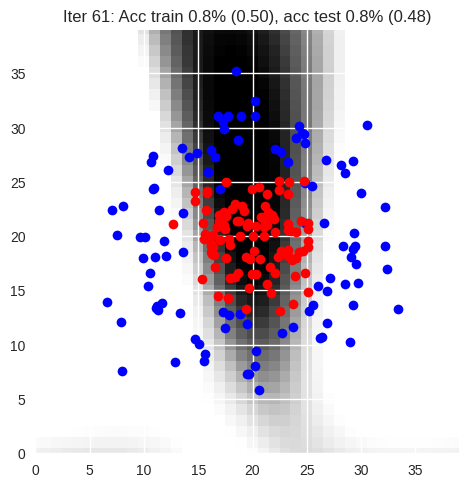

Iter 62: Acc train 0.8% (0.50), acc test 0.8% (0.48)


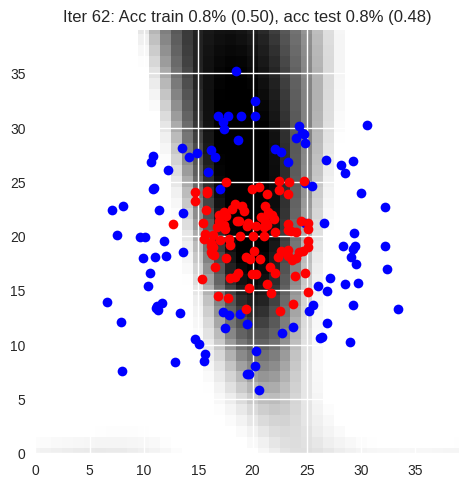

Iter 63: Acc train 0.8% (0.50), acc test 0.8% (0.48)


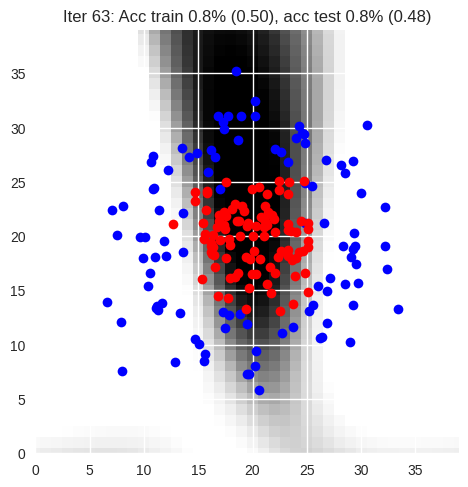

Iter 64: Acc train 0.8% (0.49), acc test 0.8% (0.48)


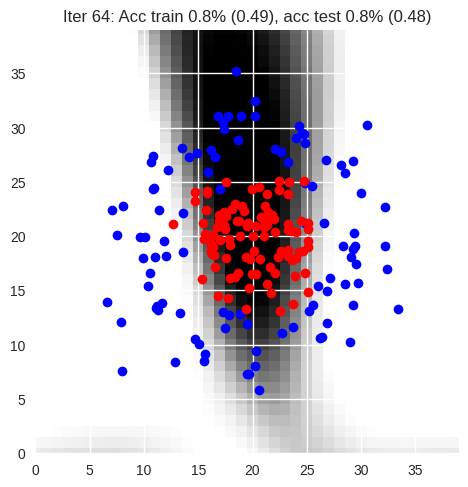

Iter 65: Acc train 0.8% (0.49), acc test 0.8% (0.48)


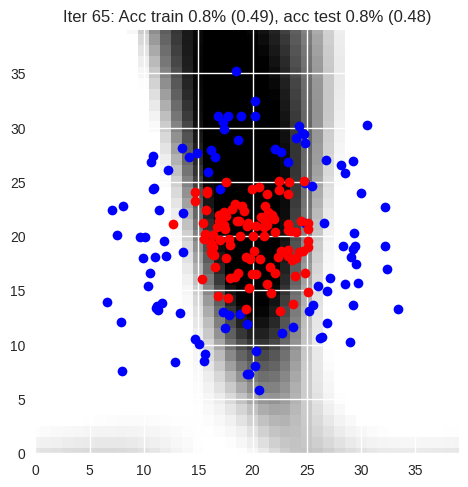

Iter 66: Acc train 0.8% (0.49), acc test 0.8% (0.48)


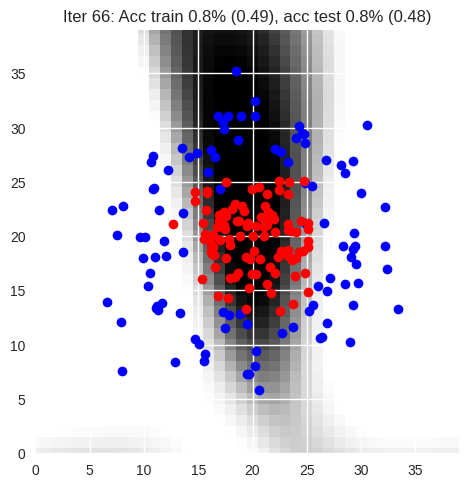

Iter 67: Acc train 0.8% (0.49), acc test 0.8% (0.47)


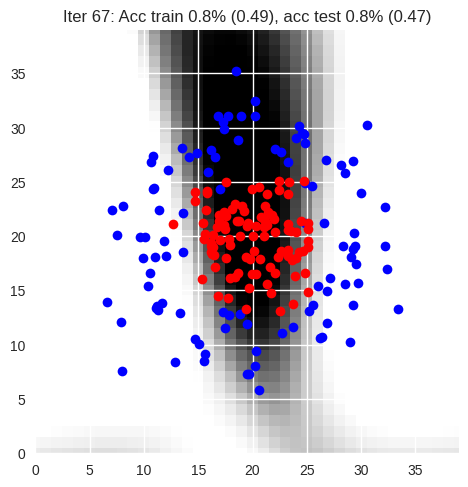

Iter 68: Acc train 0.8% (0.49), acc test 0.8% (0.47)


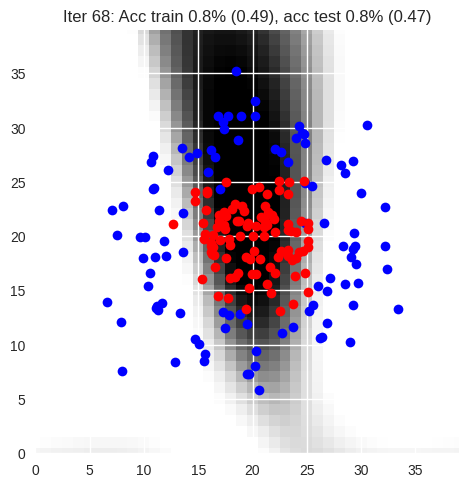

Iter 69: Acc train 0.8% (0.49), acc test 0.8% (0.47)


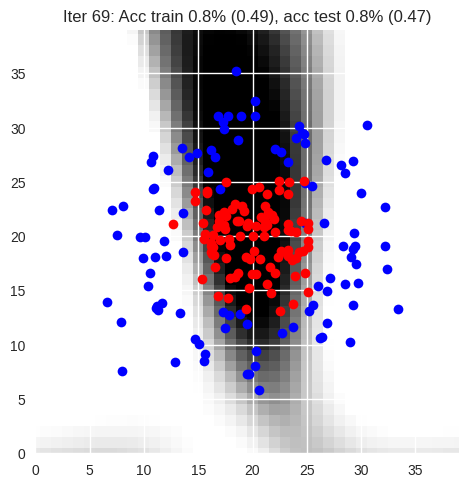

Iter 70: Acc train 0.8% (0.48), acc test 0.8% (0.47)


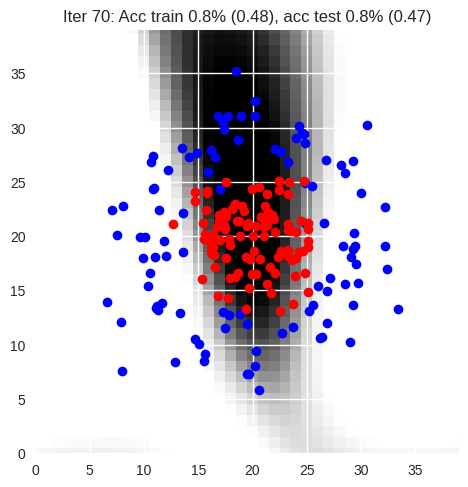

Iter 71: Acc train 0.8% (0.48), acc test 0.8% (0.47)


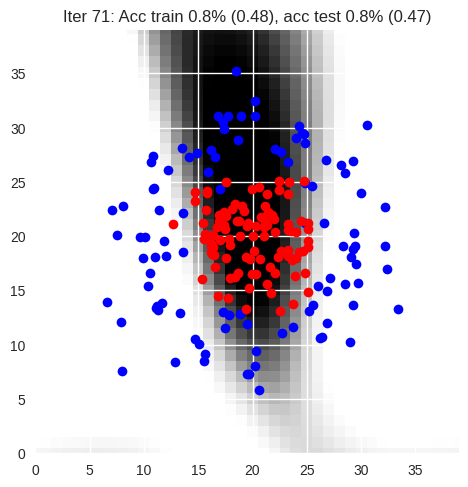

Iter 72: Acc train 0.8% (0.48), acc test 0.8% (0.47)


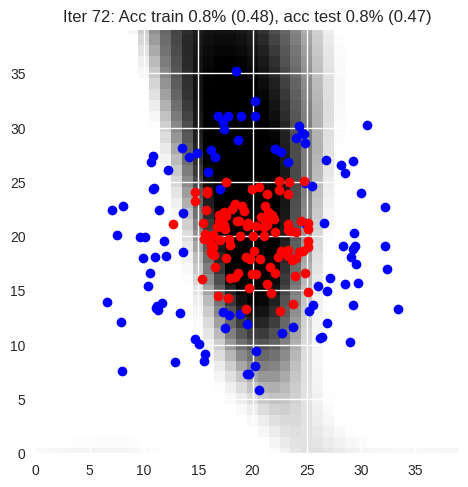

Iter 73: Acc train 0.8% (0.48), acc test 0.8% (0.46)


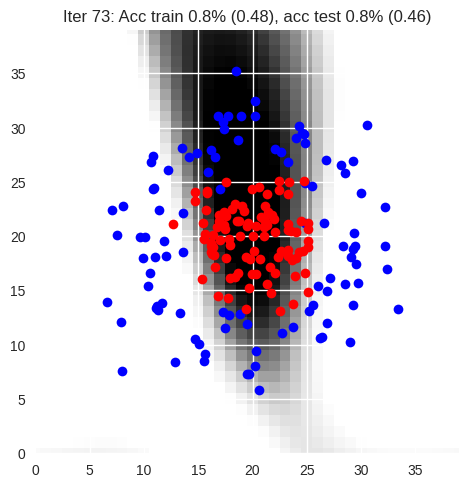

Iter 74: Acc train 0.8% (0.48), acc test 0.8% (0.46)


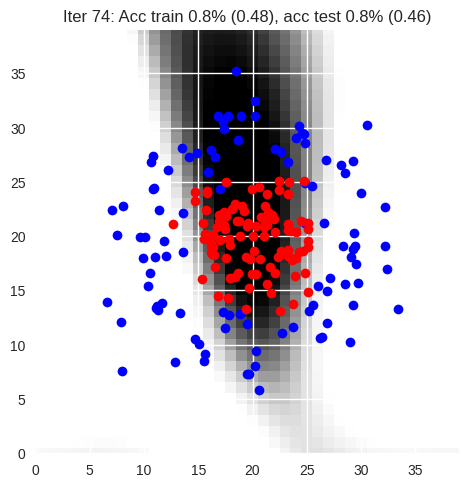

Iter 75: Acc train 0.8% (0.47), acc test 0.8% (0.46)


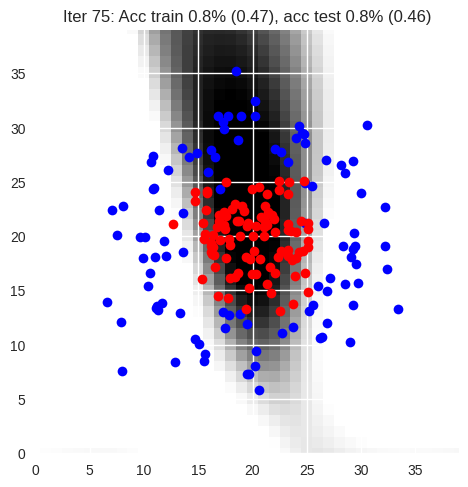

Iter 76: Acc train 0.8% (0.47), acc test 0.8% (0.46)


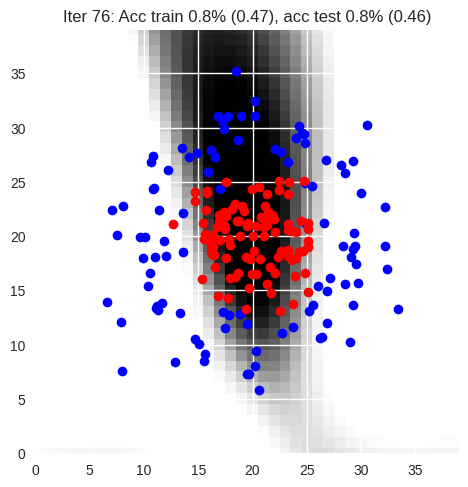

Iter 77: Acc train 0.8% (0.47), acc test 0.8% (0.46)


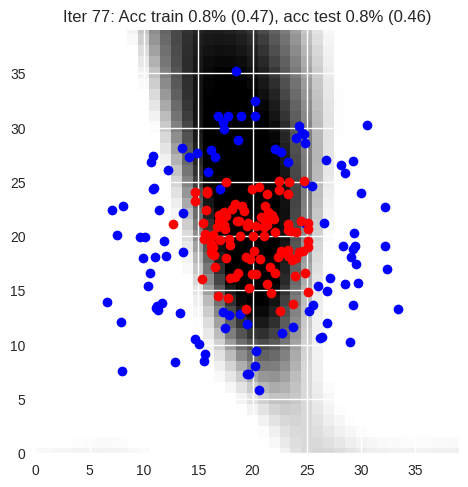

Iter 78: Acc train 0.8% (0.47), acc test 0.8% (0.46)


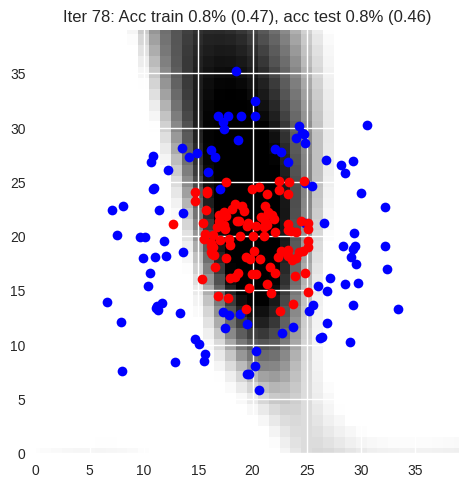

Iter 79: Acc train 0.8% (0.47), acc test 0.8% (0.46)


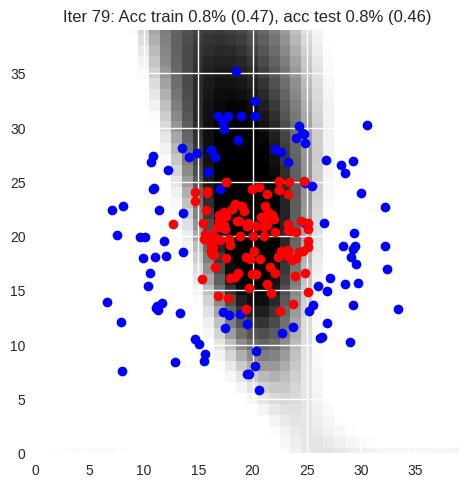

Iter 80: Acc train 0.8% (0.46), acc test 0.8% (0.45)


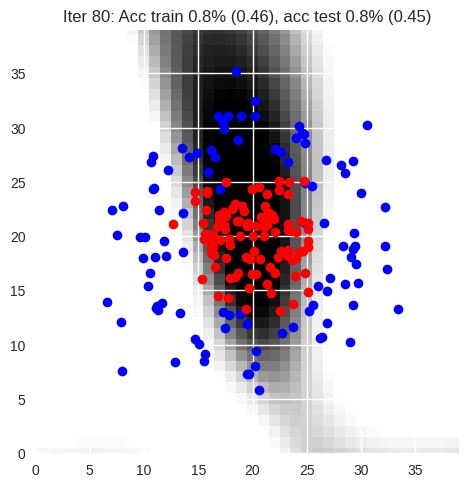

Iter 81: Acc train 0.8% (0.46), acc test 0.8% (0.45)


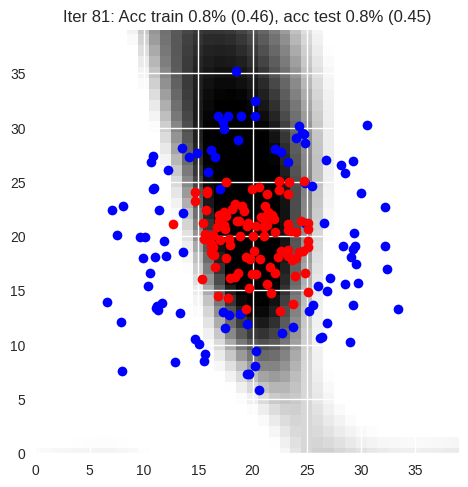

Iter 82: Acc train 0.8% (0.46), acc test 0.8% (0.45)


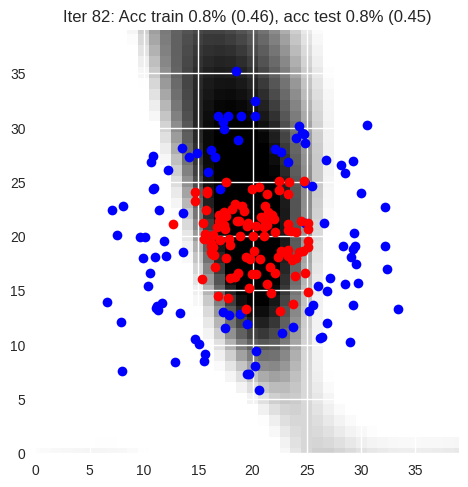

Iter 83: Acc train 0.8% (0.46), acc test 0.8% (0.45)


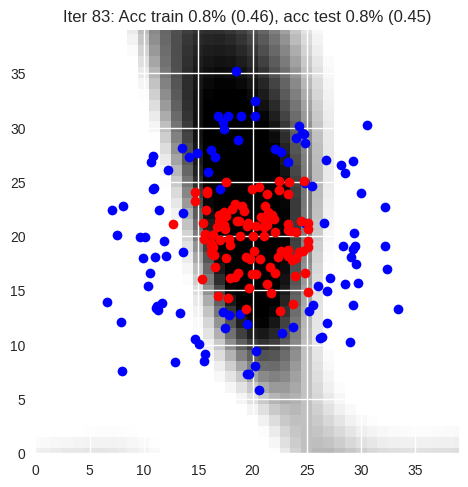

Iter 84: Acc train 0.8% (0.46), acc test 0.8% (0.45)


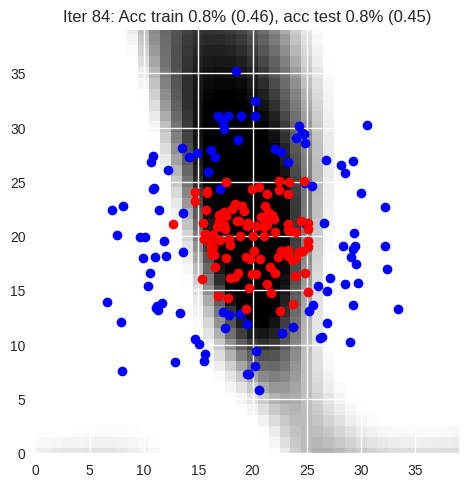

Iter 85: Acc train 0.8% (0.46), acc test 0.8% (0.45)


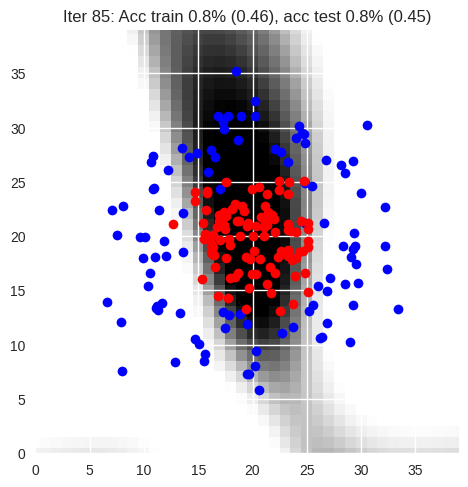

Iter 86: Acc train 0.8% (0.45), acc test 0.8% (0.45)


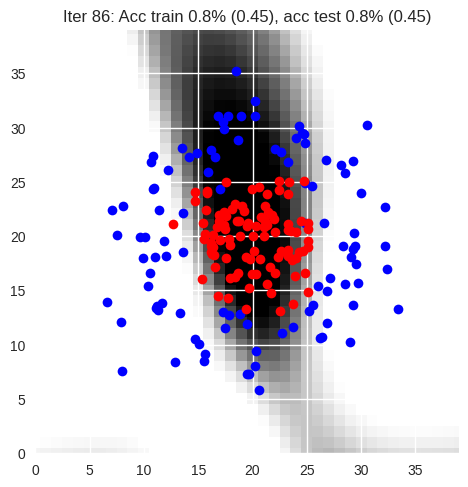

Iter 87: Acc train 0.8% (0.45), acc test 0.8% (0.44)


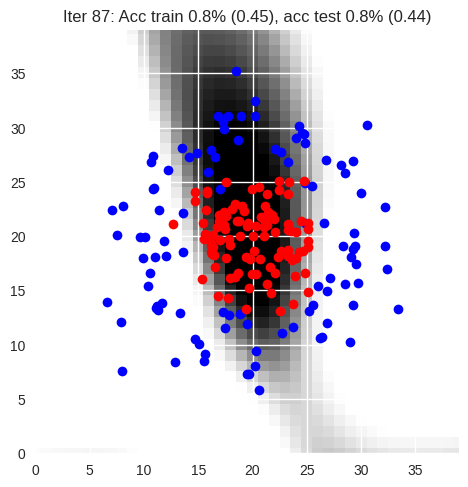

Iter 88: Acc train 0.8% (0.45), acc test 0.8% (0.44)


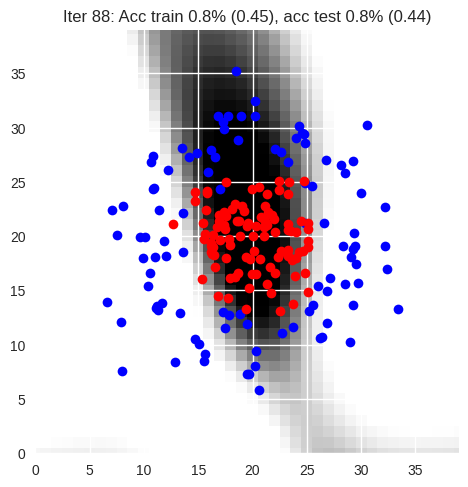

Iter 89: Acc train 0.8% (0.45), acc test 0.8% (0.44)


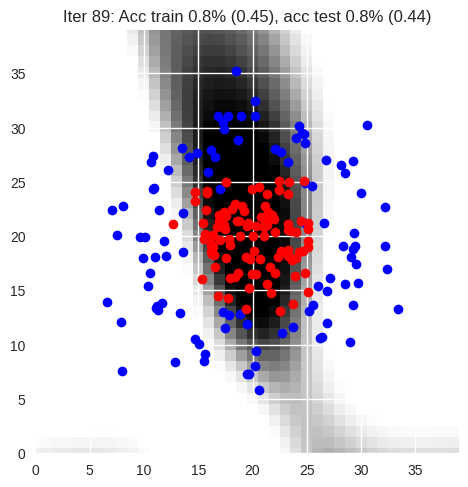

Iter 90: Acc train 0.8% (0.45), acc test 0.8% (0.44)


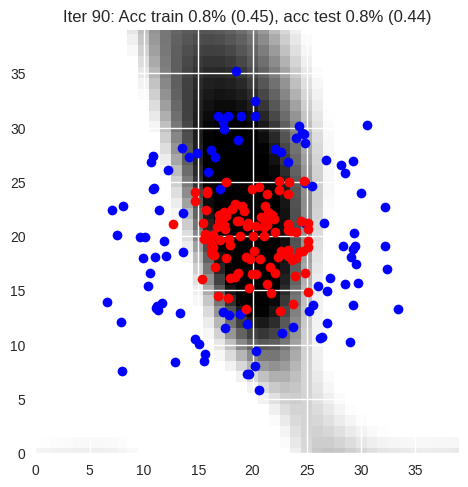

Iter 91: Acc train 0.8% (0.44), acc test 0.8% (0.44)


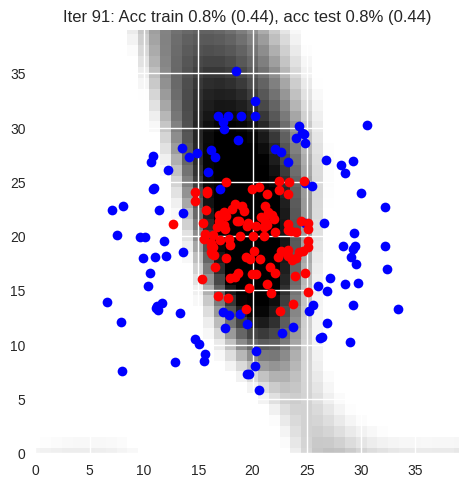

Iter 92: Acc train 0.8% (0.44), acc test 0.8% (0.44)


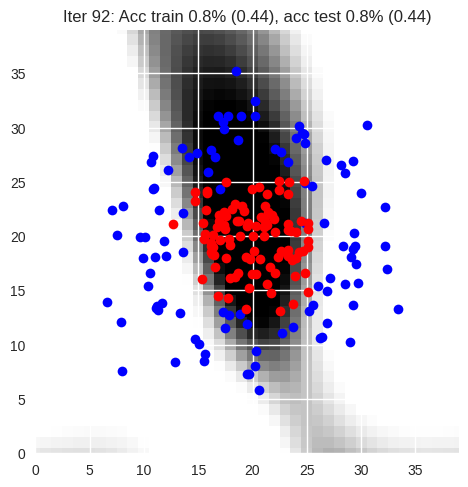

Iter 93: Acc train 0.8% (0.44), acc test 0.8% (0.43)


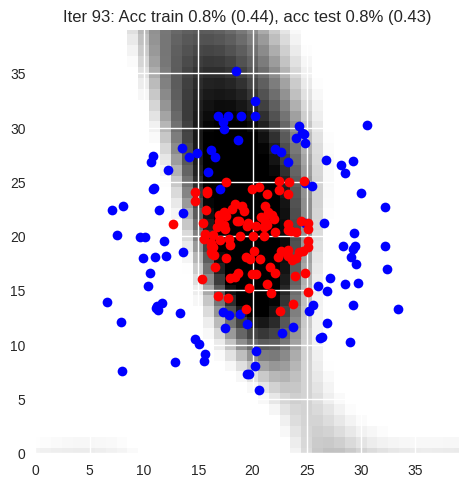

Iter 94: Acc train 0.8% (0.44), acc test 0.8% (0.43)


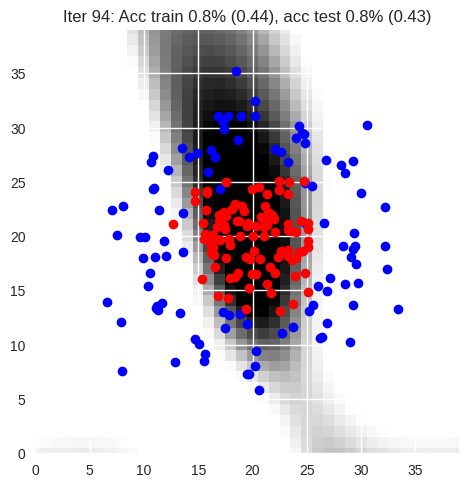

Iter 95: Acc train 0.8% (0.43), acc test 0.8% (0.43)


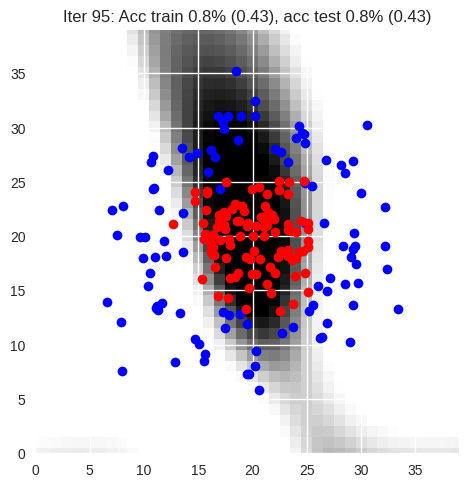

Iter 96: Acc train 0.8% (0.43), acc test 0.8% (0.43)


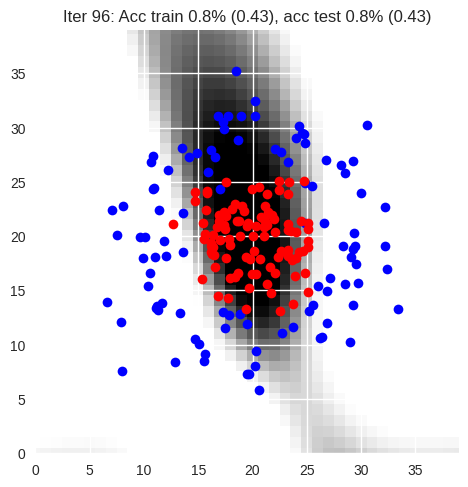

Iter 97: Acc train 0.8% (0.43), acc test 0.8% (0.43)


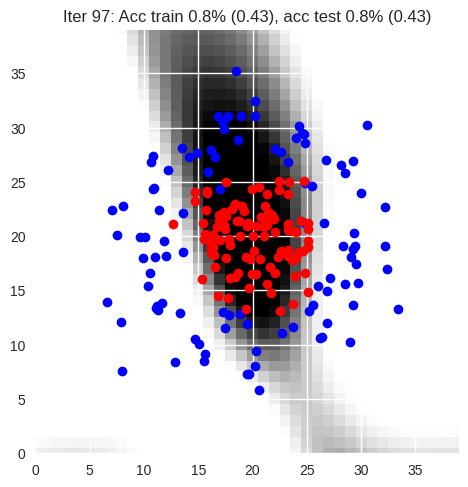

Iter 98: Acc train 0.8% (0.43), acc test 0.8% (0.43)


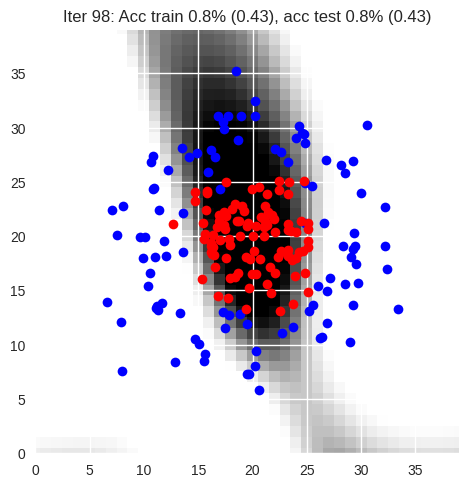

Iter 99: Acc train 0.8% (0.43), acc test 0.8% (0.43)


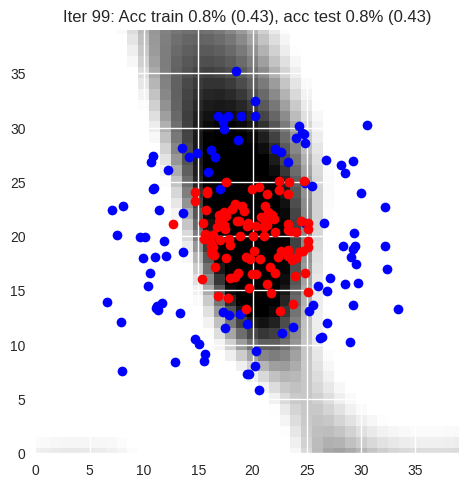

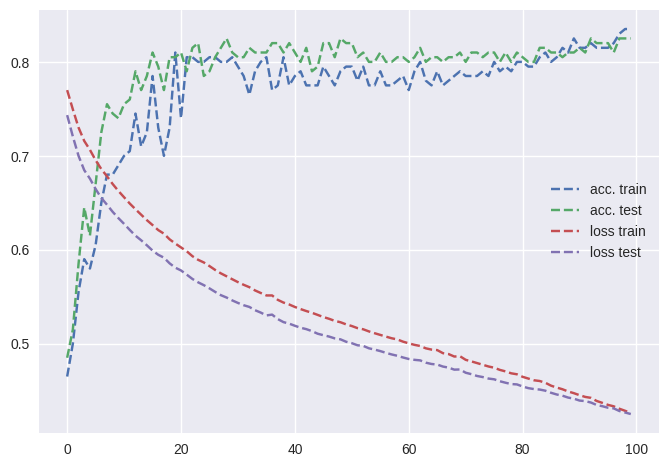

In [17]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 16
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(100):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################

    # Initialize accumulators for training loss and accuracy
    train_loss = 0.0
    train_accuracy = 0.0

    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = torch.tensor(Xtrain[indsBatch, :])  # Convert to PyTorch tensor
        Y = torch.tensor(Ytrain[indsBatch, :])  # Convert to PyTorch tensor

        # Forward pass
        Yhat, cache = forward(params, X)

        # Calculate the loss and accuracy
        loss, accuracy = loss_accuracy(Yhat, Y)

        loss.backward()

        # Update the network weights using SGD
        params = sgd(params, eta)

        # Accumulate training loss and accuracy
        train_loss += loss.item()
        train_accuracy += accuracy

        # Reset gradients to zero
        for param in params.values():
            param.grad.zero_()

    # Calculate average training loss and accuracy
    train_loss /= (N // Nbatch)
    train_accuracy /= (N // Nbatch)


    ####################
    ##      END        #
    ####################

    # Evaluate on the test set
    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltrain = Ltrain.item()
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ltest = Ltest.item()
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() is used to remove the predictions from the computational graph in autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()

plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 3 : Simplification of the forward pass with `torch.nn`

`init_params` and `forward` are replaced by the `init_model` function which defines the network architecture and the loss.

In [18]:
import torch

class simpleNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(simpleNN, self).__init__()

        self.linear1 = torch.nn.Linear(input_size, hidden_size)
        self.activation = torch.nn.Tanh() #hidden layer

        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.softmax = torch.nn.Softmax() #output layer

    def forward(self, x):
        x = self.linear1(x)
        x = self.activation(x)
        x = self.linear2(x)
        #x = self.softmax(x) softmax is already included in pytorch loss function for cross entropy loss
        return x

In [19]:
def init_model(nx, nh, ny):

    #####################
    ## Your code here  ##
    #####################

    model = simpleNN(input_size = nx, hidden_size=nh, output_size=ny)
    loss = torch.nn.CrossEntropyLoss()

    ####################
    ##      END        #
    ####################

    return model, loss

def init_model(nx, nh, ny):
  model = torch.nn.Sequential(
  torch.nn.Linear(nx, nh),
  torch.nn.Tanh(),
  torch.nn.Linear(nh, ny),
  #torch.nn.Softmax()
  )
  loss = torch.nn.CrossEntropyLoss()
  return model, loss


In [20]:
def loss_accuracy(loss, Yhat, Y):
    """
    Calculate the loss and accuracy of the model's predictions.

    Parameters:
    - Yhat: Predicted values (torch.Tensor) with shape (batch_size, num_classes)
    - Y: Ground truth labels (torch.Tensor) with shape (batch_size, num_classes)

    Returns:
    - L: Loss (scalar, torch.Tensor)
    - acc: Accuracy (percentage, float)
    """

    assert Yhat.size() == Y.size() # catch dimension errors early on

    epsilon = 1e-10

    L = loss(Yhat, Y)

    # Get the predicted class labels by taking the argmax along axis 1 (columns)
    _, indsY = torch.max(Yhat, 1)

    # Convert one-hot encoded true labels back to class indices
    _, inds_true = torch.max(Y, 1)

    # Compare the predicted labels with the true labels and calculate accuracy
    correct = torch.sum(indsY == inds_true)
    total = Y.size(0)  # Number of samples in the batch
    acc = correct.item() / total

    return L, acc

In [21]:
#test loss-accuracy
batch_size = 3
num_output_classes = 2
num_input_dim = 2

test_model, loss = init_model(nx=num_input_dim, nh=3, ny=num_output_classes)

X_sample = torch.randn(size = (batch_size, num_input_dim), requires_grad=False)
print(X_sample.shape)

Y_real = torch.randint(high = 2, size = (batch_size, num_output_classes), requires_grad=False, dtype = float)

Y_sample = test_model(X_sample)

print('Loss & Accuracy', loss_accuracy(loss = nn.CrossEntropyLoss(), Yhat = Yhat_sample, Y = Y_real))

softmax = nn.Softmax(dim=1)
print(Y_real, '\n')
print('Y predicted ', Y_sample)
print(softmax(Y_sample))

torch.Size([3, 2])
Loss & Accuracy (tensor(0.6464, dtype=torch.float64), 0.6666666666666666)
tensor([[0., 0.],
        [1., 1.],
        [1., 0.]], dtype=torch.float64) 

Y predicted  tensor([[ 0.6783, -0.0835],
        [ 0.2267,  0.6460],
        [ 0.3455,  0.6397]], grad_fn=<AddmmBackward0>)
tensor([[0.6818, 0.3182],
        [0.3967, 0.6033],
        [0.4270, 0.5730]], grad_fn=<SoftmaxBackward0>)


In [22]:
def sgd(model, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators

    with torch.no_grad():
      for param in model.parameters():
        param -= eta * param.grad
      model.zero_grad()


    ####################
    ##      END        #
    ####################
    return model


## Global learning procedure with autograd and `torch.nn`

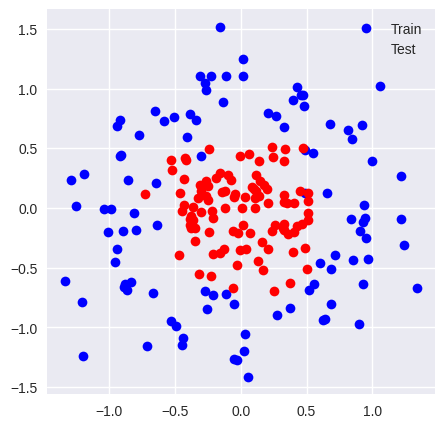

Iter 0: Acc train 0.5% (0.71), acc test 0.5% (0.71)


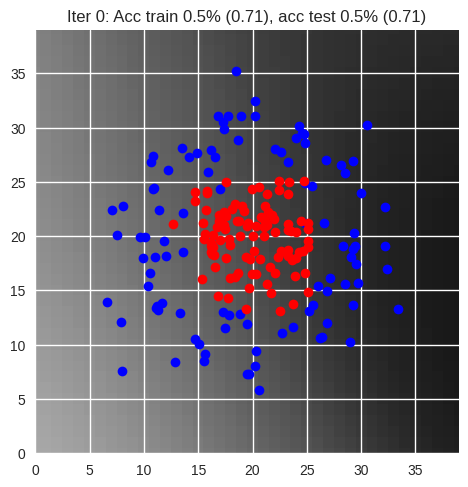

Iter 1: Acc train 0.5% (0.70), acc test 0.5% (0.70)


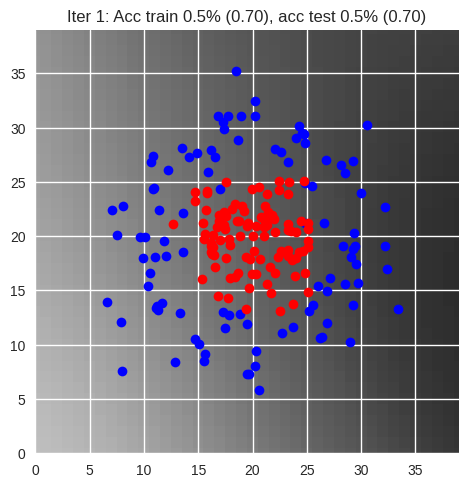

Iter 2: Acc train 0.5% (0.70), acc test 0.5% (0.70)


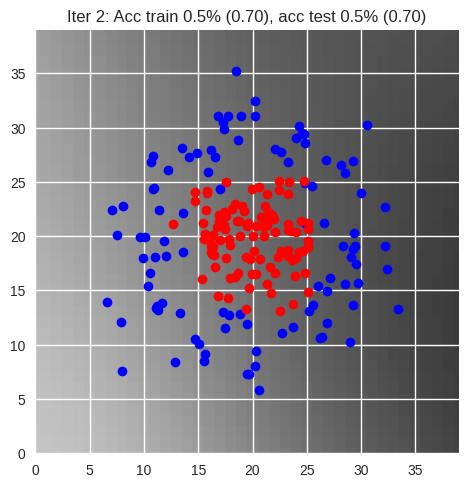

Iter 3: Acc train 0.6% (0.69), acc test 0.6% (0.70)


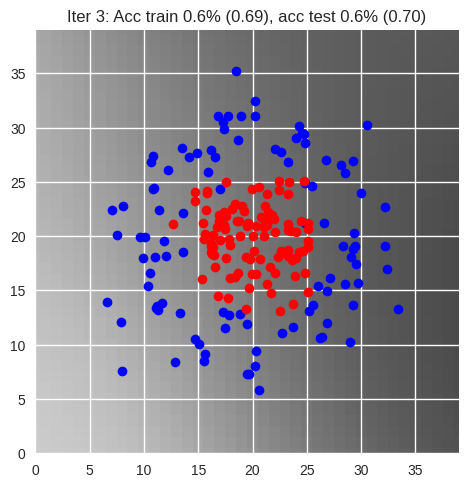

Iter 4: Acc train 0.6% (0.69), acc test 0.6% (0.69)


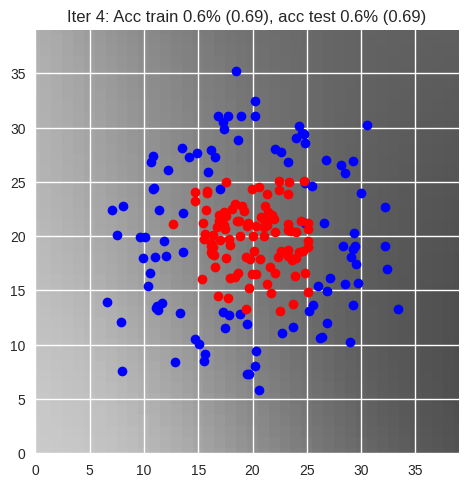

Iter 5: Acc train 0.6% (0.69), acc test 0.6% (0.69)


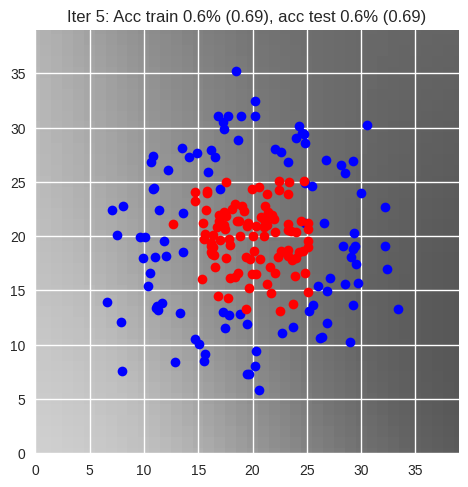

Iter 6: Acc train 0.7% (0.69), acc test 0.6% (0.69)


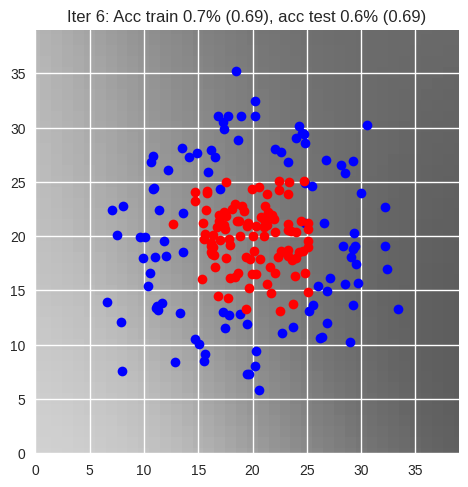

Iter 7: Acc train 0.7% (0.69), acc test 0.7% (0.69)


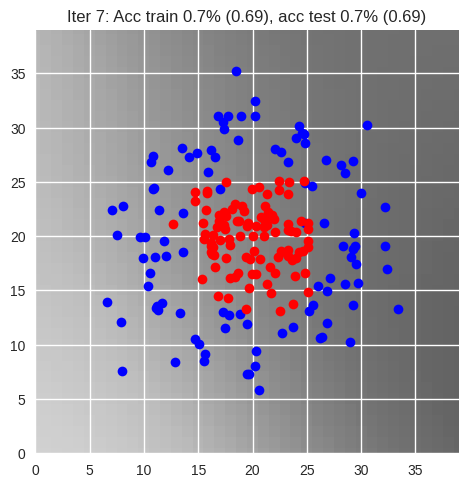

Iter 8: Acc train 0.7% (0.69), acc test 0.6% (0.69)


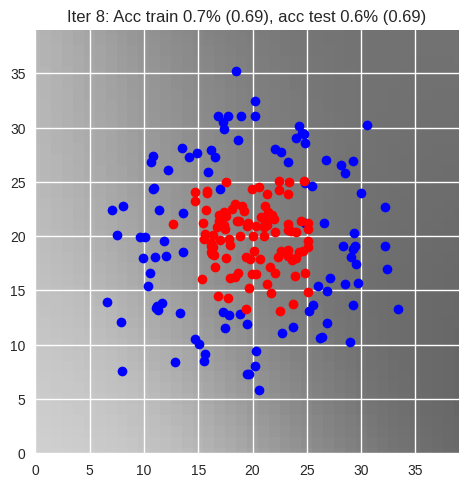

Iter 9: Acc train 0.7% (0.69), acc test 0.7% (0.69)


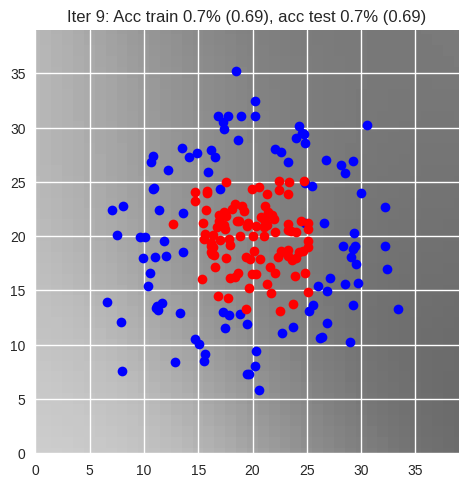

Iter 10: Acc train 0.6% (0.69), acc test 0.7% (0.69)


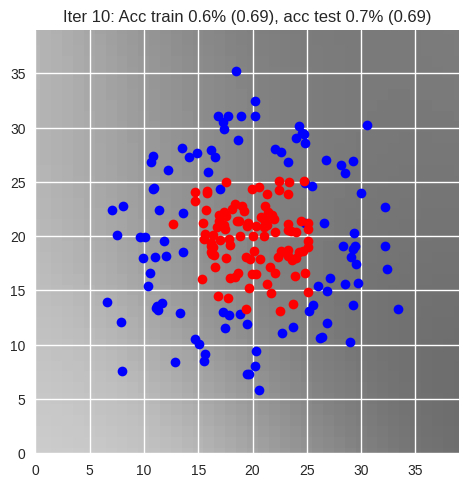

Iter 11: Acc train 0.7% (0.69), acc test 0.7% (0.69)


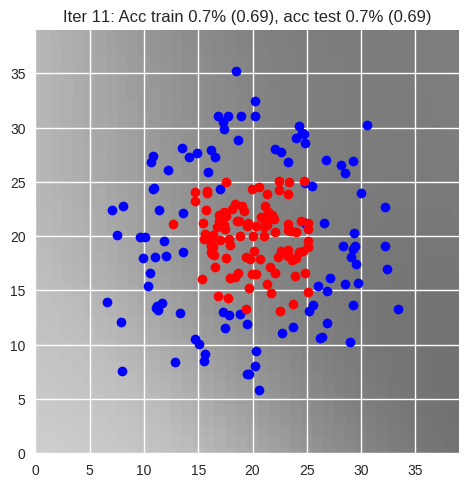

Iter 12: Acc train 0.7% (0.69), acc test 0.7% (0.69)


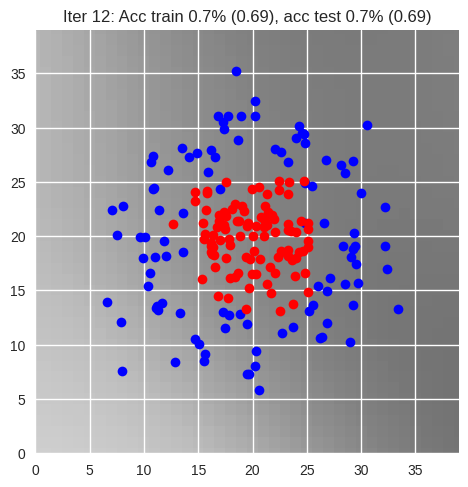

Iter 13: Acc train 0.7% (0.69), acc test 0.7% (0.69)


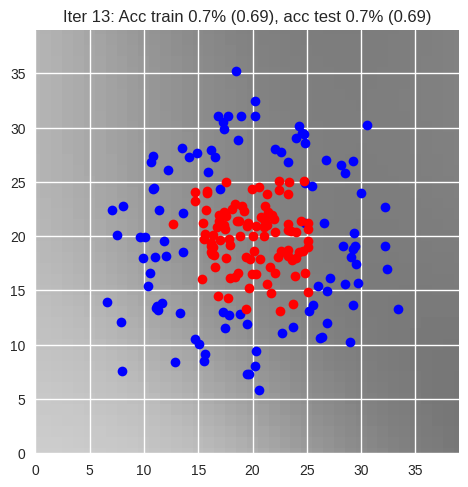

Iter 14: Acc train 0.6% (0.68), acc test 0.6% (0.69)


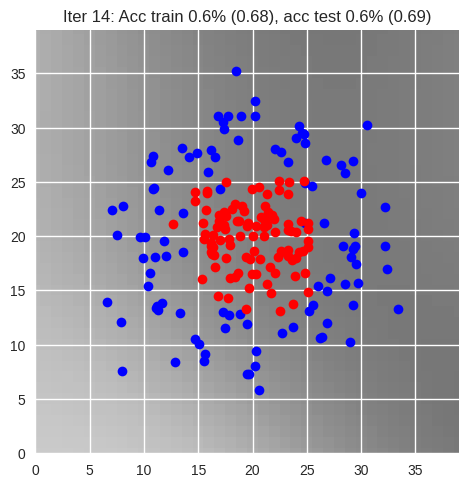

Iter 15: Acc train 0.7% (0.68), acc test 0.6% (0.69)


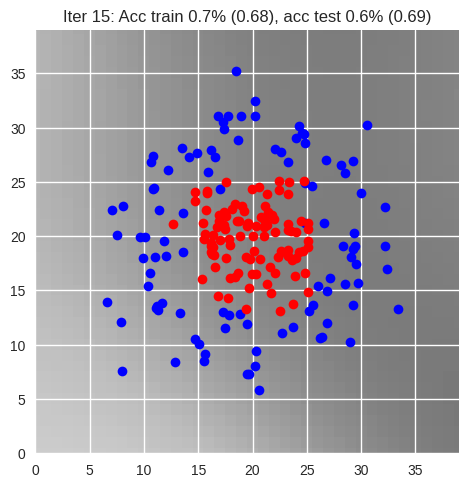

Iter 16: Acc train 0.7% (0.68), acc test 0.6% (0.69)


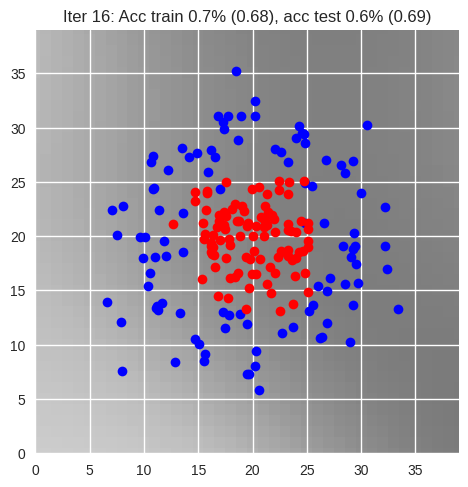

Iter 17: Acc train 0.7% (0.68), acc test 0.6% (0.68)


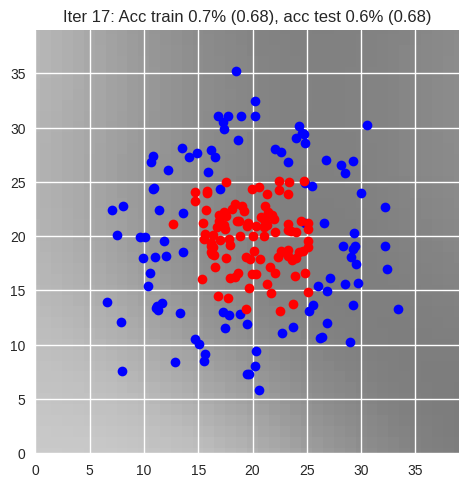

Iter 18: Acc train 0.7% (0.68), acc test 0.6% (0.68)


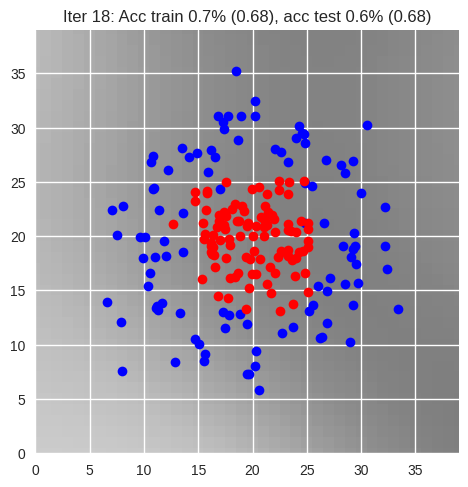

Iter 19: Acc train 0.7% (0.68), acc test 0.6% (0.68)


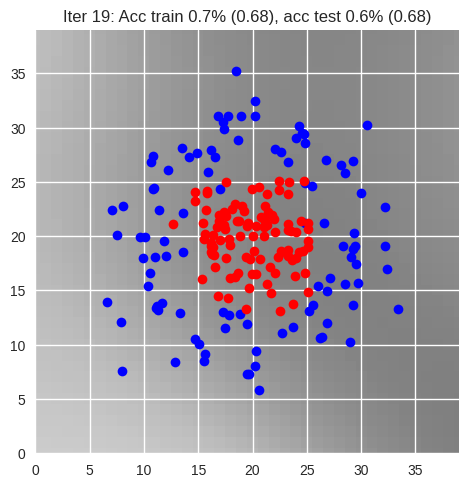

Iter 20: Acc train 0.7% (0.68), acc test 0.6% (0.68)


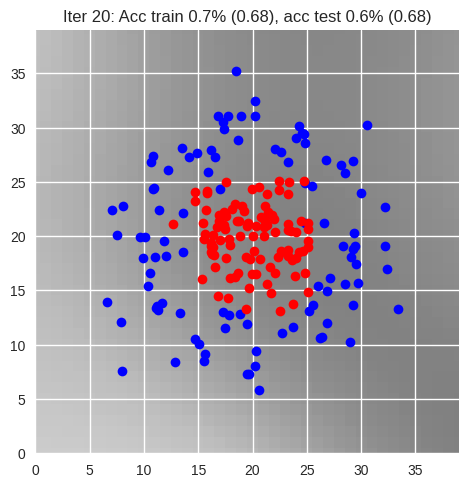

Iter 21: Acc train 0.7% (0.68), acc test 0.6% (0.68)


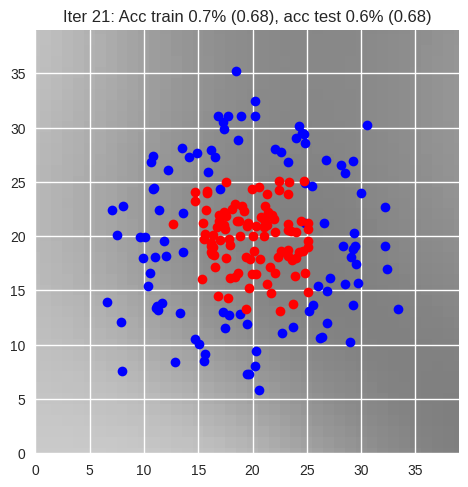

Iter 22: Acc train 0.7% (0.68), acc test 0.6% (0.68)


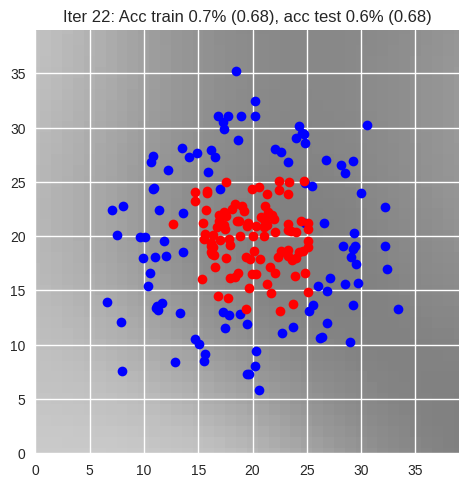

Iter 23: Acc train 0.7% (0.68), acc test 0.6% (0.68)


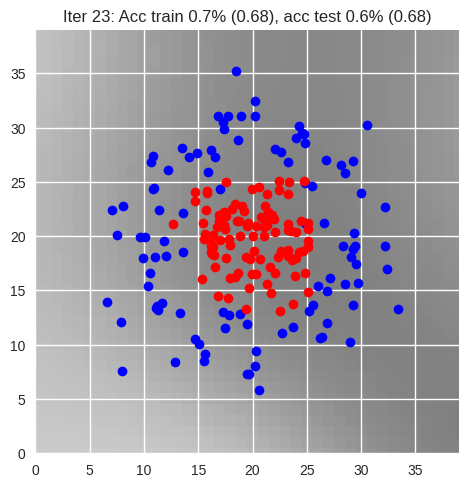

Iter 24: Acc train 0.7% (0.68), acc test 0.6% (0.68)


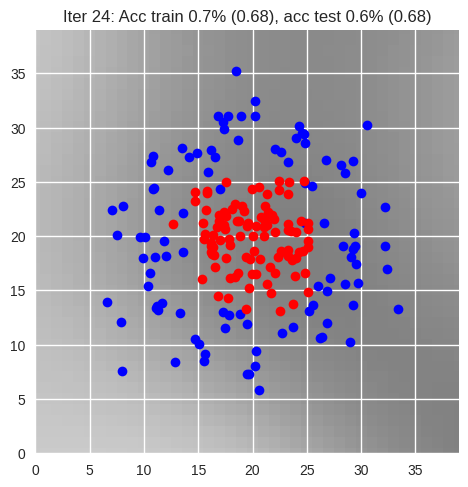

Iter 25: Acc train 0.7% (0.68), acc test 0.6% (0.68)


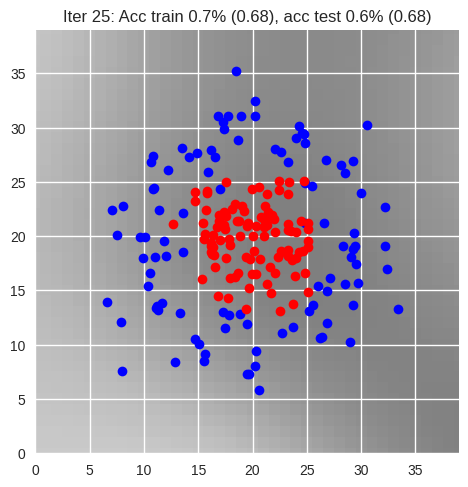

Iter 26: Acc train 0.6% (0.68), acc test 0.6% (0.68)


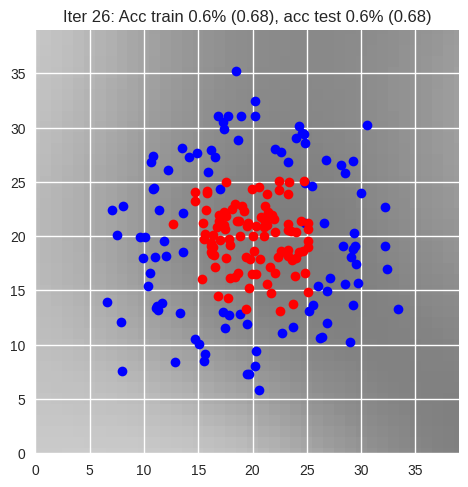

Iter 27: Acc train 0.7% (0.68), acc test 0.6% (0.68)


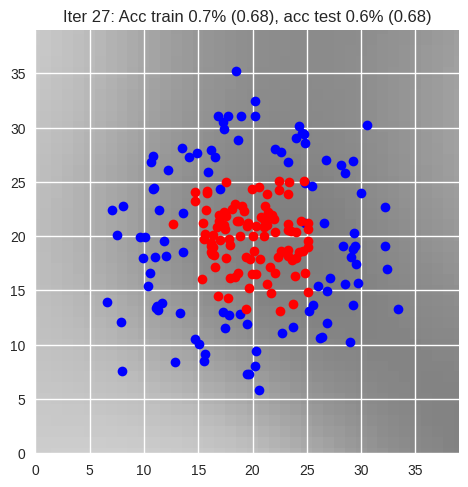

Iter 28: Acc train 0.7% (0.68), acc test 0.7% (0.68)


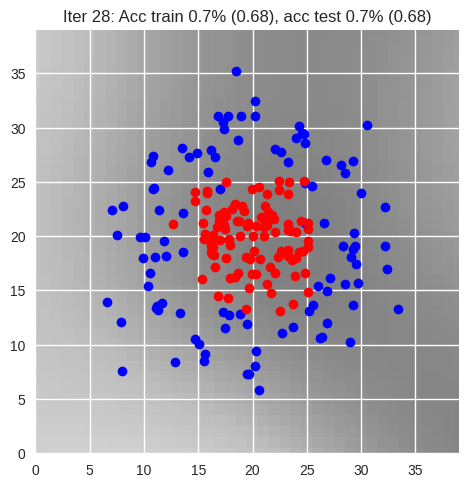

Iter 29: Acc train 0.7% (0.68), acc test 0.6% (0.68)


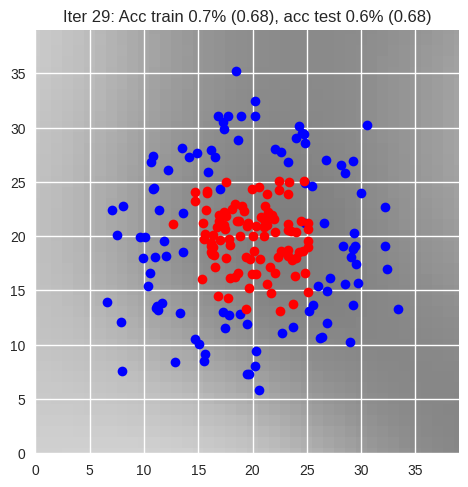

Iter 30: Acc train 0.7% (0.67), acc test 0.6% (0.68)


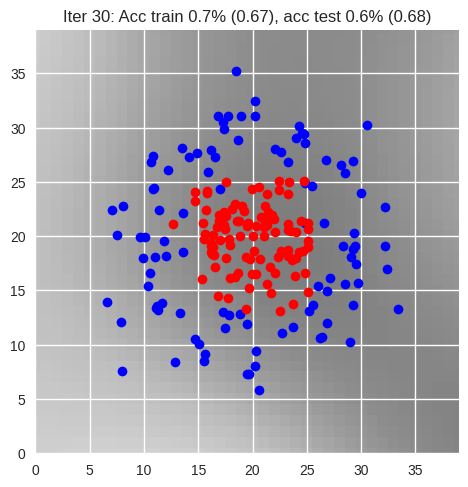

Iter 31: Acc train 0.7% (0.67), acc test 0.6% (0.68)


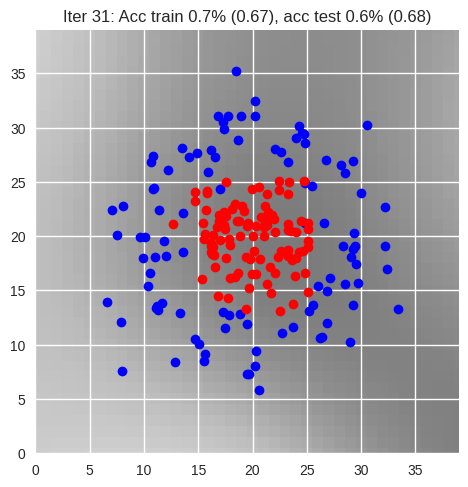

Iter 32: Acc train 0.6% (0.67), acc test 0.6% (0.67)


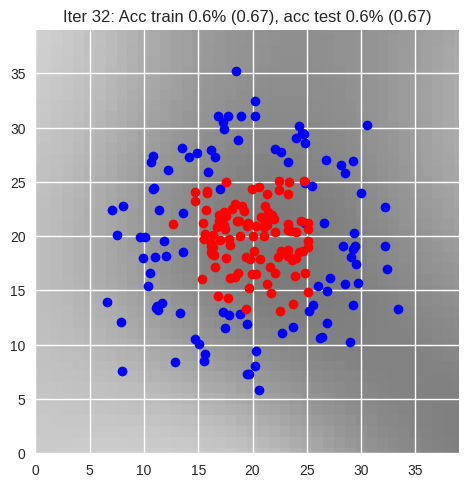

Iter 33: Acc train 0.7% (0.67), acc test 0.6% (0.67)


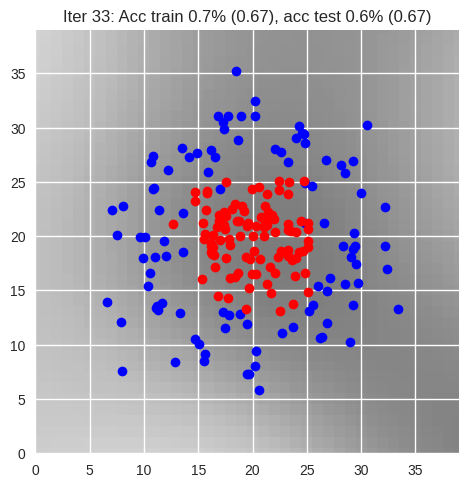

Iter 34: Acc train 0.7% (0.67), acc test 0.7% (0.67)


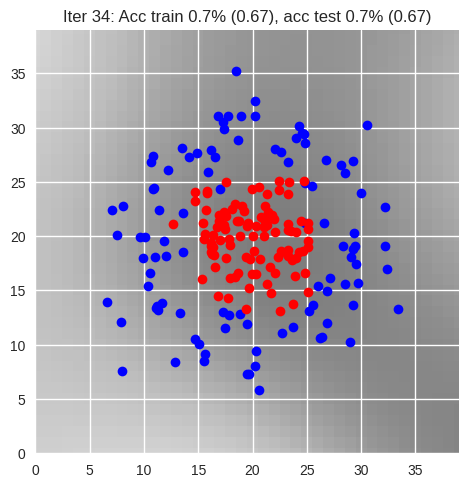

Iter 35: Acc train 0.7% (0.67), acc test 0.6% (0.67)


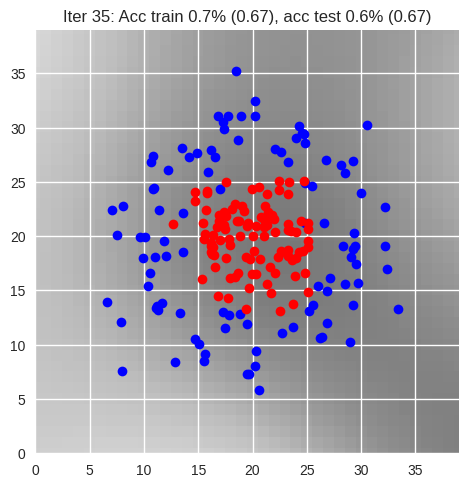

Iter 36: Acc train 0.7% (0.67), acc test 0.6% (0.67)


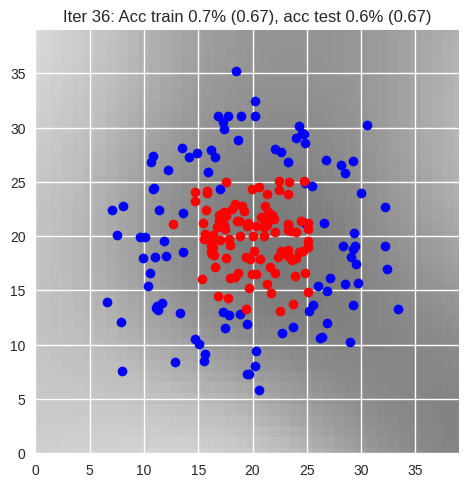

Iter 37: Acc train 0.7% (0.67), acc test 0.7% (0.67)


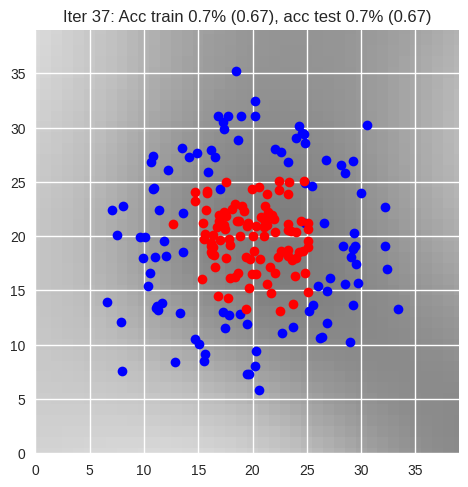

Iter 38: Acc train 0.7% (0.67), acc test 0.7% (0.67)


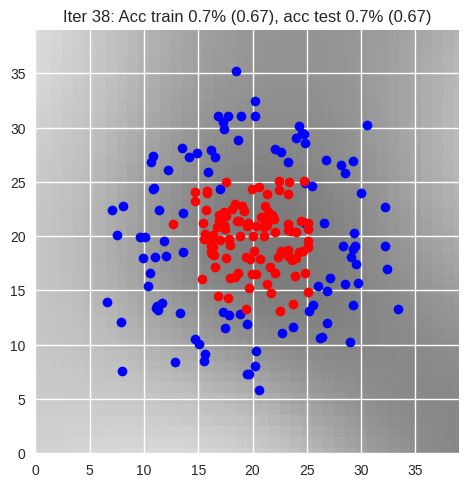

Iter 39: Acc train 0.7% (0.67), acc test 0.7% (0.67)


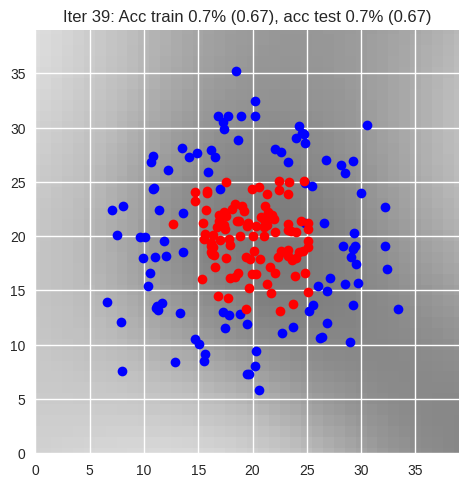

Iter 40: Acc train 0.7% (0.67), acc test 0.7% (0.67)


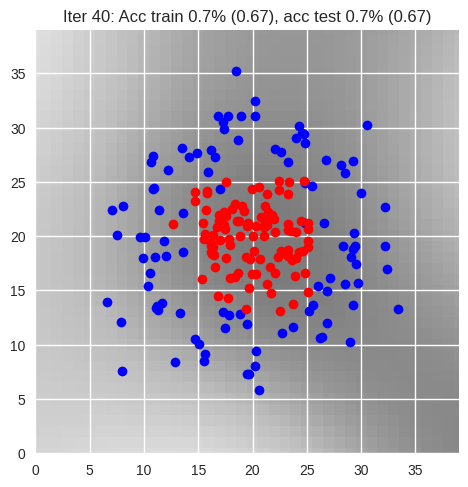

Iter 41: Acc train 0.8% (0.66), acc test 0.8% (0.67)


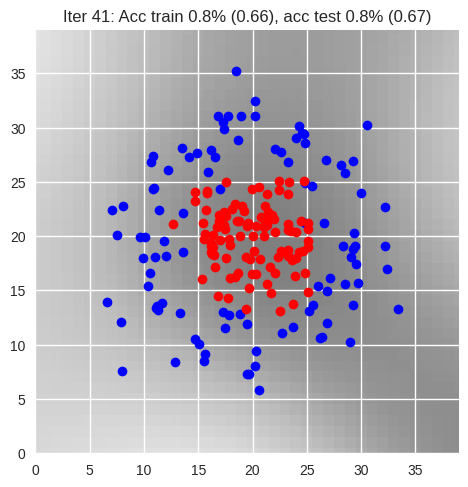

Iter 42: Acc train 0.7% (0.66), acc test 0.7% (0.66)


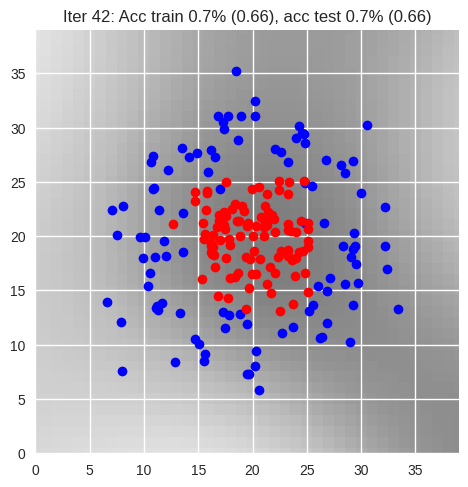

Iter 43: Acc train 0.7% (0.66), acc test 0.7% (0.66)


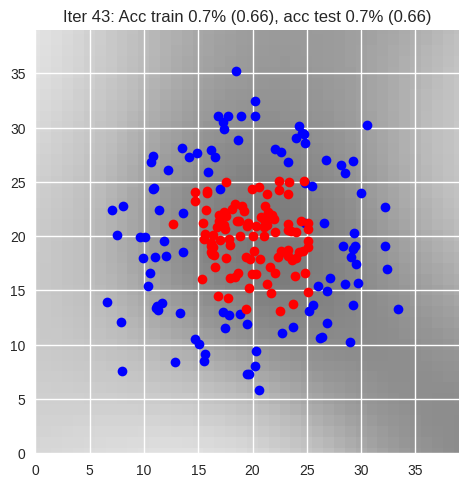

Iter 44: Acc train 0.7% (0.66), acc test 0.7% (0.66)


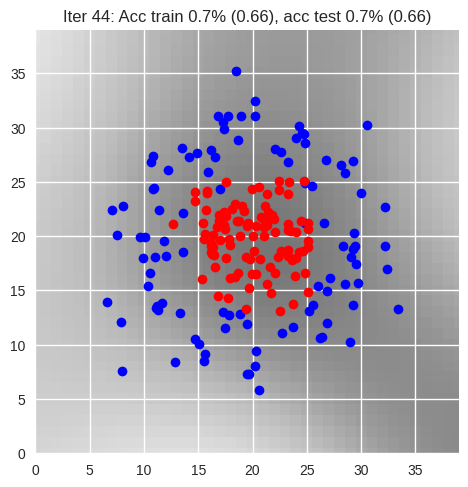

Iter 45: Acc train 0.7% (0.66), acc test 0.7% (0.66)


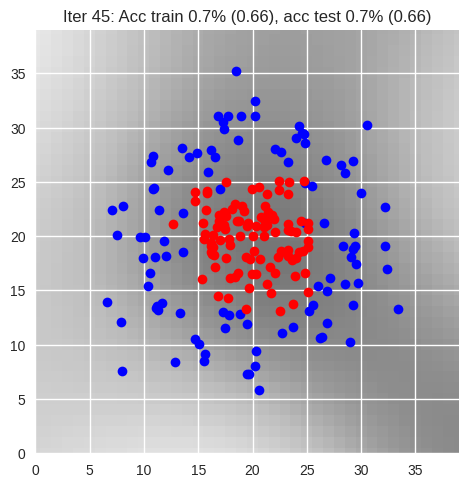

Iter 46: Acc train 0.8% (0.66), acc test 0.8% (0.66)


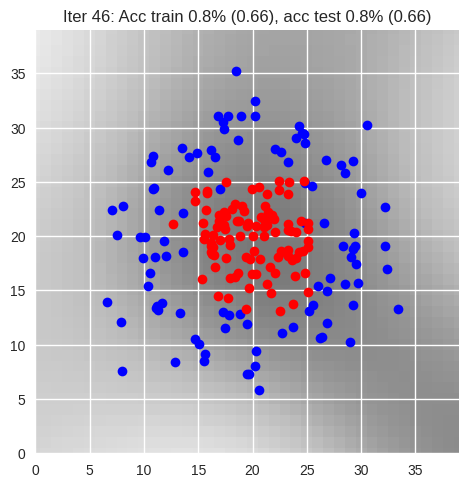

Iter 47: Acc train 0.7% (0.66), acc test 0.7% (0.66)


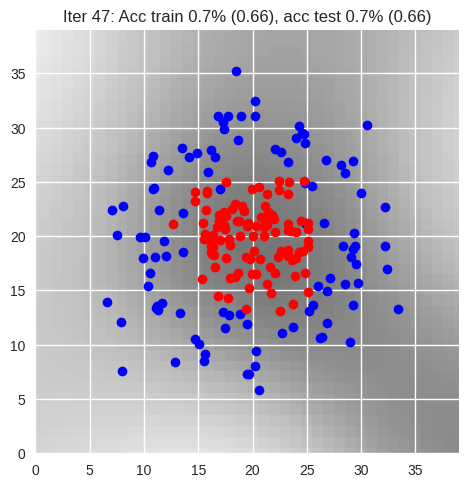

Iter 48: Acc train 0.8% (0.66), acc test 0.8% (0.66)


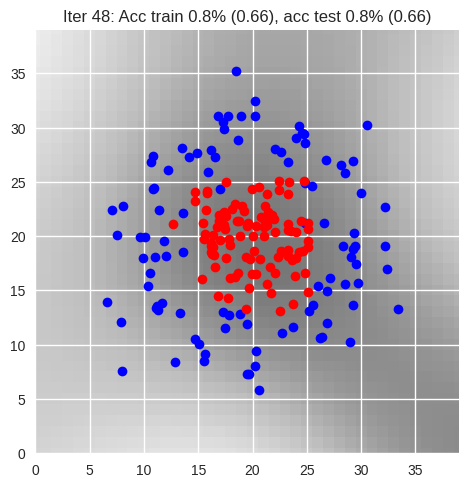

Iter 49: Acc train 0.8% (0.66), acc test 0.8% (0.66)


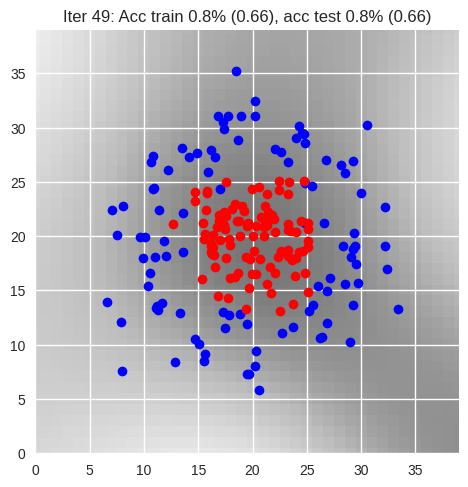

Iter 50: Acc train 0.8% (0.65), acc test 0.8% (0.66)


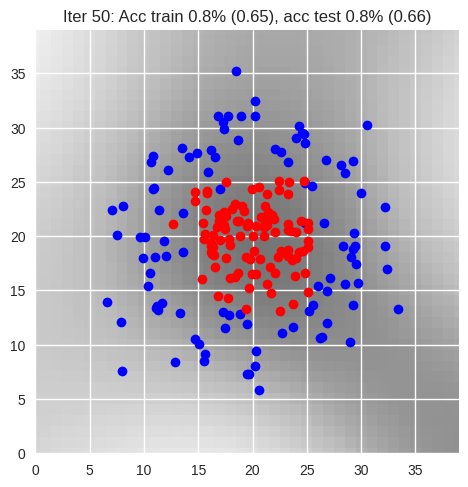

Iter 51: Acc train 0.8% (0.65), acc test 0.8% (0.65)


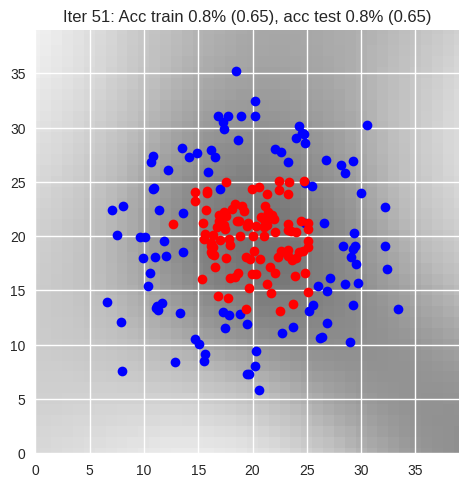

Iter 52: Acc train 0.8% (0.65), acc test 0.8% (0.65)


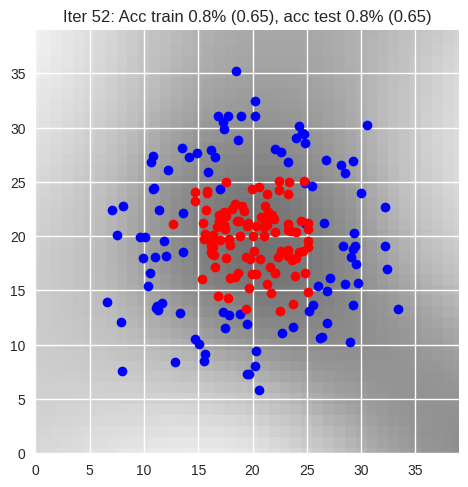

Iter 53: Acc train 0.8% (0.65), acc test 0.8% (0.65)


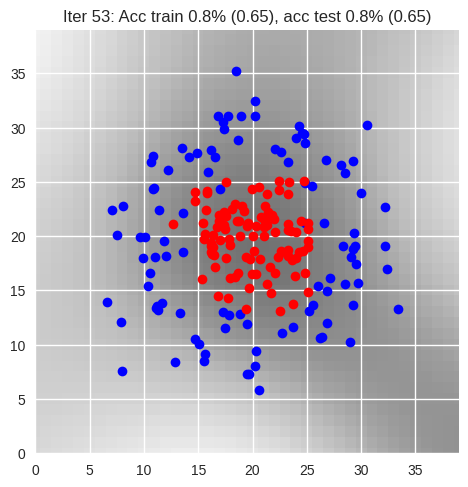

Iter 54: Acc train 0.8% (0.65), acc test 0.8% (0.65)


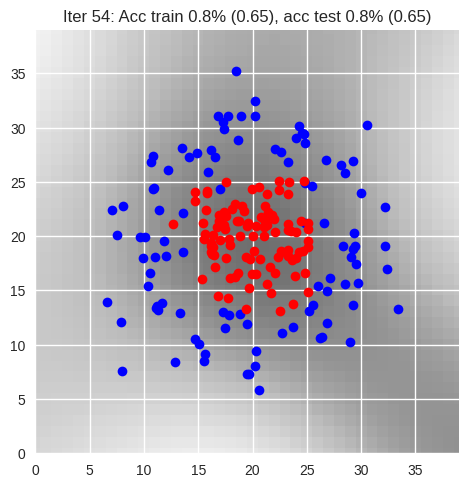

Iter 55: Acc train 0.8% (0.65), acc test 0.8% (0.65)


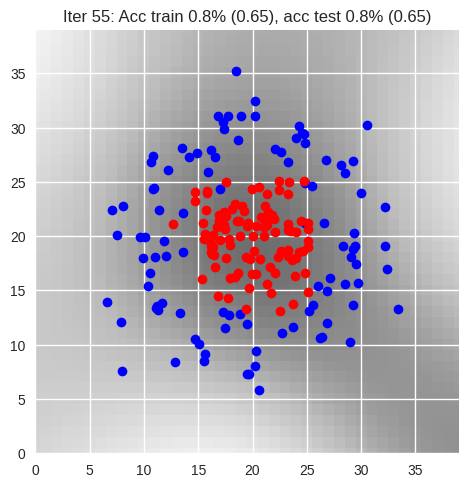

Iter 56: Acc train 0.8% (0.65), acc test 0.8% (0.65)


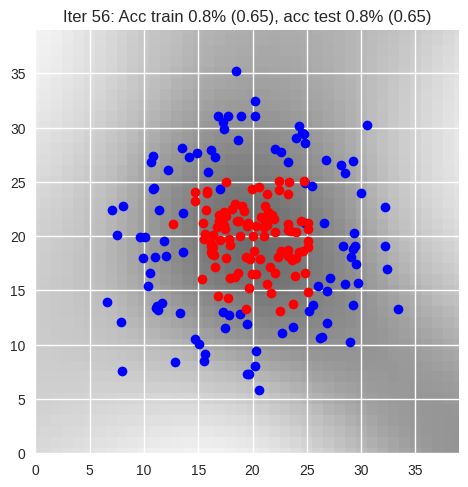

Iter 57: Acc train 0.8% (0.64), acc test 0.8% (0.65)


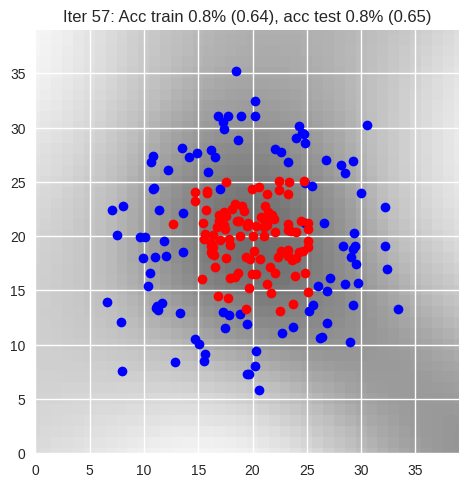

Iter 58: Acc train 0.8% (0.64), acc test 0.8% (0.64)


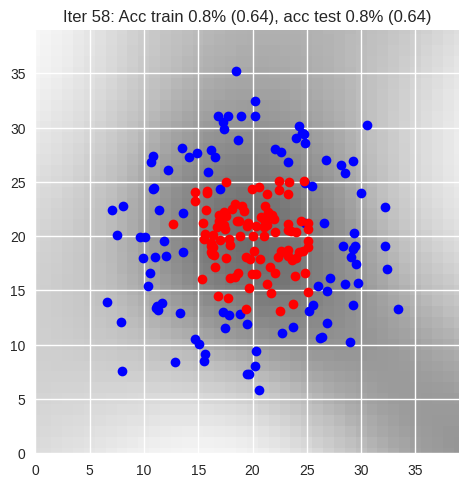

Iter 59: Acc train 0.8% (0.64), acc test 0.8% (0.64)


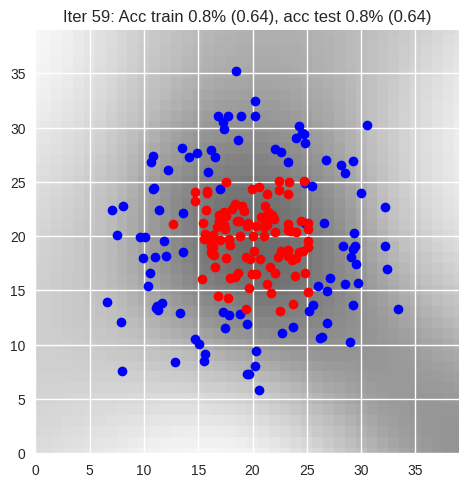

Iter 60: Acc train 0.8% (0.64), acc test 0.8% (0.64)


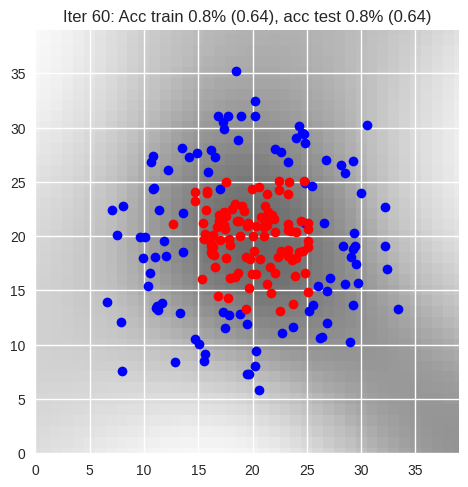

Iter 61: Acc train 0.8% (0.64), acc test 0.8% (0.64)


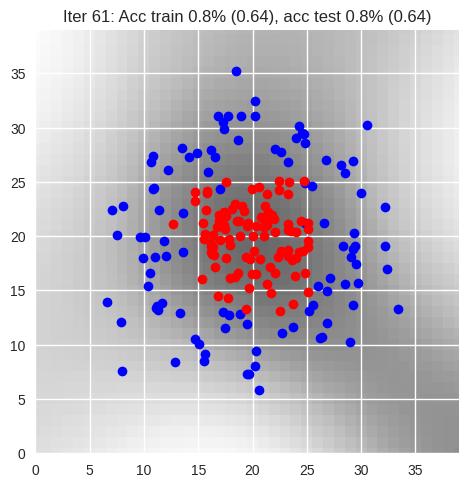

Iter 62: Acc train 0.8% (0.64), acc test 0.8% (0.64)


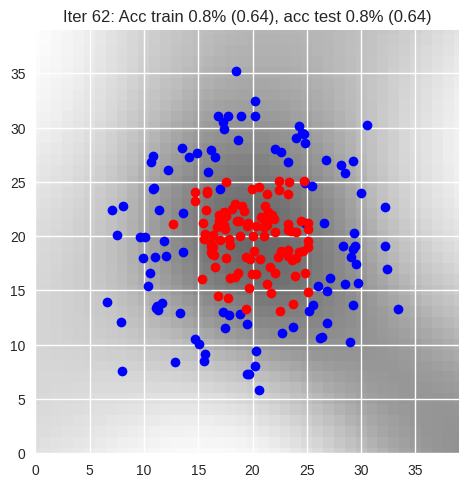

Iter 63: Acc train 0.8% (0.63), acc test 0.8% (0.64)


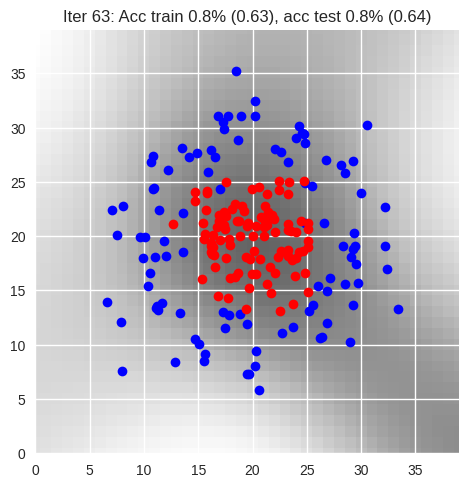

Iter 64: Acc train 0.7% (0.63), acc test 0.8% (0.63)


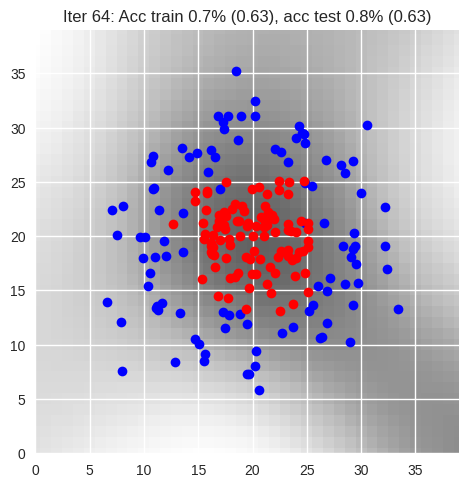

Iter 65: Acc train 0.8% (0.63), acc test 0.8% (0.63)


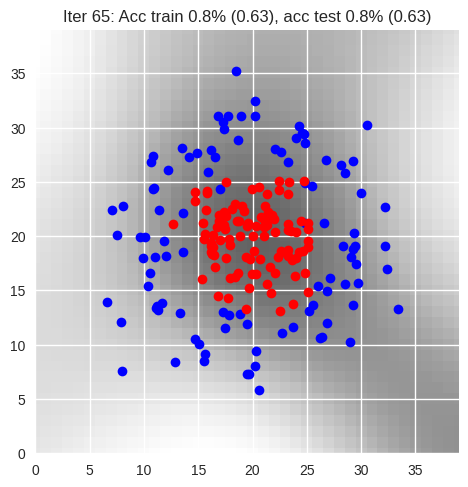

Iter 66: Acc train 0.8% (0.63), acc test 0.8% (0.63)


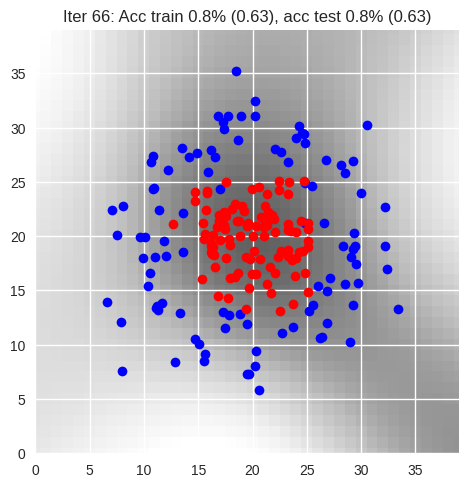

Iter 67: Acc train 0.8% (0.63), acc test 0.8% (0.63)


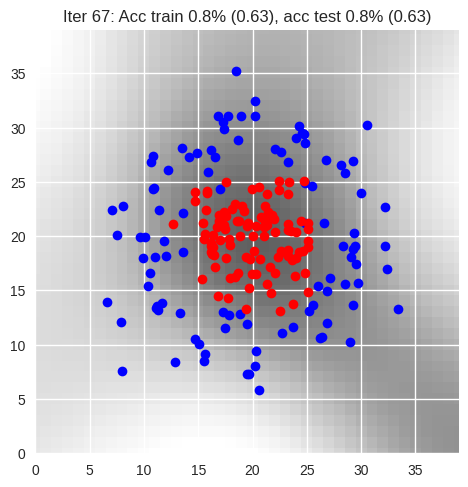

Iter 68: Acc train 0.8% (0.62), acc test 0.8% (0.63)


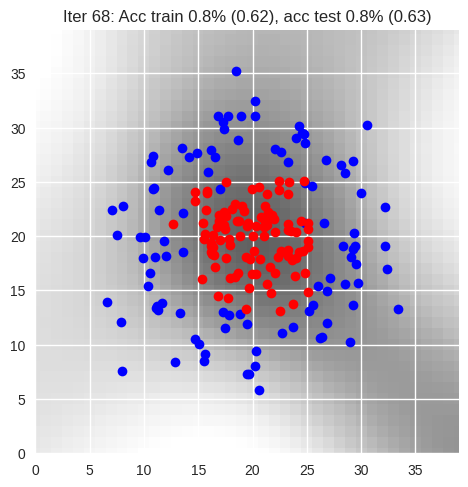

Iter 69: Acc train 0.8% (0.62), acc test 0.8% (0.62)


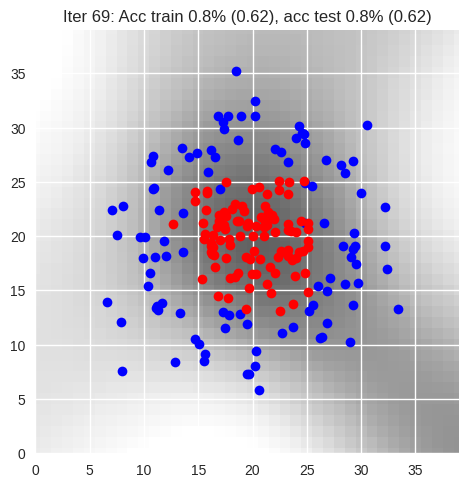

Iter 70: Acc train 0.8% (0.62), acc test 0.8% (0.62)


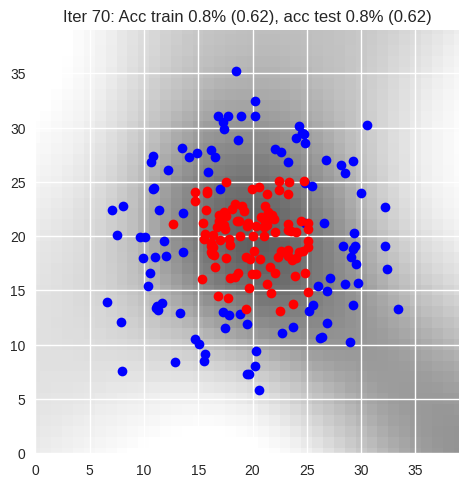

Iter 71: Acc train 0.8% (0.62), acc test 0.8% (0.62)


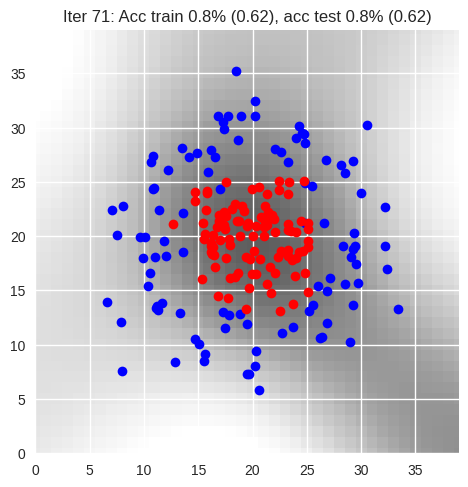

Iter 72: Acc train 0.8% (0.62), acc test 0.8% (0.62)


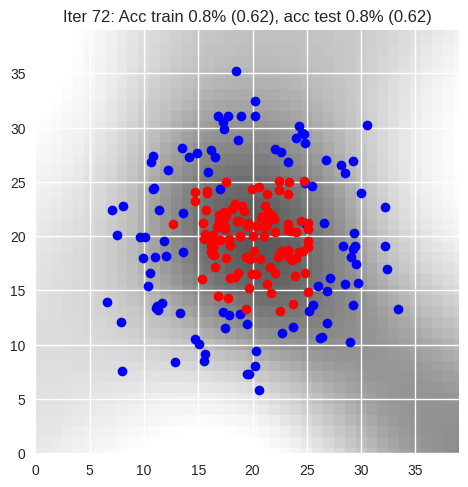

Iter 73: Acc train 0.8% (0.61), acc test 0.9% (0.62)


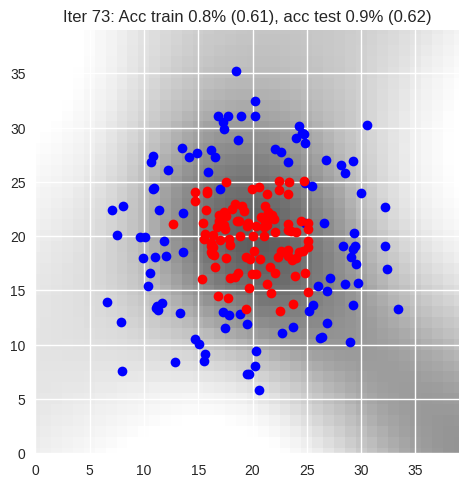

Iter 74: Acc train 0.8% (0.61), acc test 0.9% (0.61)


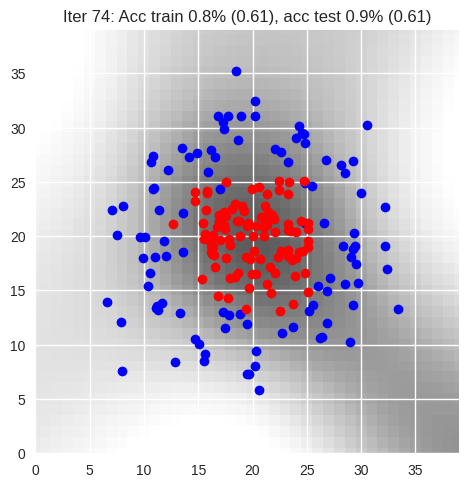

Iter 75: Acc train 0.8% (0.61), acc test 0.8% (0.61)


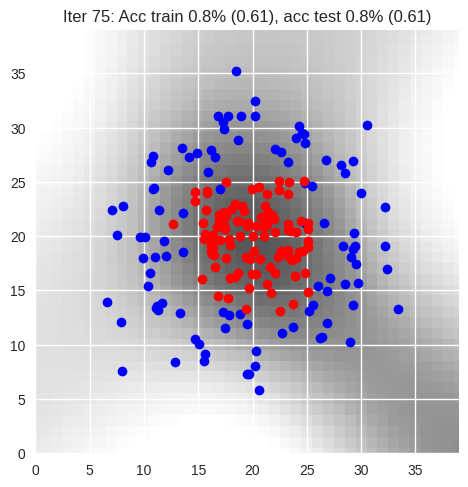

Iter 76: Acc train 0.8% (0.61), acc test 0.8% (0.61)


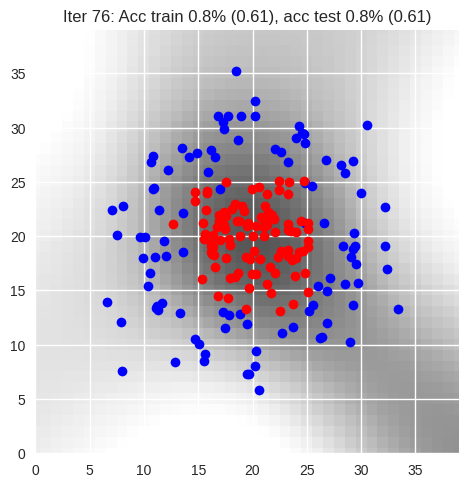

Iter 77: Acc train 0.8% (0.60), acc test 0.8% (0.61)


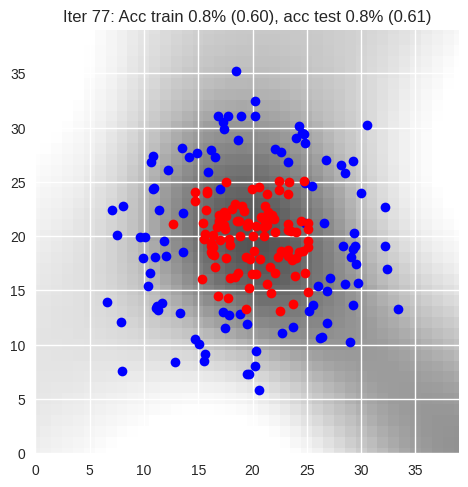

Iter 78: Acc train 0.8% (0.60), acc test 0.9% (0.60)


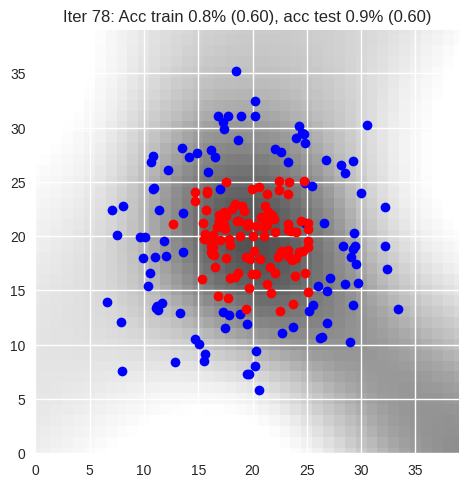

Iter 79: Acc train 0.8% (0.60), acc test 0.9% (0.60)


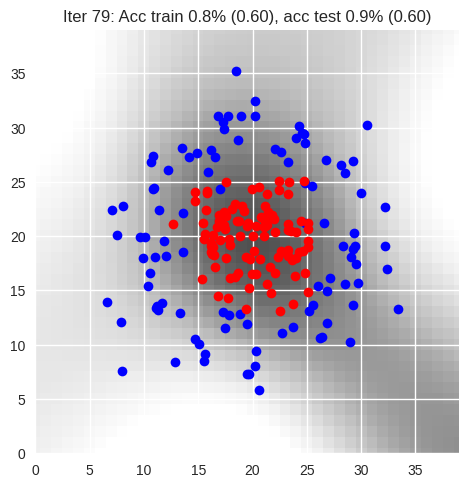

Iter 80: Acc train 0.8% (0.60), acc test 0.8% (0.60)


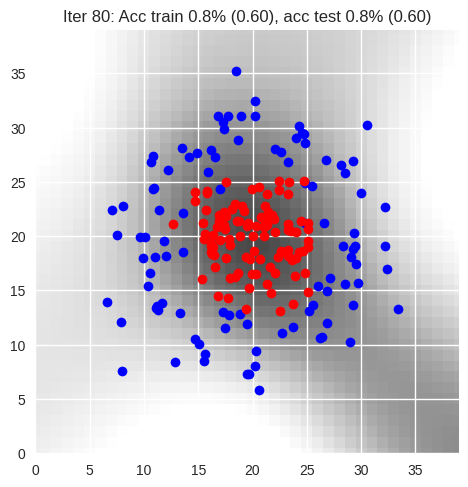

Iter 81: Acc train 0.8% (0.59), acc test 0.8% (0.60)


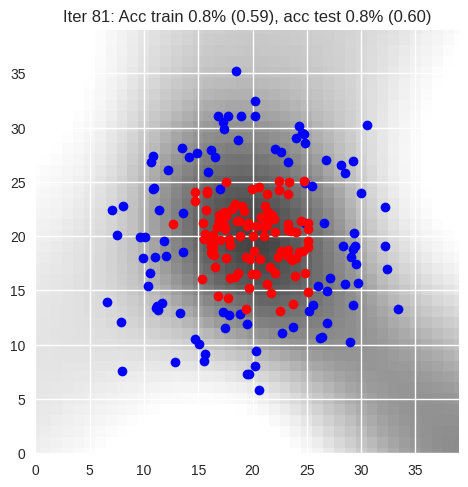

Iter 82: Acc train 0.8% (0.59), acc test 0.8% (0.59)


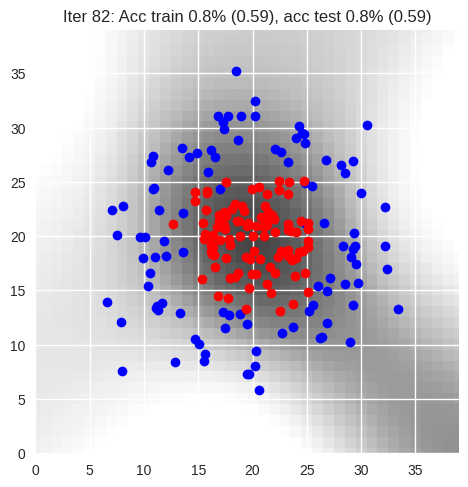

Iter 83: Acc train 0.8% (0.59), acc test 0.8% (0.59)


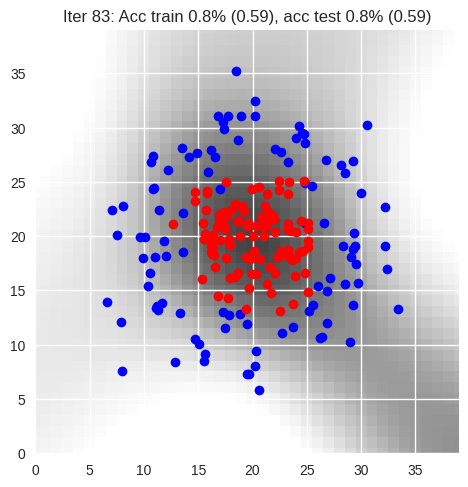

Iter 84: Acc train 0.8% (0.59), acc test 0.9% (0.59)


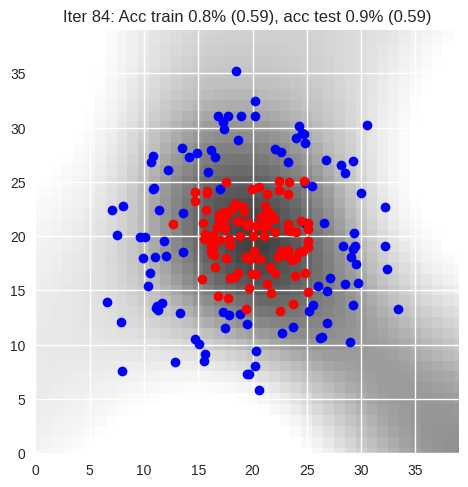

Iter 85: Acc train 0.8% (0.58), acc test 0.9% (0.58)


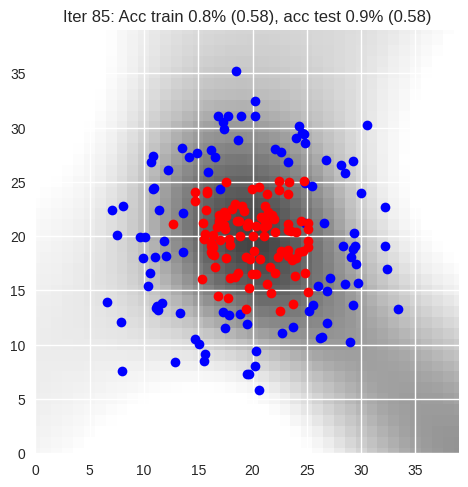

Iter 86: Acc train 0.9% (0.58), acc test 0.9% (0.58)


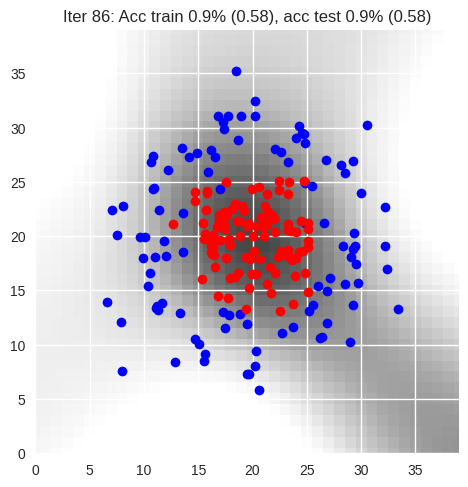

Iter 87: Acc train 0.9% (0.58), acc test 0.9% (0.58)


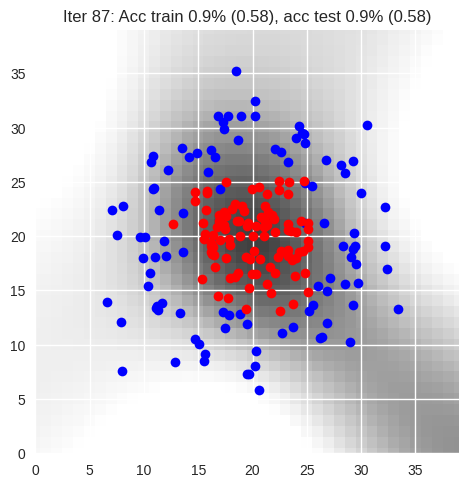

Iter 88: Acc train 0.8% (0.57), acc test 0.9% (0.58)


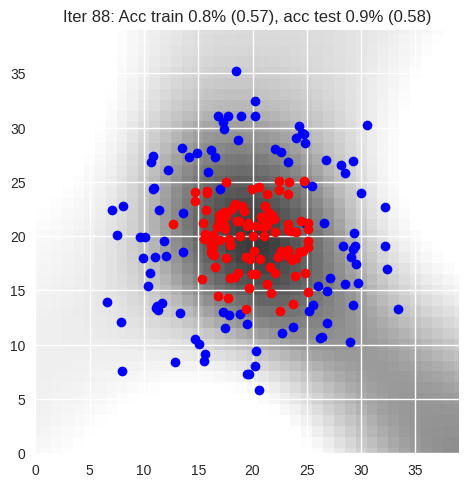

Iter 89: Acc train 0.8% (0.57), acc test 0.9% (0.57)


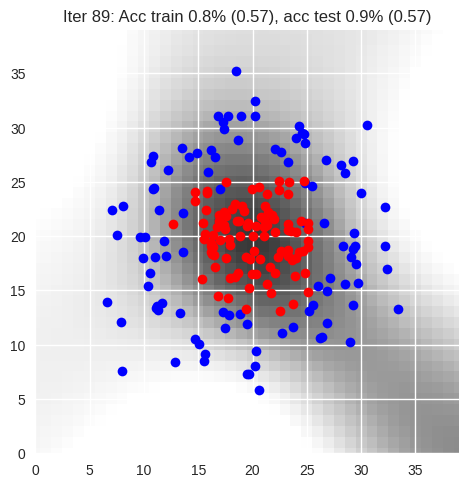

Iter 90: Acc train 0.8% (0.57), acc test 0.9% (0.57)


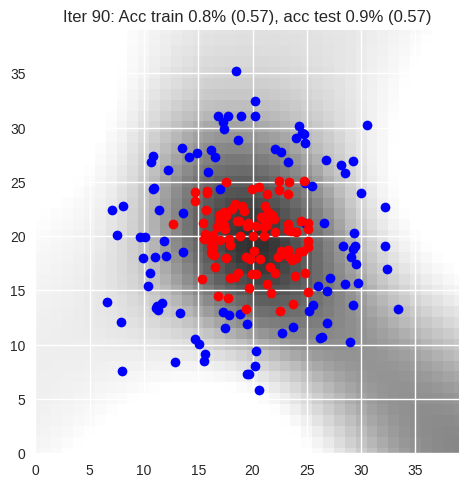

Iter 91: Acc train 0.8% (0.57), acc test 0.9% (0.57)


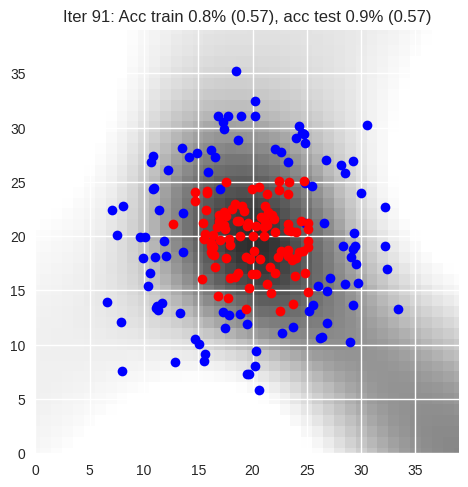

Iter 92: Acc train 0.8% (0.56), acc test 0.9% (0.56)


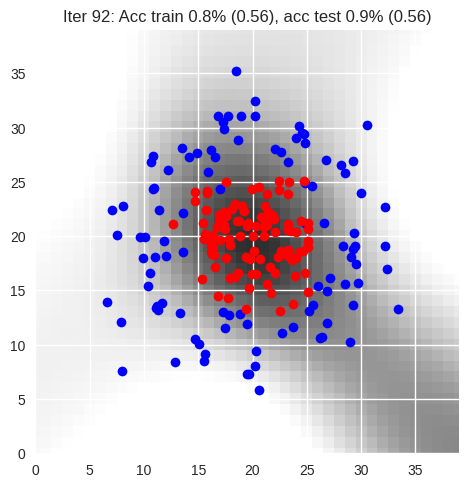

Iter 93: Acc train 0.8% (0.56), acc test 0.9% (0.56)


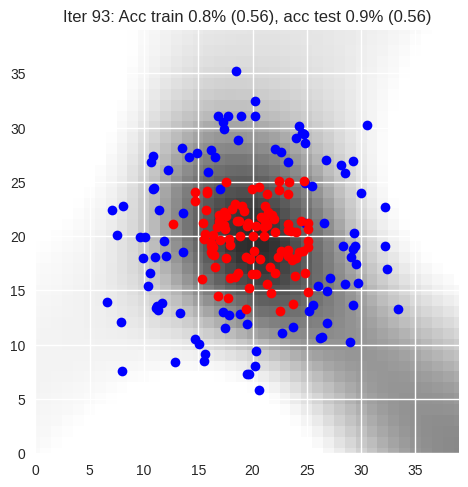

Iter 94: Acc train 0.8% (0.56), acc test 0.9% (0.56)


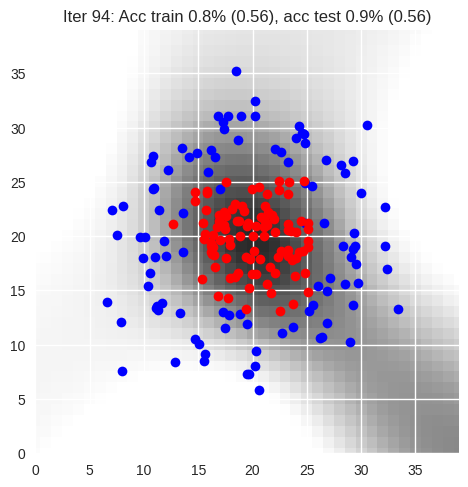

Iter 95: Acc train 0.8% (0.55), acc test 0.9% (0.56)


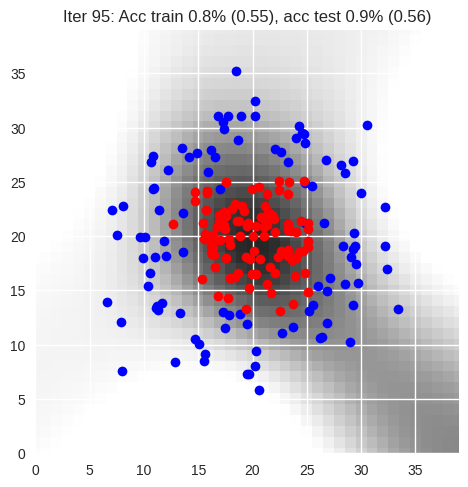

Iter 96: Acc train 0.8% (0.55), acc test 0.9% (0.55)


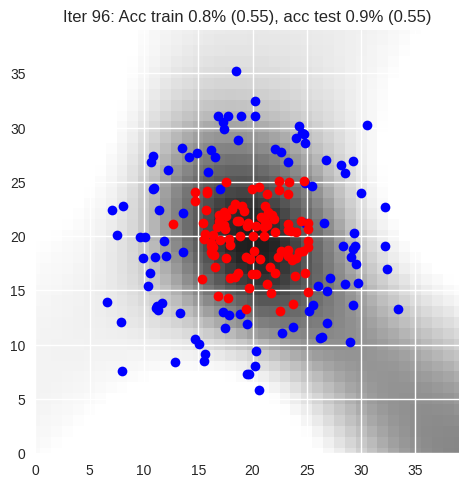

Iter 97: Acc train 0.8% (0.55), acc test 0.9% (0.55)


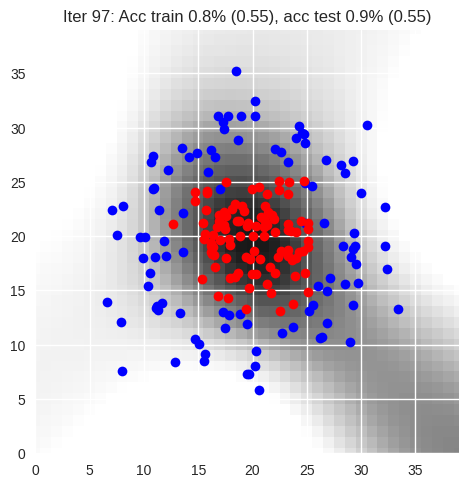

Iter 98: Acc train 0.8% (0.54), acc test 0.9% (0.55)


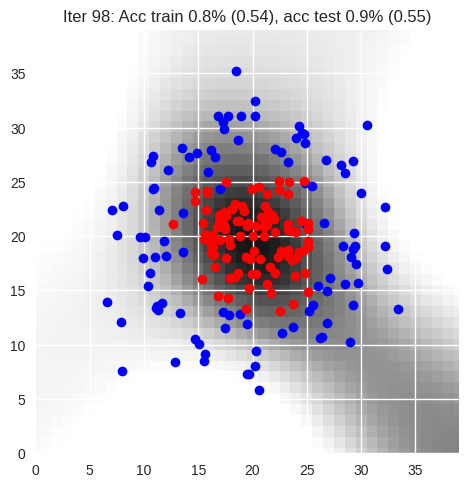

Iter 99: Acc train 0.8% (0.54), acc test 0.9% (0.54)


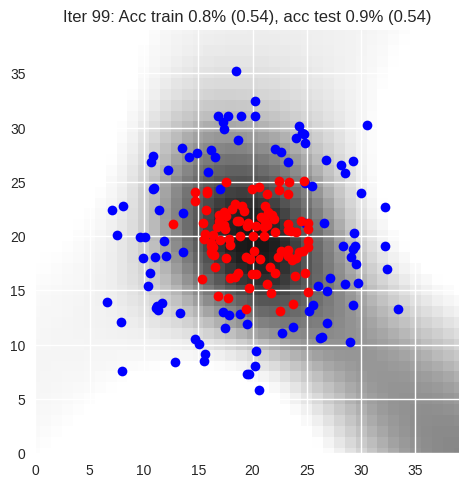

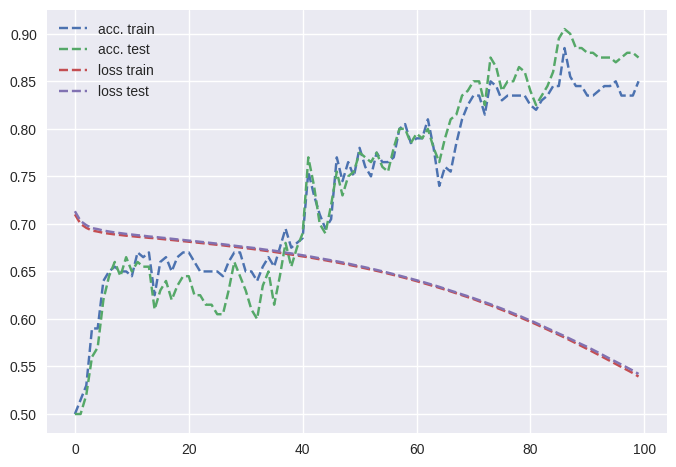

In [23]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 16
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]
iterations = 100

# epoch
for iteration in range(iterations):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy, sgd
        # the forward with the predict method from the model
        # and the backward function with autograd

        outputs = model(X)

        # using the functions: loss_accuracy
        batch_loss, accuracy = loss_accuracy(nn.CrossEntropyLoss(), outputs, Y)

        # the backward function with autograd
        grad = torch.autograd.backward(batch_loss)

        # Update the network weights using SGD
        params = sgd(model, eta)

        # Accumulate training loss and accuracy
        train_loss += batch_loss.item()
        train_accuracy += accuracy

    ####################
    ##      END        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltrain = Ltrain.item()
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ltest = Ltest.item()
    Ygrid = model(data.Xgrid)

    #torch.nn.Softmax()(Ygrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 4 : Simplification of the SGD with `torch.optim`

In [24]:
def init_model(nx, nh, ny, eta):

    #####################
    ## Your code here  ##
    #####################

    model = simpleNN(input_size = nx, hidden_size=nh, output_size=ny)
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(), lr=eta, momentum=0.9)

    ####################
    ##      END        #
    ####################

    return model, loss, optim

The `sgd` function is replaced by calling the `optim.zero_grad()` before the backward and `optim.step()` after.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

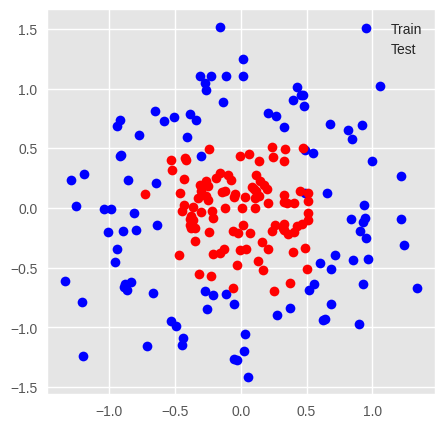

Iter 0: Acc train 0.5% (0.69), acc test 0.5% (0.69)


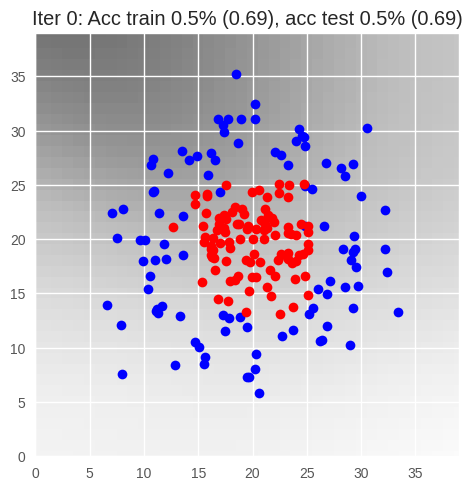

Iter 1: Acc train 0.5% (0.68), acc test 0.5% (0.68)


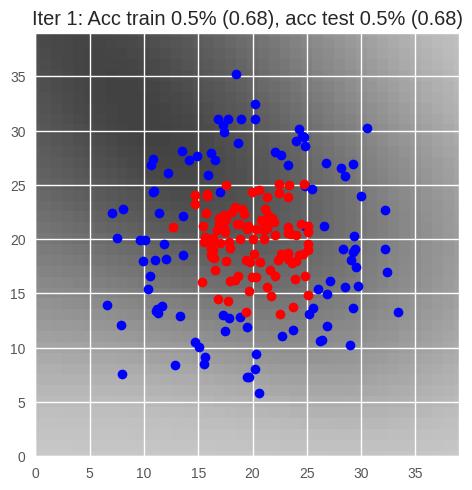

Iter 2: Acc train 0.8% (0.66), acc test 0.7% (0.66)


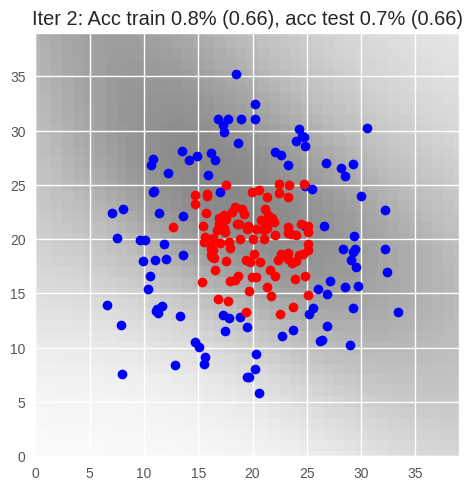

Iter 3: Acc train 0.8% (0.64), acc test 0.8% (0.64)


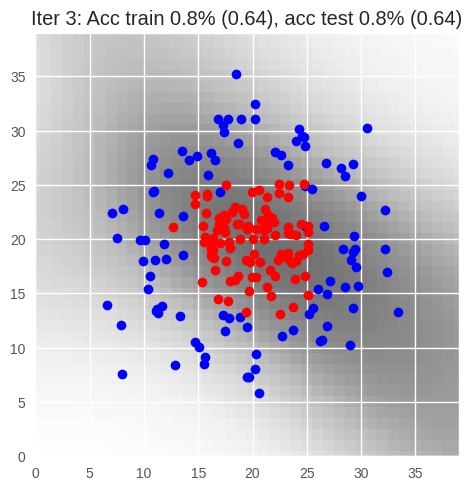

Iter 4: Acc train 0.8% (0.61), acc test 0.8% (0.61)


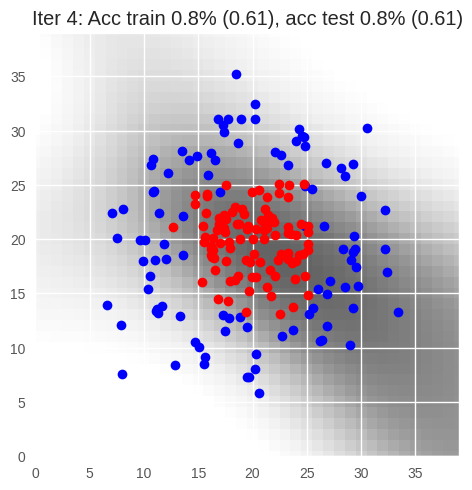

Iter 5: Acc train 0.8% (0.57), acc test 0.8% (0.58)


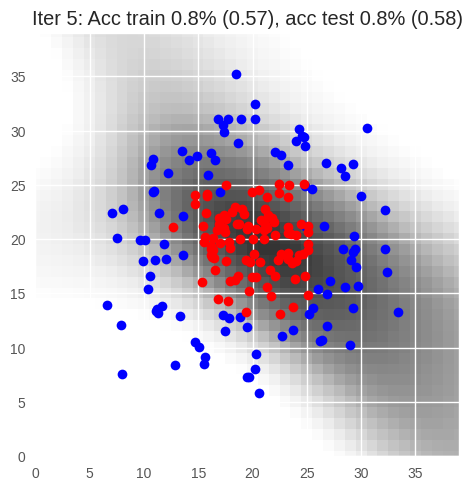

Iter 6: Acc train 0.8% (0.53), acc test 0.8% (0.54)


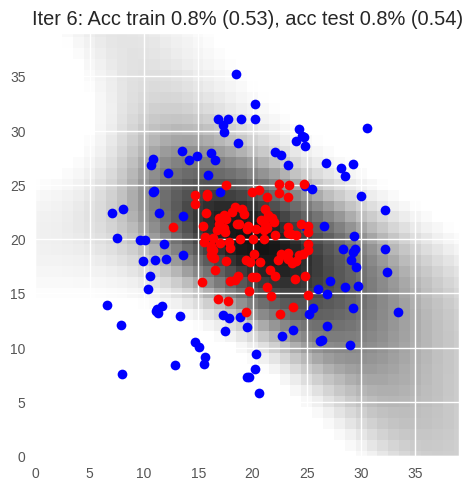

Iter 7: Acc train 0.8% (0.49), acc test 0.8% (0.50)


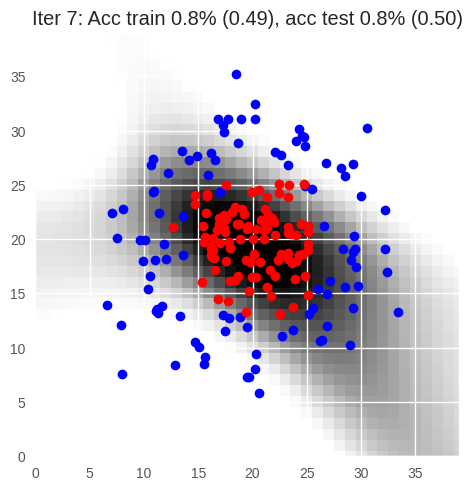

Iter 8: Acc train 0.8% (0.45), acc test 0.8% (0.46)


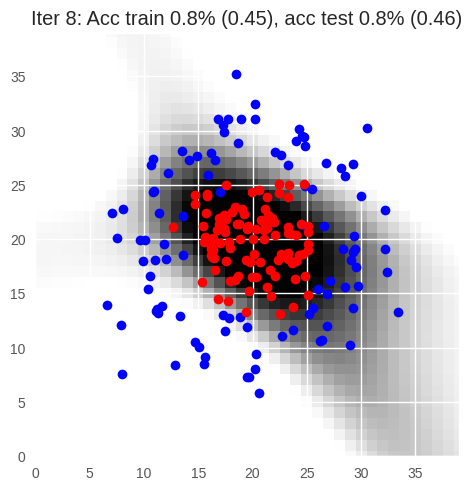

Iter 9: Acc train 0.9% (0.40), acc test 0.9% (0.42)


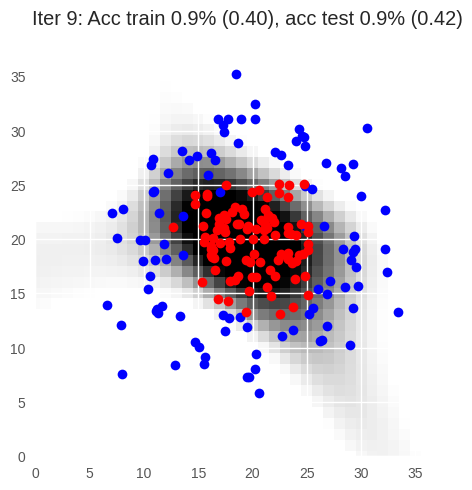

Iter 10: Acc train 0.9% (0.36), acc test 0.9% (0.38)


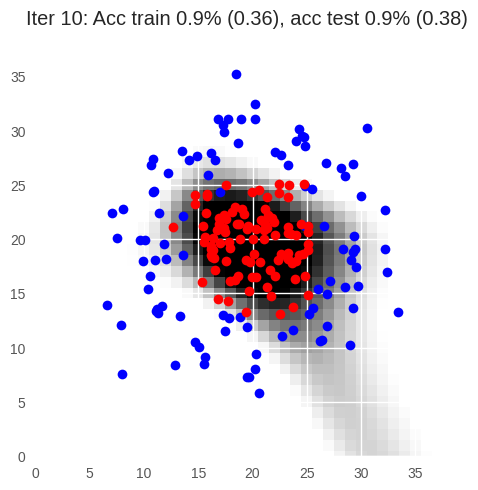

Iter 11: Acc train 0.9% (0.33), acc test 0.9% (0.34)


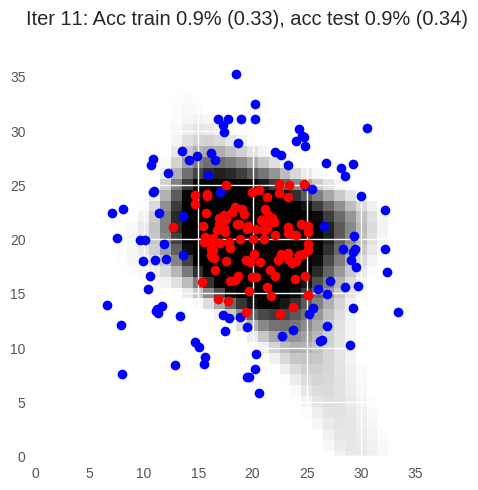

Iter 12: Acc train 0.9% (0.29), acc test 0.9% (0.31)


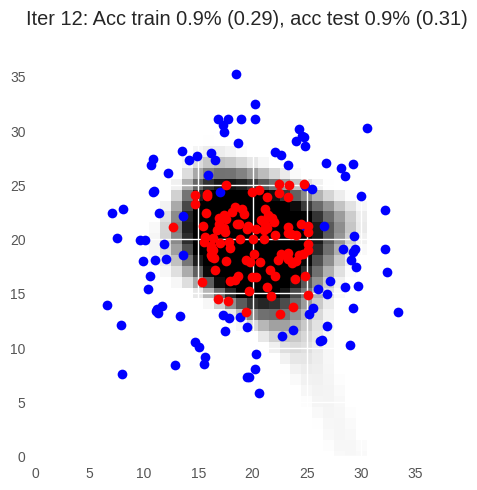

Iter 13: Acc train 0.9% (0.27), acc test 0.9% (0.29)


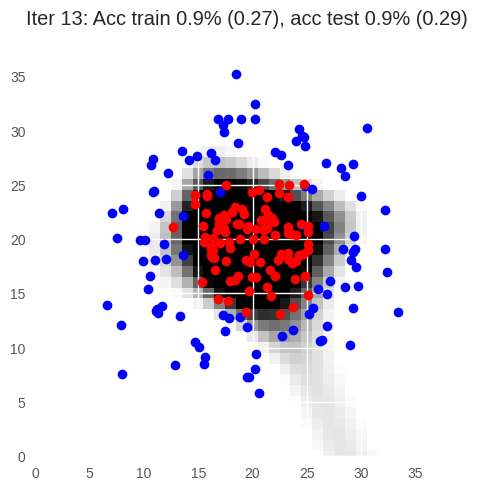

Iter 14: Acc train 0.9% (0.26), acc test 0.9% (0.27)


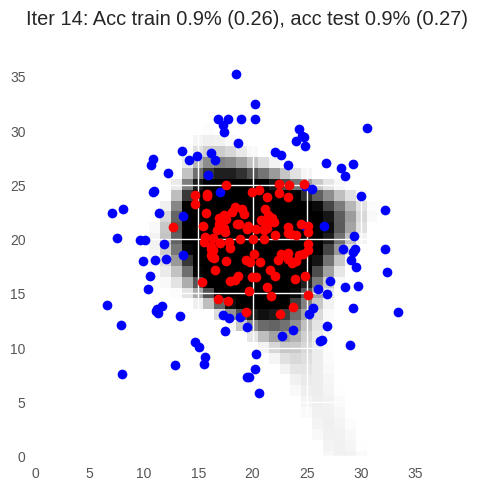

Iter 15: Acc train 1.0% (0.23), acc test 0.9% (0.25)


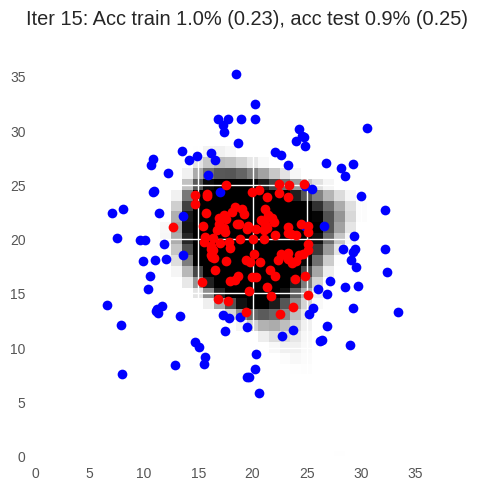

Iter 16: Acc train 0.9% (0.22), acc test 0.9% (0.24)


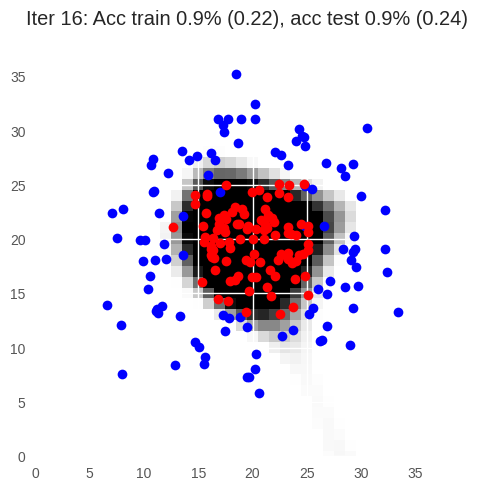

Iter 17: Acc train 0.9% (0.21), acc test 0.9% (0.23)


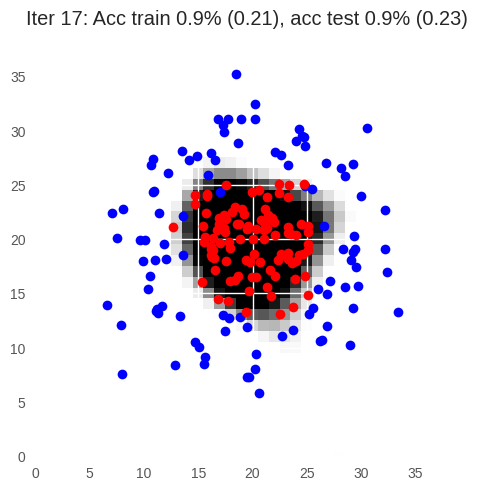

Iter 18: Acc train 1.0% (0.20), acc test 0.9% (0.22)


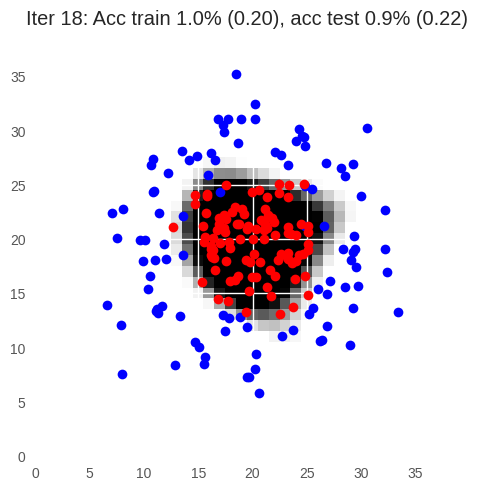

Iter 19: Acc train 0.9% (0.21), acc test 0.9% (0.22)


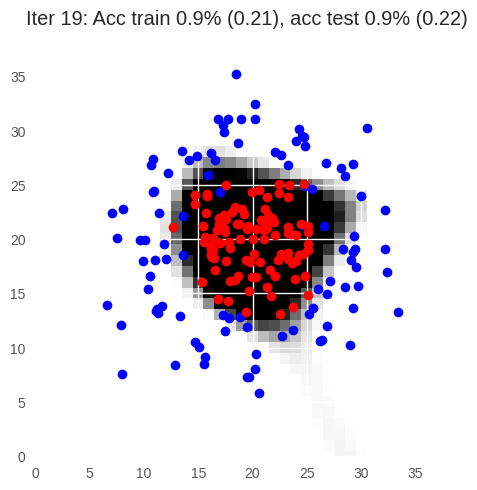

Iter 20: Acc train 0.9% (0.19), acc test 0.9% (0.22)


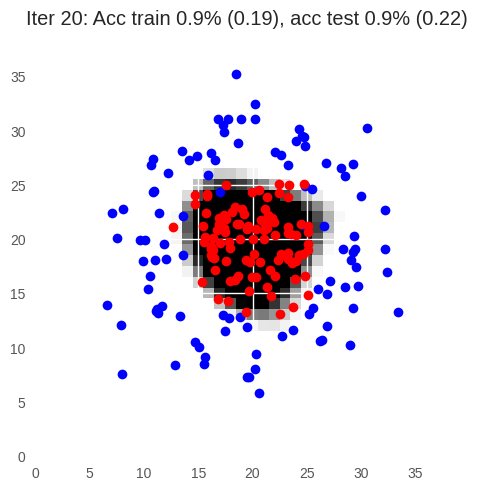

Iter 21: Acc train 0.9% (0.18), acc test 0.9% (0.20)


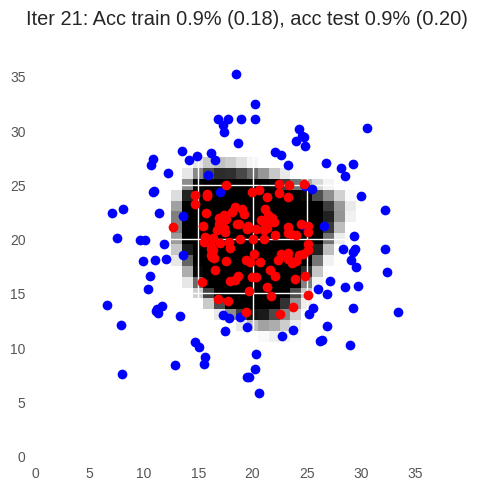

Iter 22: Acc train 0.9% (0.18), acc test 0.9% (0.21)


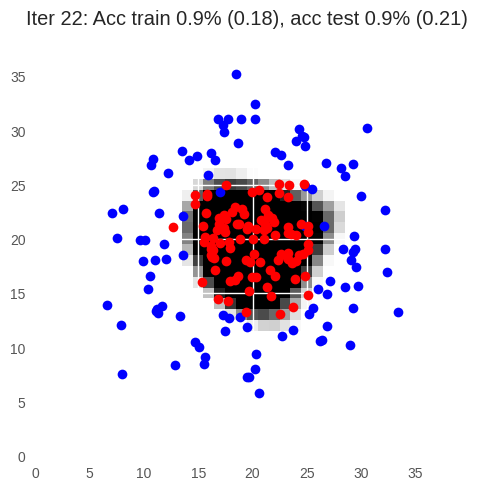

Iter 23: Acc train 0.9% (0.17), acc test 0.9% (0.19)


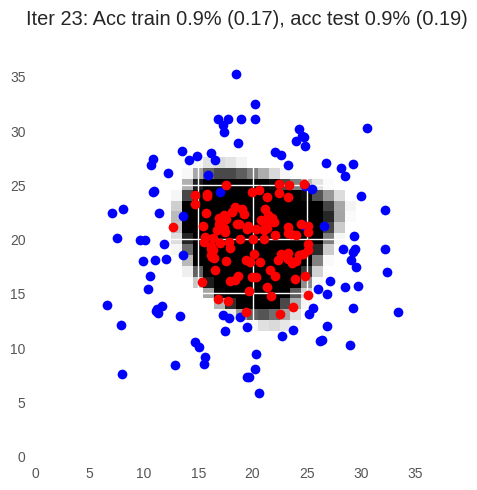

Iter 24: Acc train 0.9% (0.17), acc test 0.9% (0.18)


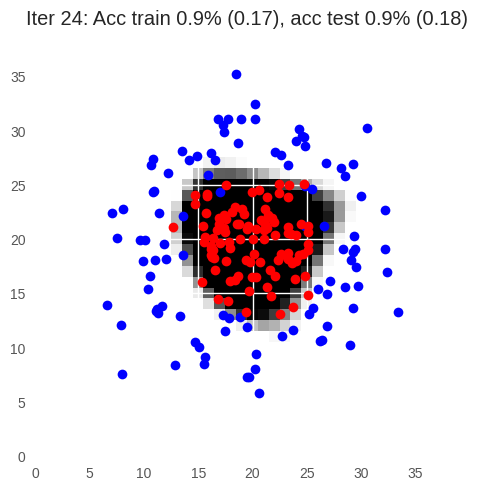

Iter 25: Acc train 0.9% (0.17), acc test 0.9% (0.20)


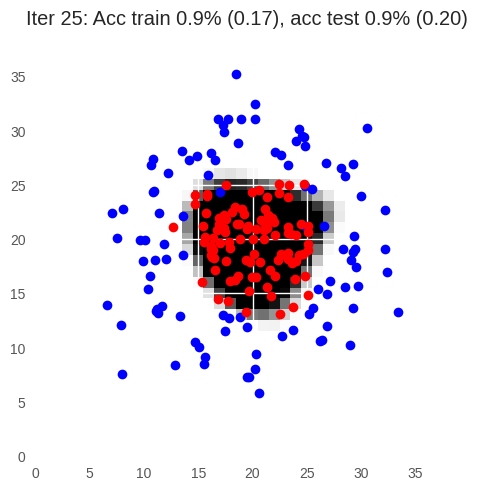

Iter 26: Acc train 1.0% (0.16), acc test 0.9% (0.18)


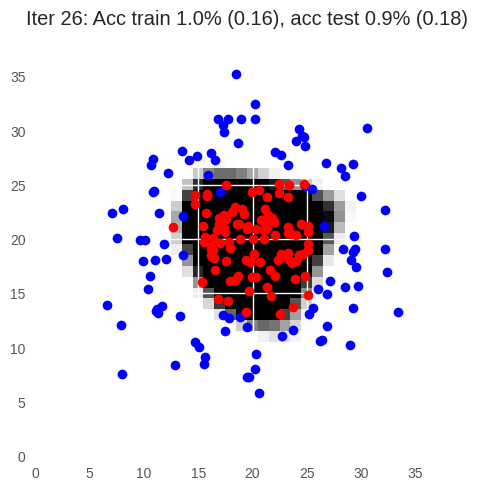

Iter 27: Acc train 1.0% (0.15), acc test 0.9% (0.18)


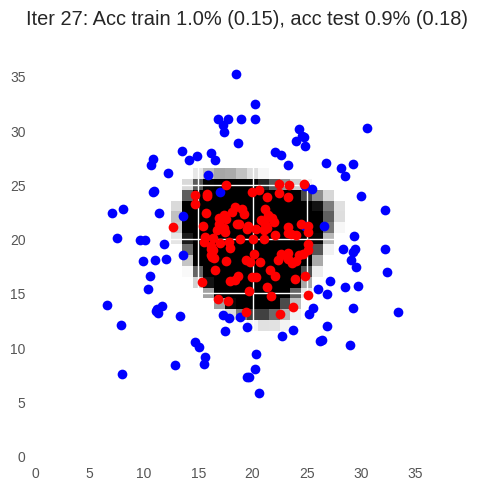

Iter 28: Acc train 1.0% (0.15), acc test 0.9% (0.18)


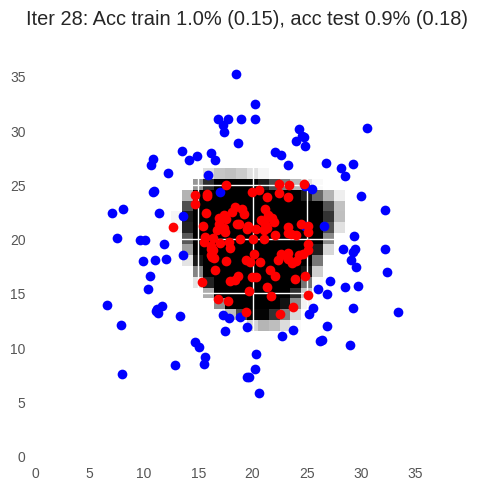

Iter 29: Acc train 0.9% (0.15), acc test 0.9% (0.17)


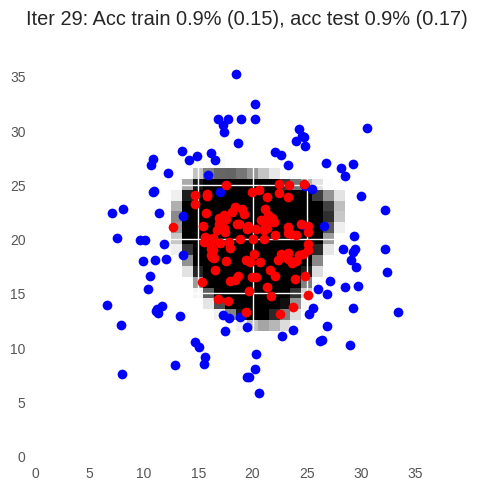

Iter 30: Acc train 0.9% (0.16), acc test 0.9% (0.19)


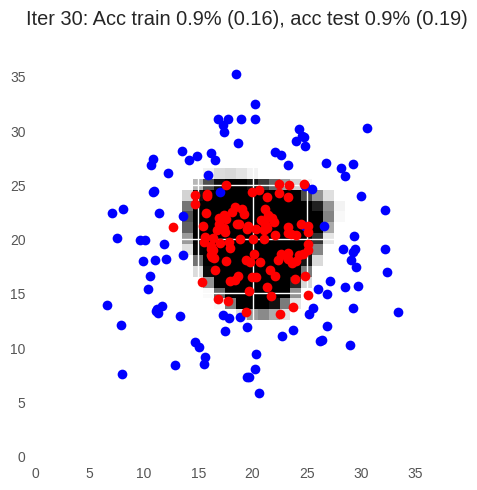

Iter 31: Acc train 0.9% (0.15), acc test 0.9% (0.18)


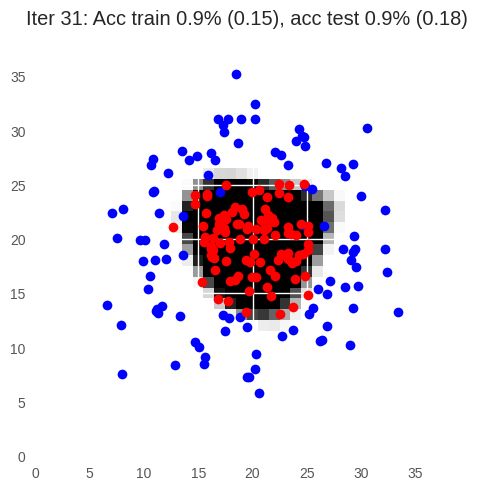

Iter 32: Acc train 0.9% (0.14), acc test 0.9% (0.17)


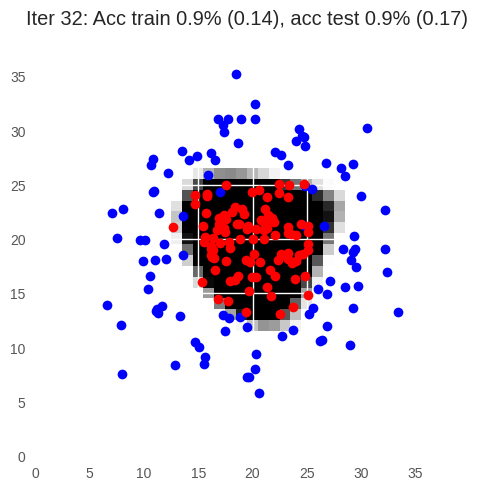

Iter 33: Acc train 0.9% (0.14), acc test 0.9% (0.18)


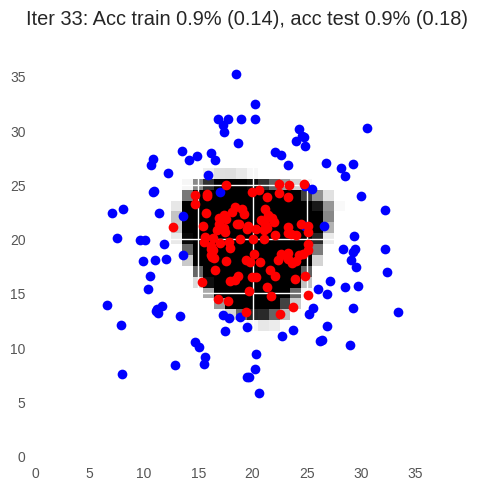

Iter 34: Acc train 0.9% (0.14), acc test 0.9% (0.17)


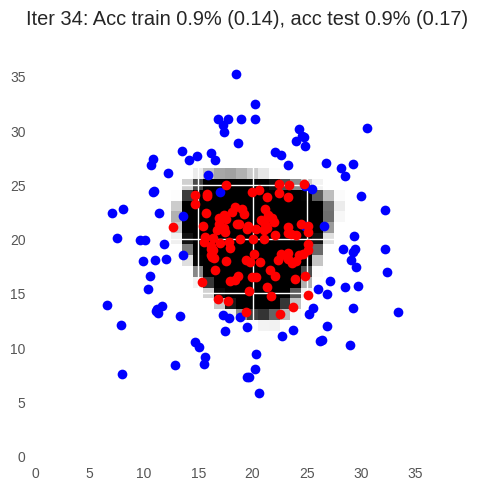

Iter 35: Acc train 0.9% (0.14), acc test 0.9% (0.17)


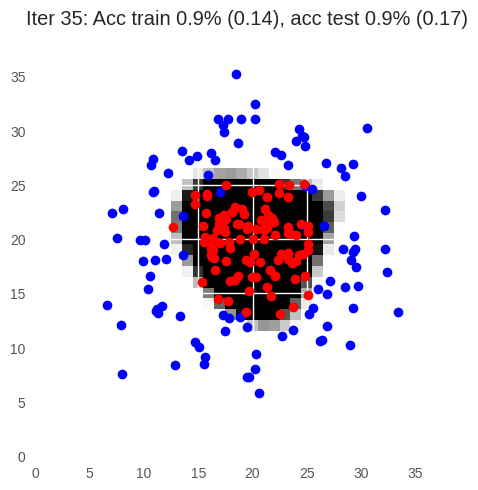

Iter 36: Acc train 1.0% (0.14), acc test 0.9% (0.17)


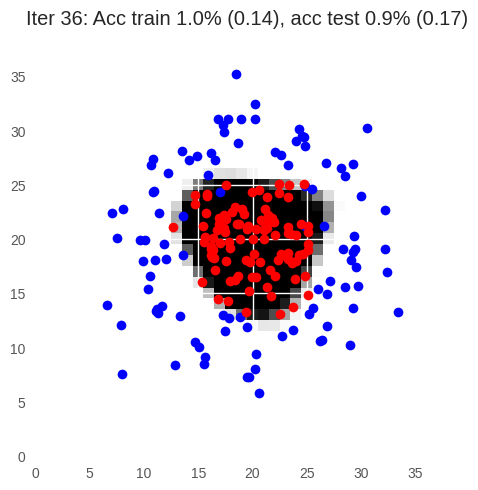

Iter 37: Acc train 0.9% (0.14), acc test 0.9% (0.17)


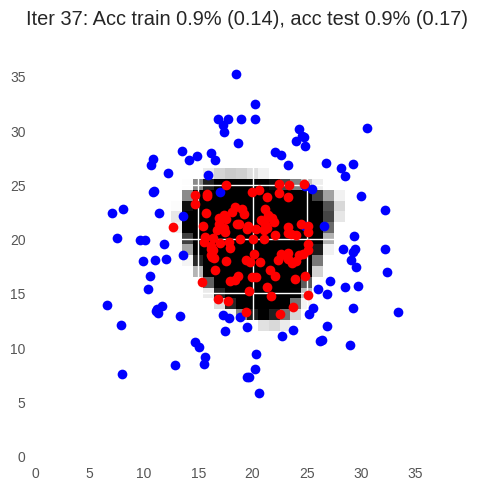

Iter 38: Acc train 1.0% (0.13), acc test 0.9% (0.17)


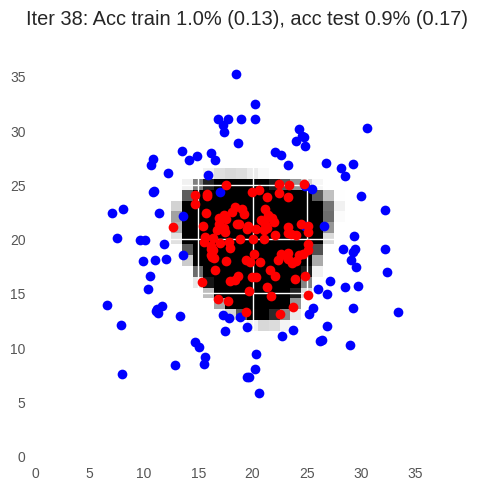

Iter 39: Acc train 1.0% (0.13), acc test 0.9% (0.17)


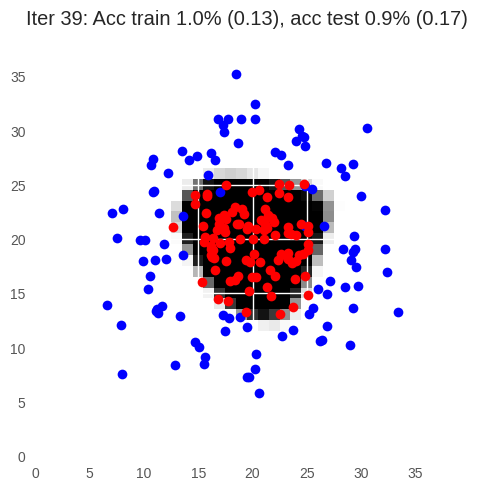

Iter 40: Acc train 0.9% (0.13), acc test 0.9% (0.18)


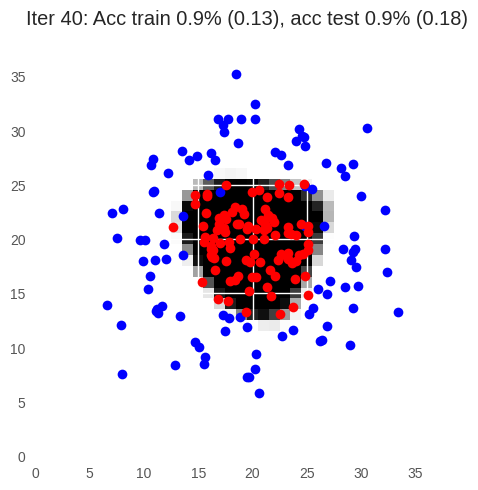

Iter 41: Acc train 0.9% (0.13), acc test 0.9% (0.17)


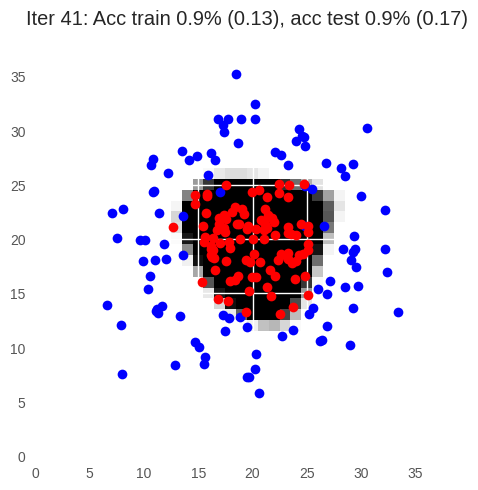

Iter 42: Acc train 1.0% (0.13), acc test 0.9% (0.17)


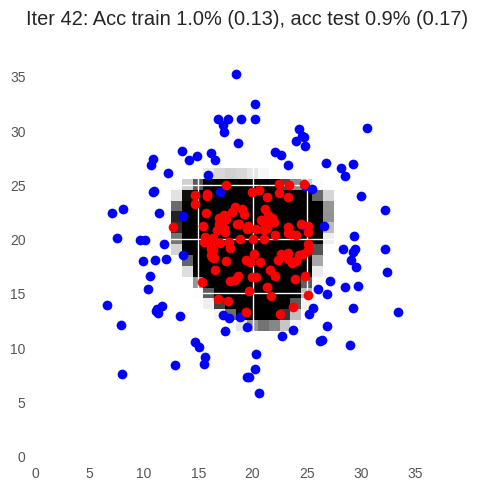

Iter 43: Acc train 1.0% (0.13), acc test 0.9% (0.17)


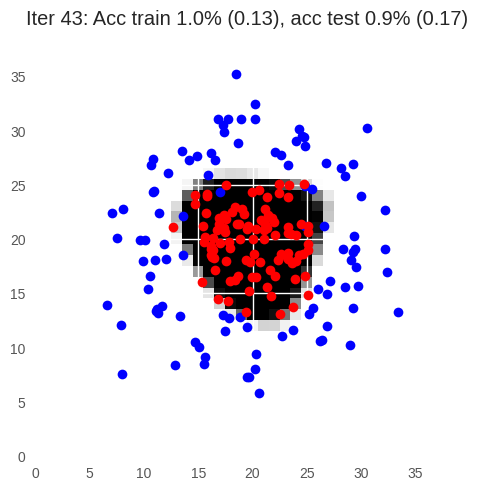

Iter 44: Acc train 0.9% (0.14), acc test 0.9% (0.18)


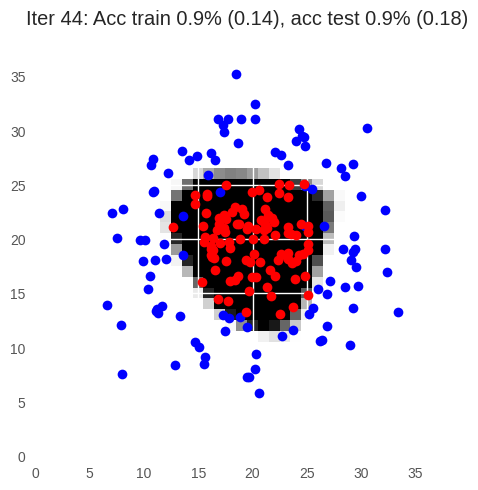

Iter 45: Acc train 0.9% (0.13), acc test 0.9% (0.19)


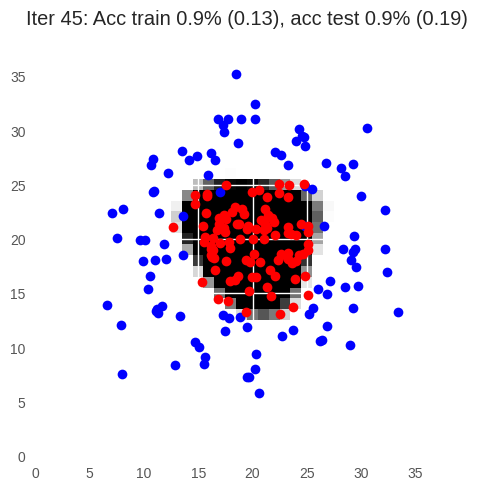

Iter 46: Acc train 0.9% (0.13), acc test 0.9% (0.17)


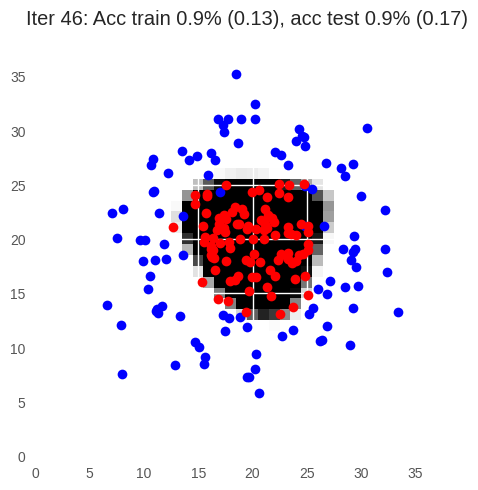

Iter 47: Acc train 1.0% (0.13), acc test 0.9% (0.17)


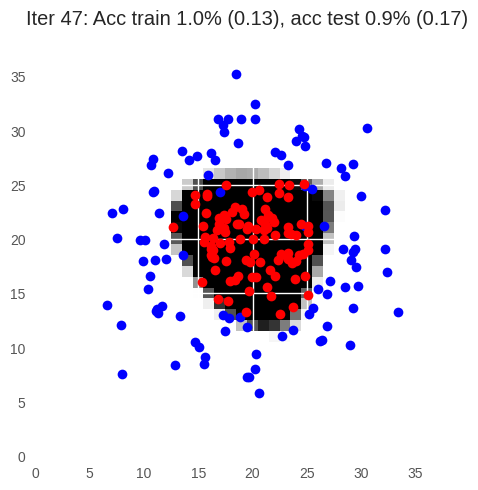

Iter 48: Acc train 1.0% (0.12), acc test 0.9% (0.17)


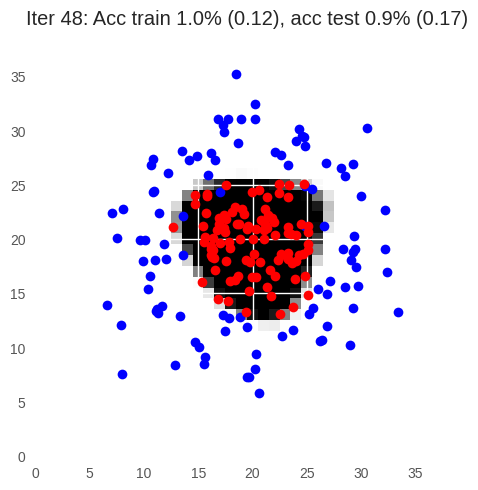

Iter 49: Acc train 1.0% (0.13), acc test 0.9% (0.17)


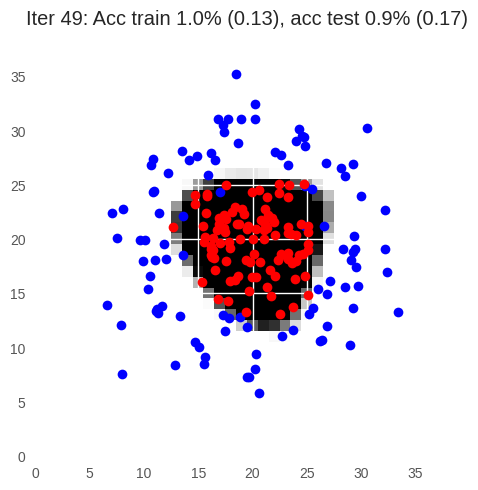

Iter 50: Acc train 1.0% (0.12), acc test 0.9% (0.18)


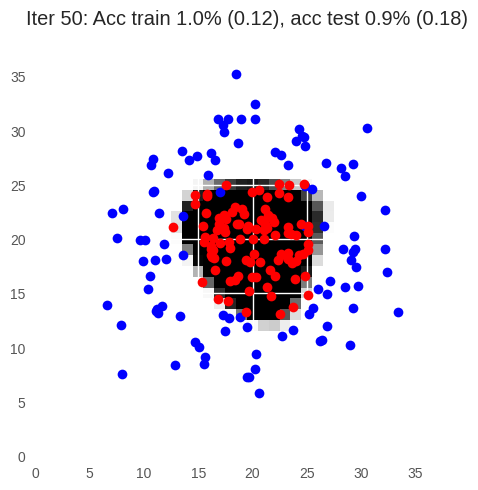

Iter 51: Acc train 1.0% (0.12), acc test 0.9% (0.17)


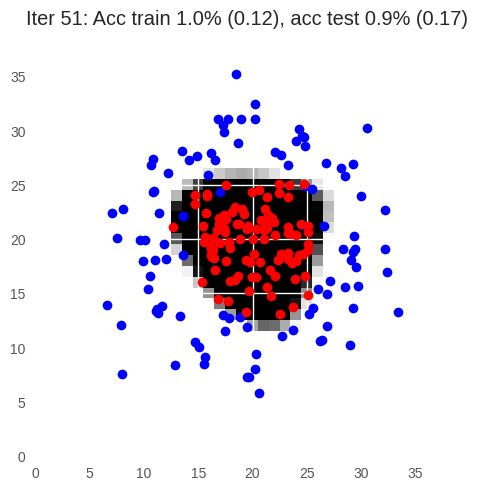

Iter 52: Acc train 1.0% (0.12), acc test 0.9% (0.18)


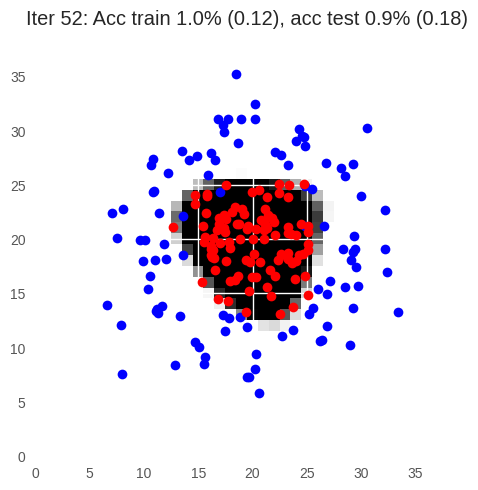

Iter 53: Acc train 0.9% (0.12), acc test 0.9% (0.17)


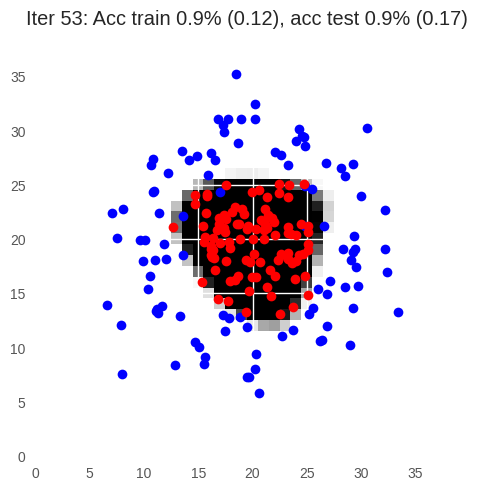

Iter 54: Acc train 1.0% (0.12), acc test 0.9% (0.17)


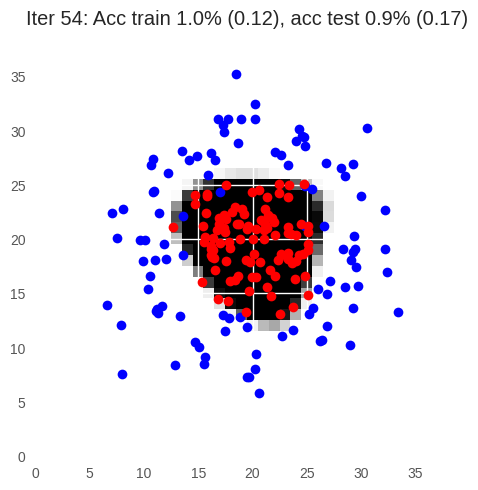

Iter 55: Acc train 1.0% (0.12), acc test 0.9% (0.17)


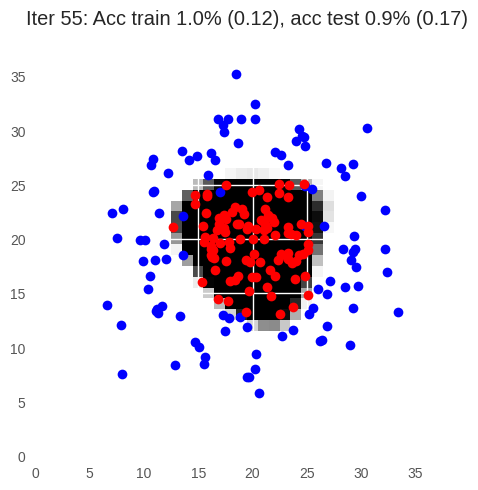

Iter 56: Acc train 1.0% (0.13), acc test 0.9% (0.16)


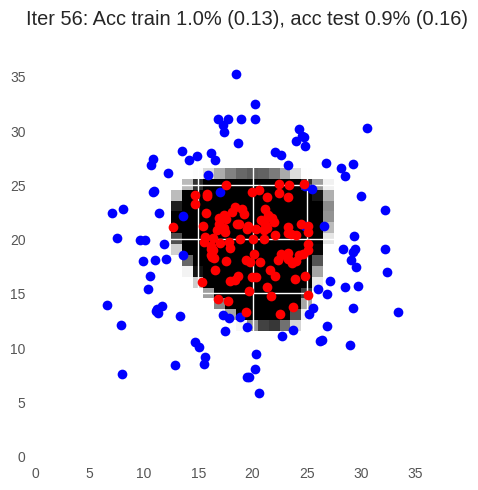

Iter 57: Acc train 0.9% (0.12), acc test 0.9% (0.19)


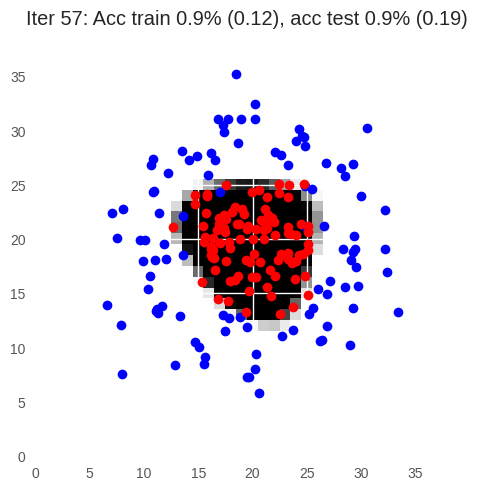

Iter 58: Acc train 1.0% (0.12), acc test 0.9% (0.16)


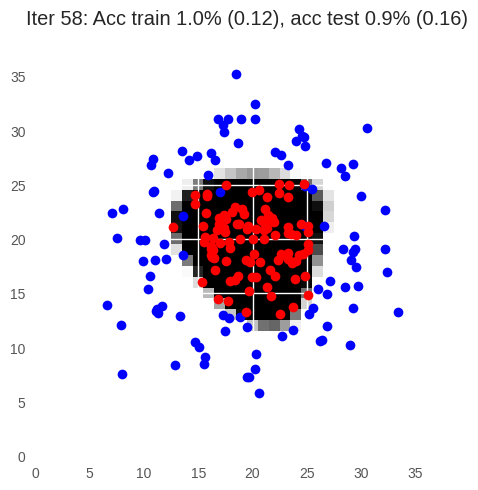

Iter 59: Acc train 1.0% (0.12), acc test 0.9% (0.18)


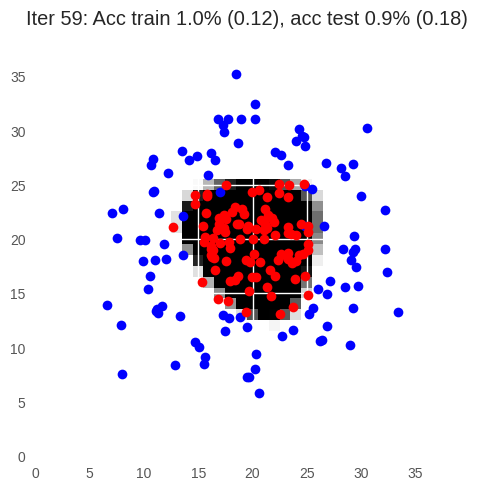

Iter 60: Acc train 0.9% (0.11), acc test 0.9% (0.17)


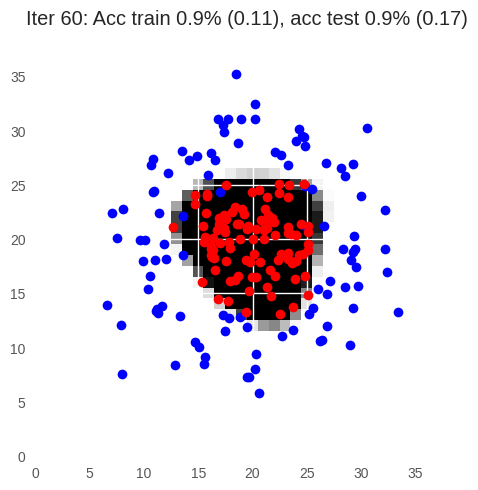

Iter 61: Acc train 1.0% (0.11), acc test 0.9% (0.17)


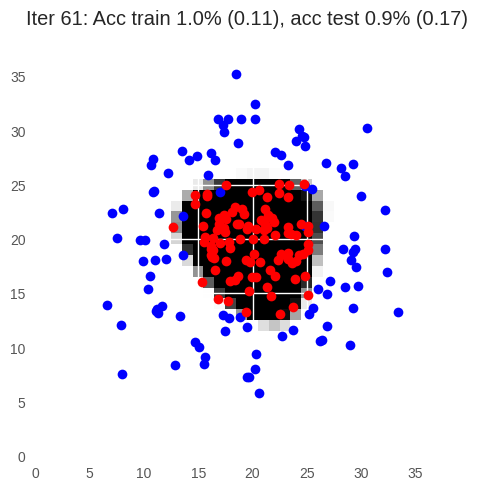

Iter 62: Acc train 1.0% (0.11), acc test 0.9% (0.17)


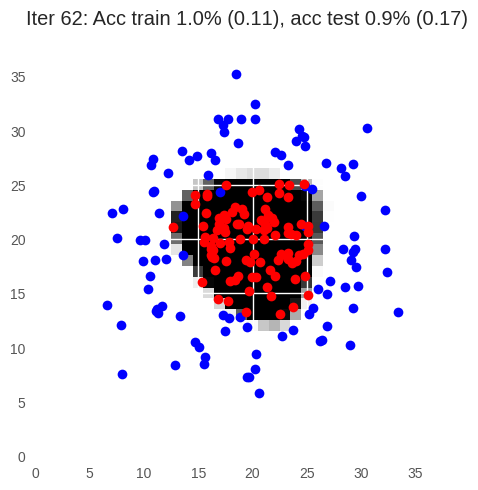

Iter 63: Acc train 1.0% (0.11), acc test 0.9% (0.17)


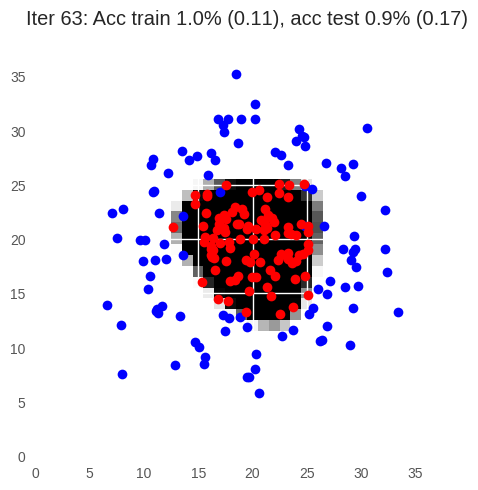

Iter 64: Acc train 1.0% (0.11), acc test 0.9% (0.17)


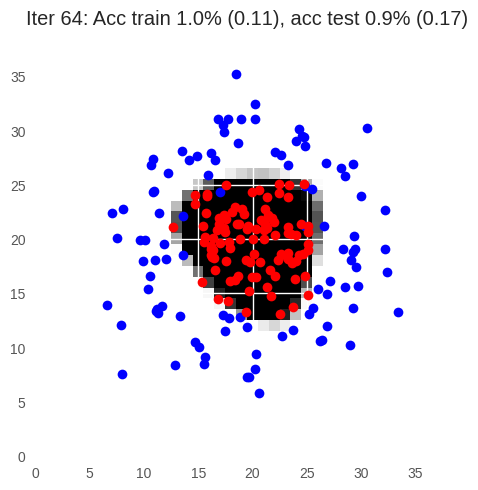

Iter 65: Acc train 1.0% (0.11), acc test 0.9% (0.17)


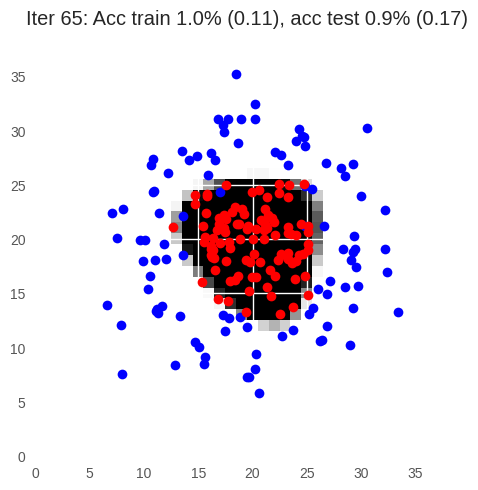

Iter 66: Acc train 1.0% (0.12), acc test 0.9% (0.19)


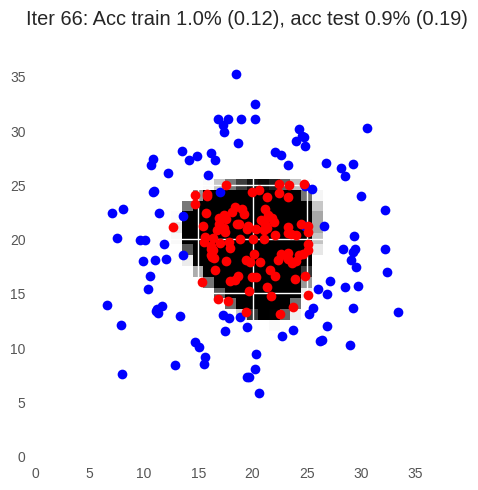

Iter 67: Acc train 1.0% (0.11), acc test 0.9% (0.17)


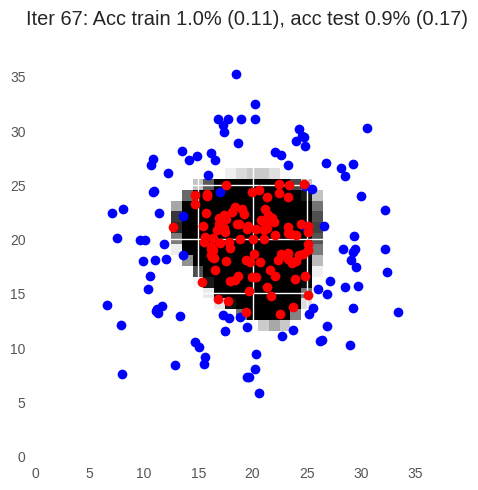

Iter 68: Acc train 1.0% (0.11), acc test 0.9% (0.17)


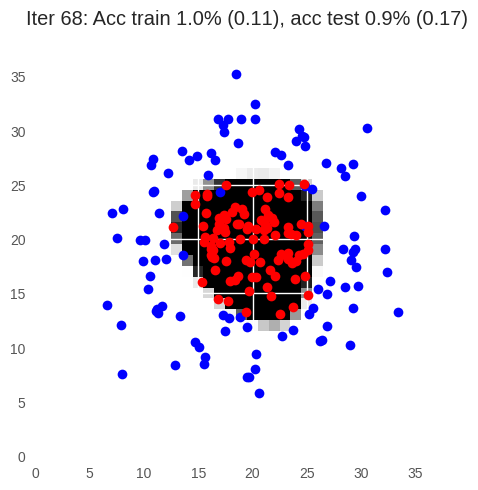

Iter 69: Acc train 1.0% (0.11), acc test 0.9% (0.18)


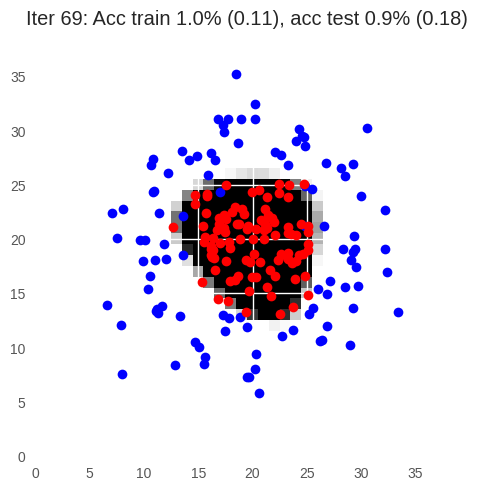

Iter 70: Acc train 1.0% (0.11), acc test 0.9% (0.17)


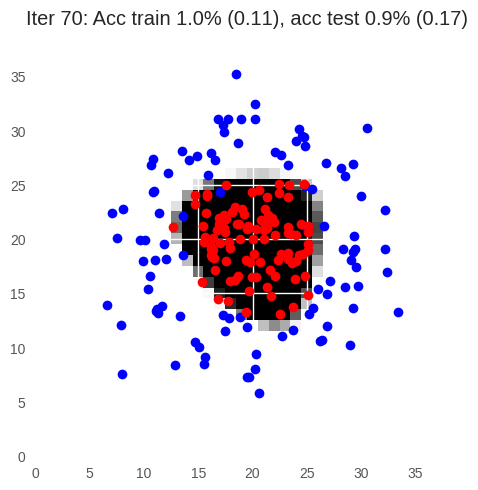

Iter 71: Acc train 1.0% (0.11), acc test 0.9% (0.18)


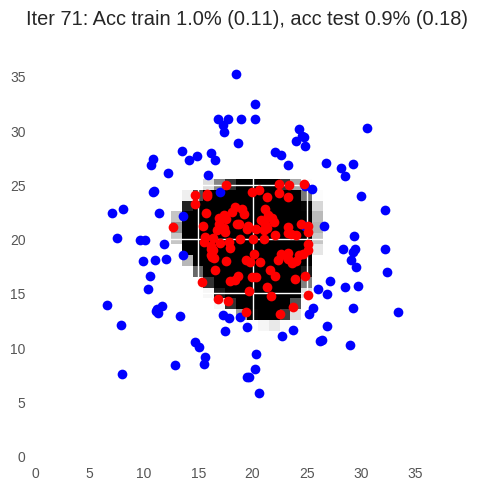

Iter 72: Acc train 1.0% (0.11), acc test 0.9% (0.16)


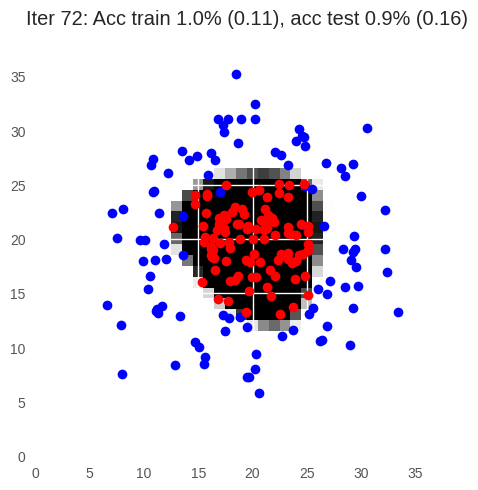

Iter 73: Acc train 1.0% (0.10), acc test 0.9% (0.16)


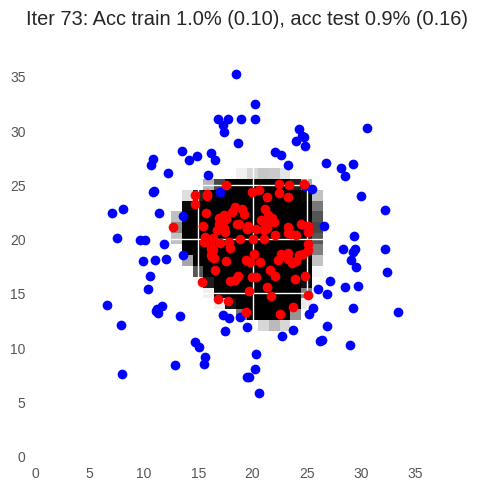

Iter 74: Acc train 1.0% (0.11), acc test 0.9% (0.18)


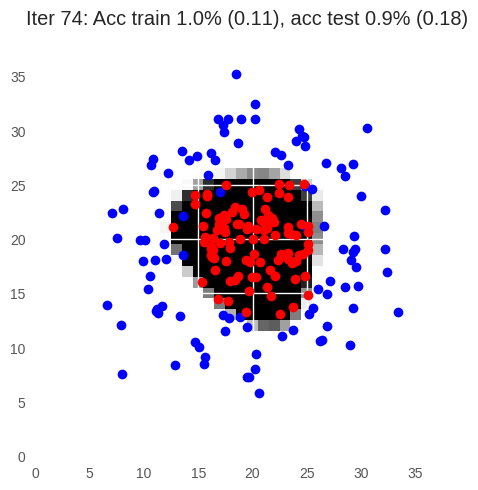

Iter 75: Acc train 1.0% (0.10), acc test 0.9% (0.17)


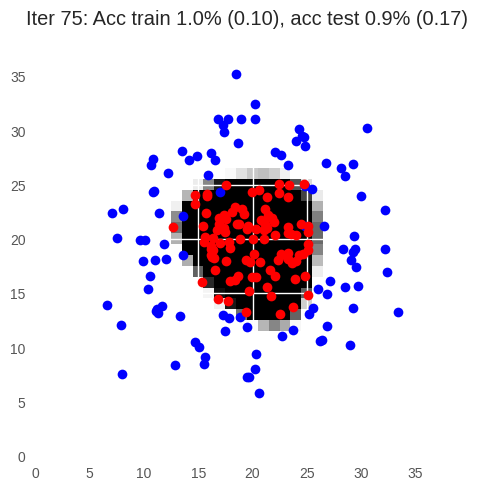

Iter 76: Acc train 1.0% (0.10), acc test 0.9% (0.17)


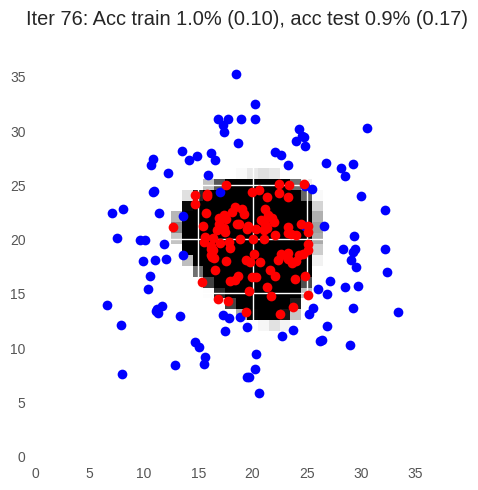

Iter 77: Acc train 1.0% (0.10), acc test 0.9% (0.16)


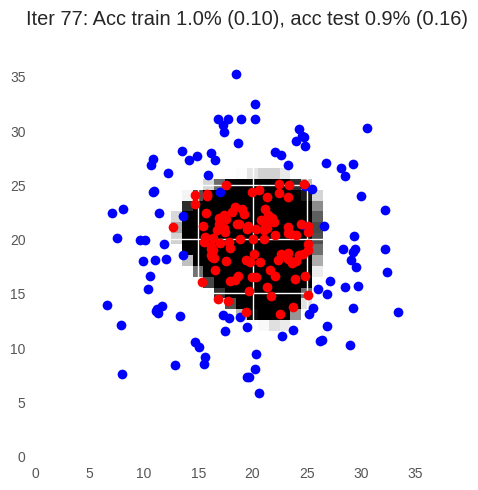

Iter 78: Acc train 1.0% (0.10), acc test 0.9% (0.17)


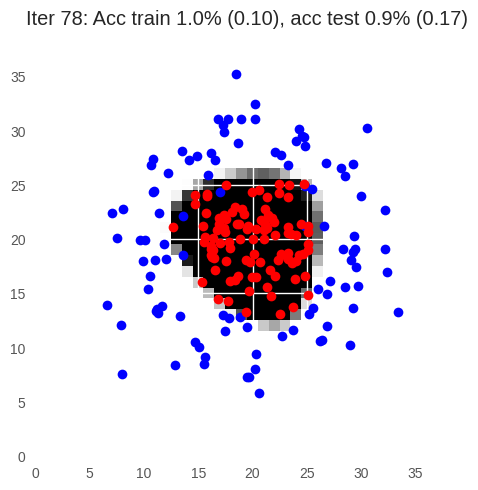

Iter 79: Acc train 0.9% (0.12), acc test 0.9% (0.20)


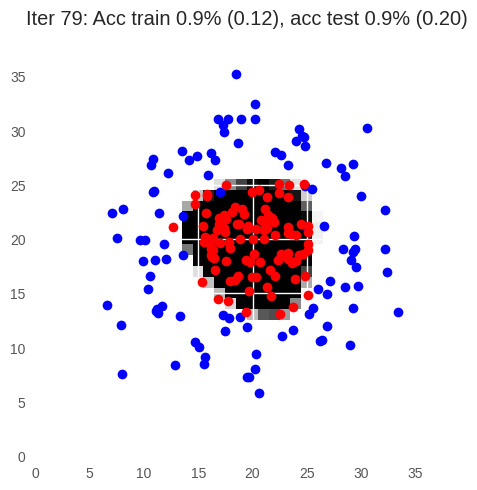

Iter 80: Acc train 1.0% (0.10), acc test 0.9% (0.17)


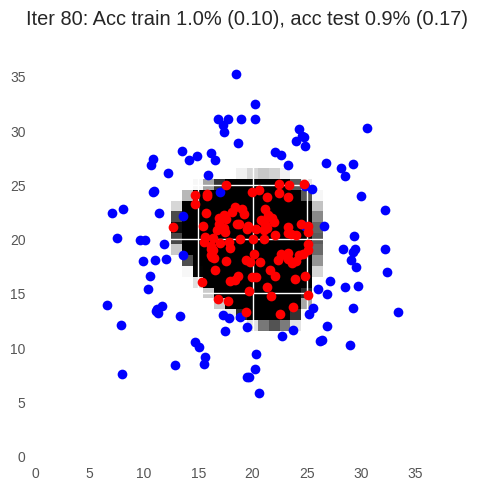

Iter 81: Acc train 1.0% (0.11), acc test 0.9% (0.18)


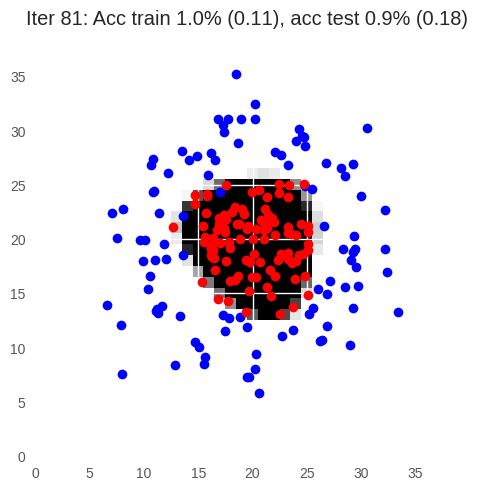

Iter 82: Acc train 1.0% (0.12), acc test 0.9% (0.17)


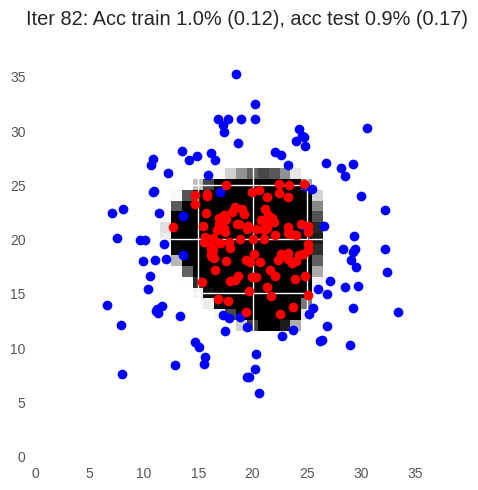

Iter 83: Acc train 1.0% (0.10), acc test 0.9% (0.16)


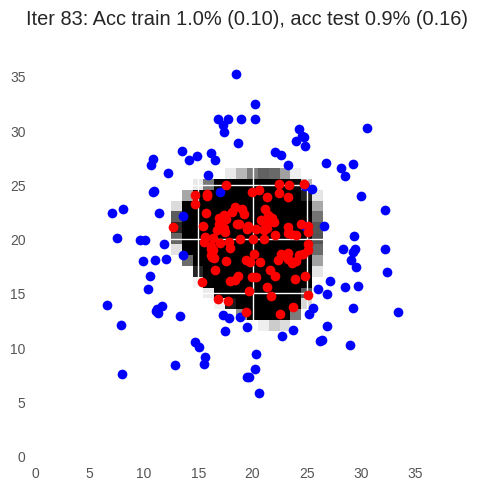

Iter 84: Acc train 1.0% (0.10), acc test 0.9% (0.17)


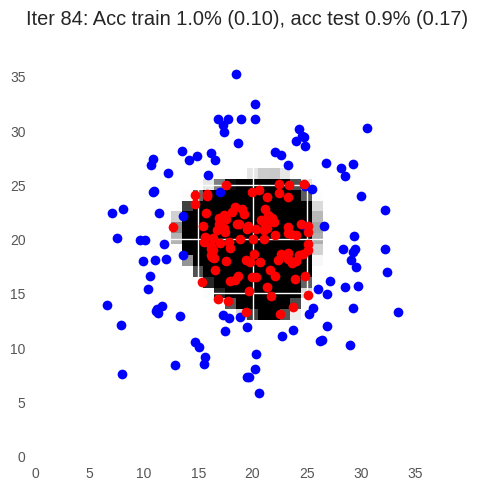

Iter 85: Acc train 1.0% (0.10), acc test 0.9% (0.16)


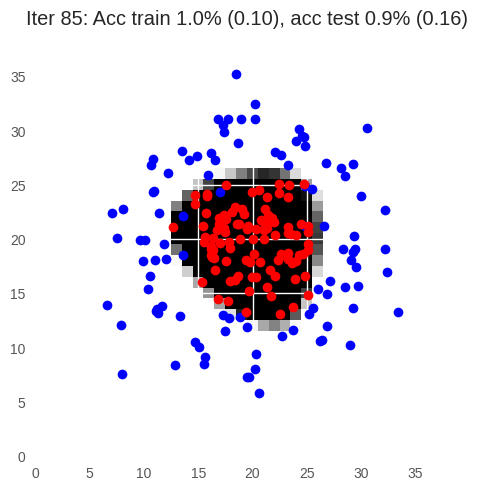

Iter 86: Acc train 1.0% (0.10), acc test 0.9% (0.17)


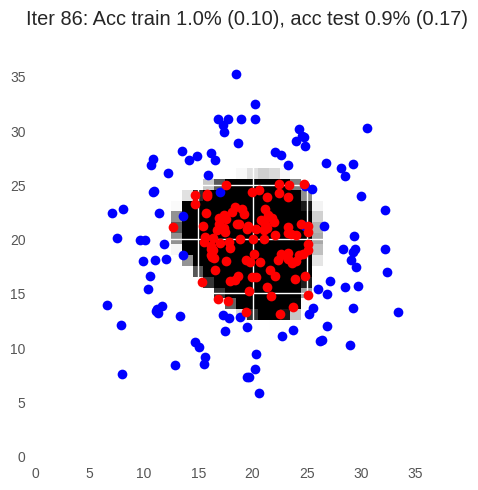

Iter 87: Acc train 1.0% (0.10), acc test 0.9% (0.17)


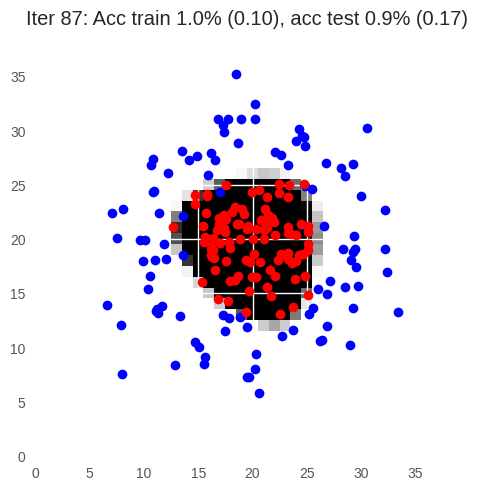

Iter 88: Acc train 1.0% (0.10), acc test 0.9% (0.16)


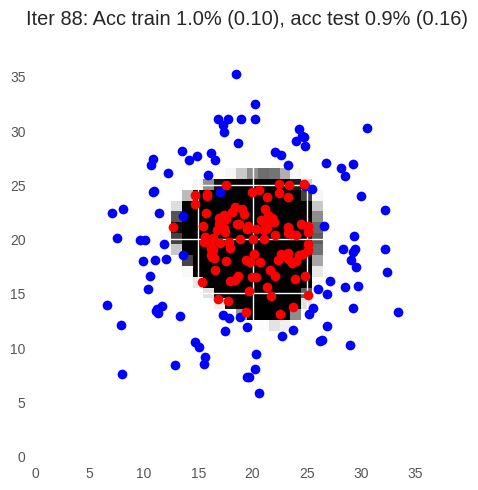

Iter 89: Acc train 1.0% (0.10), acc test 0.9% (0.17)


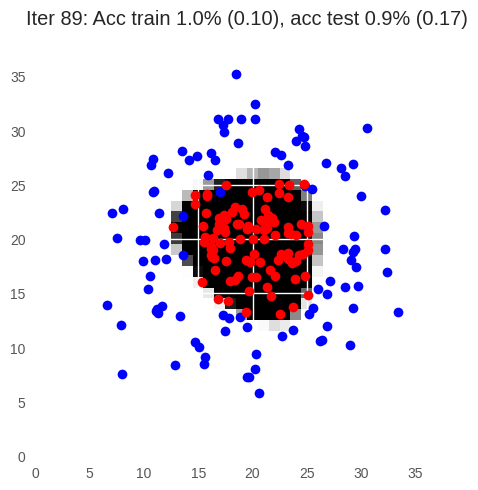

Iter 90: Acc train 1.0% (0.10), acc test 0.9% (0.16)


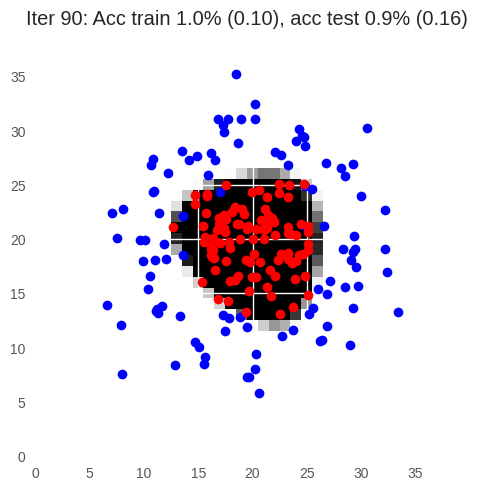

Iter 91: Acc train 1.0% (0.10), acc test 0.9% (0.16)


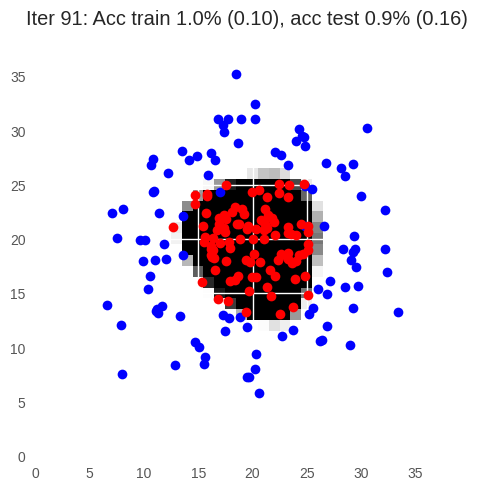

Iter 92: Acc train 1.0% (0.10), acc test 0.9% (0.17)


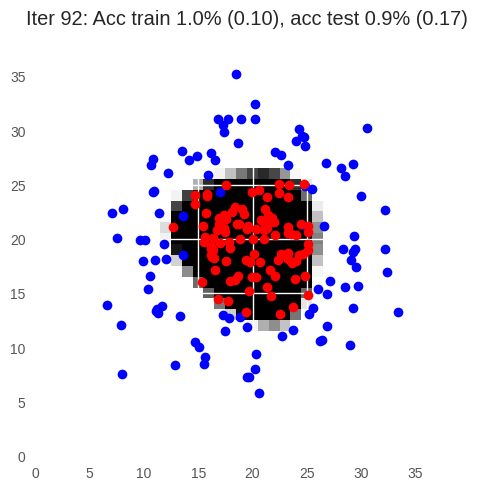

Iter 93: Acc train 1.0% (0.10), acc test 0.9% (0.17)


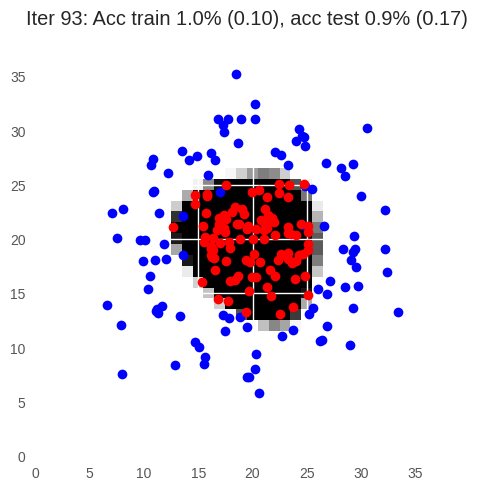

Iter 94: Acc train 1.0% (0.10), acc test 0.9% (0.17)


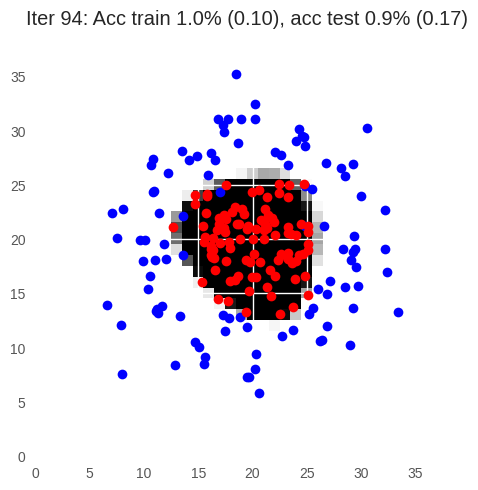

Iter 95: Acc train 1.0% (0.10), acc test 0.9% (0.16)


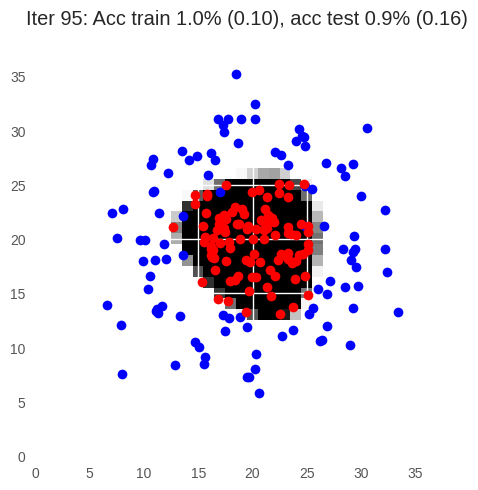

Iter 96: Acc train 1.0% (0.10), acc test 0.9% (0.18)


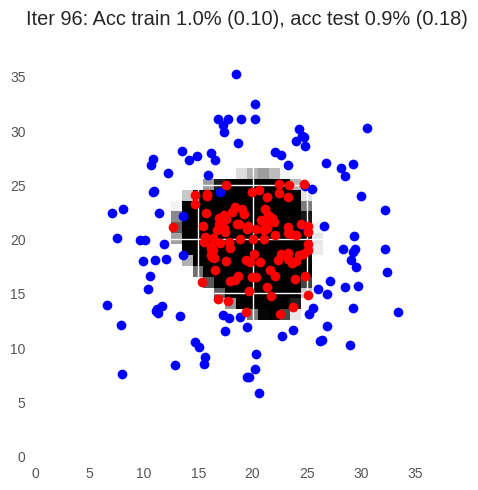

Iter 97: Acc train 1.0% (0.09), acc test 0.9% (0.16)


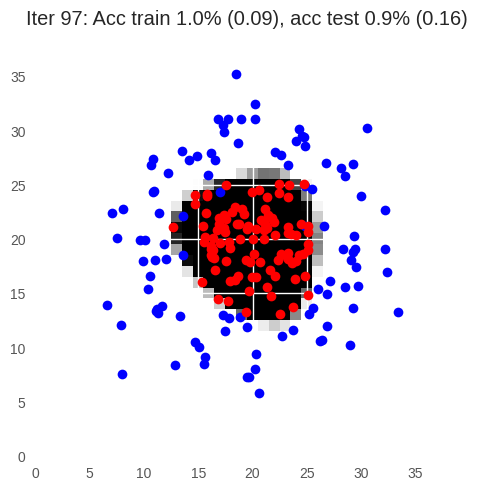

Iter 98: Acc train 1.0% (0.10), acc test 0.9% (0.16)


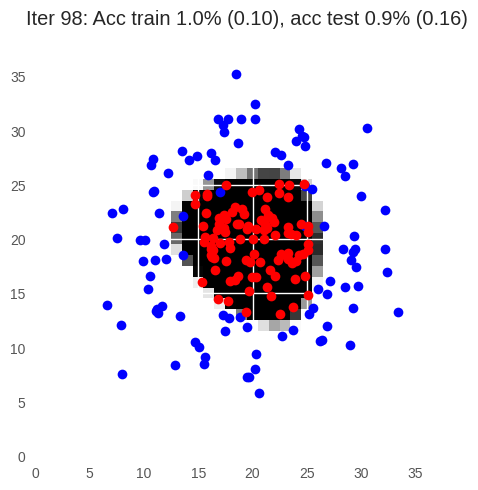

Iter 99: Acc train 1.0% (0.09), acc test 0.9% (0.17)


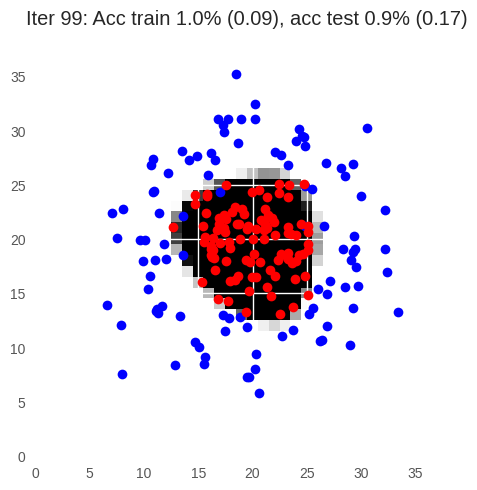

Iter 100: Acc train 1.0% (0.09), acc test 0.9% (0.16)


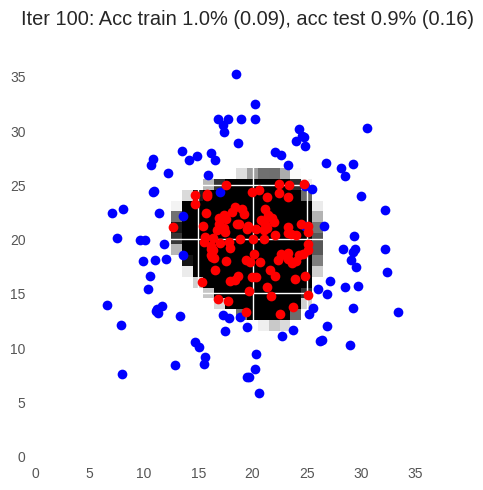

Iter 101: Acc train 1.0% (0.10), acc test 0.9% (0.16)


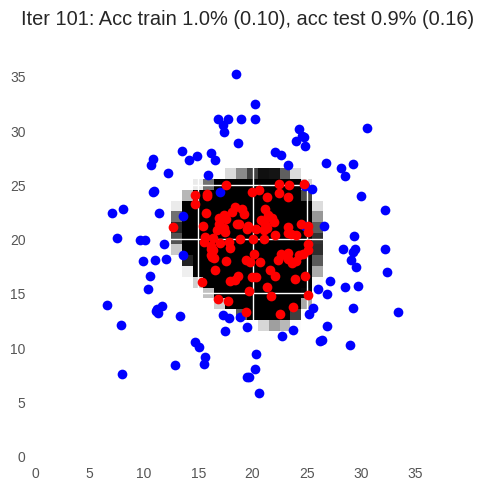

Iter 102: Acc train 1.0% (0.10), acc test 0.9% (0.17)


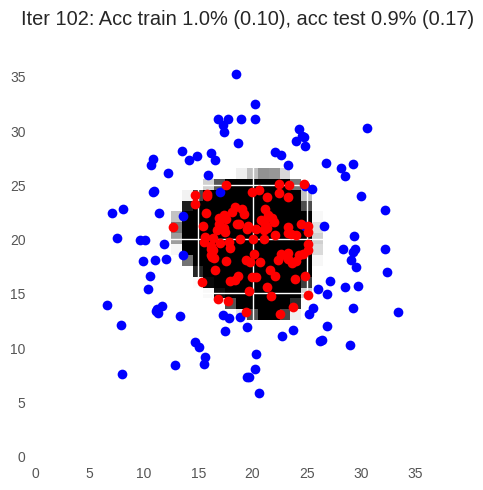

Iter 103: Acc train 1.0% (0.09), acc test 0.9% (0.16)


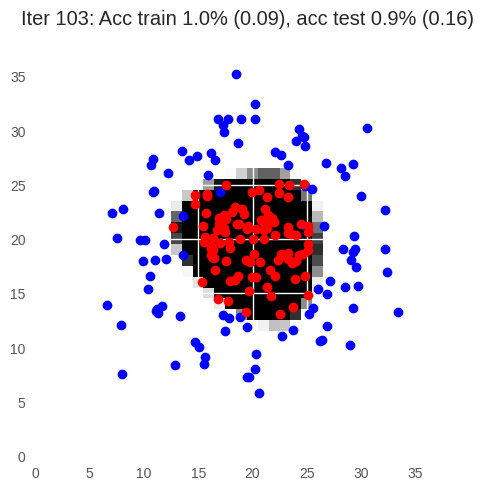

Iter 104: Acc train 1.0% (0.09), acc test 0.9% (0.17)


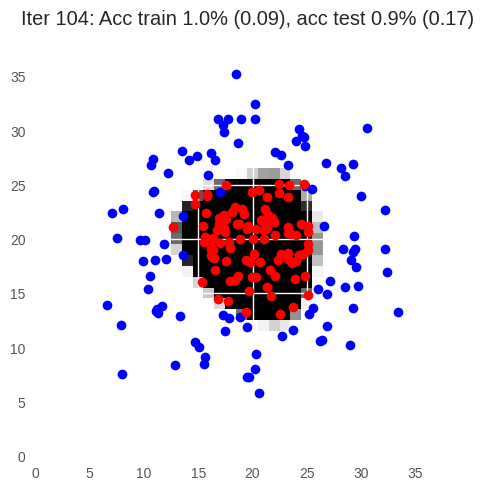

Iter 105: Acc train 1.0% (0.09), acc test 0.9% (0.16)


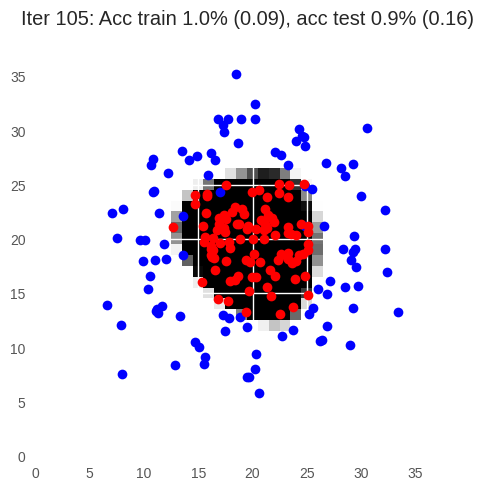

Iter 106: Acc train 1.0% (0.10), acc test 0.9% (0.16)


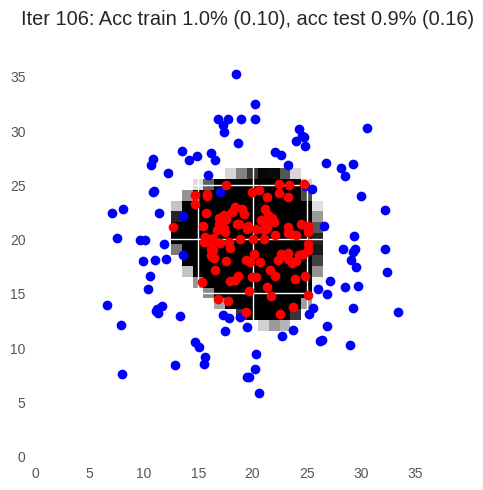

Iter 107: Acc train 1.0% (0.09), acc test 0.9% (0.16)


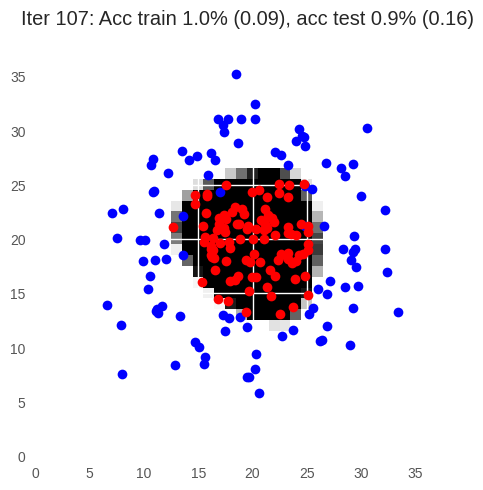

Iter 108: Acc train 1.0% (0.09), acc test 0.9% (0.17)


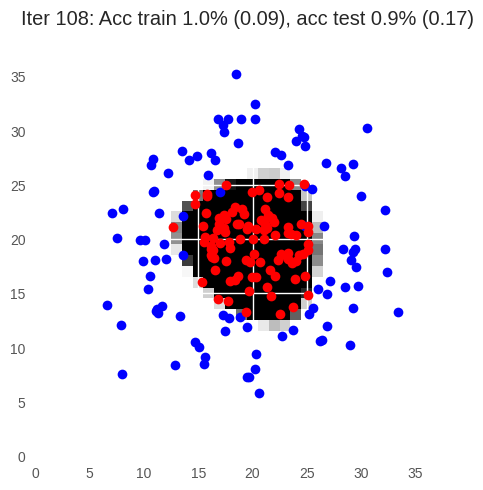

Iter 109: Acc train 1.0% (0.10), acc test 0.9% (0.17)


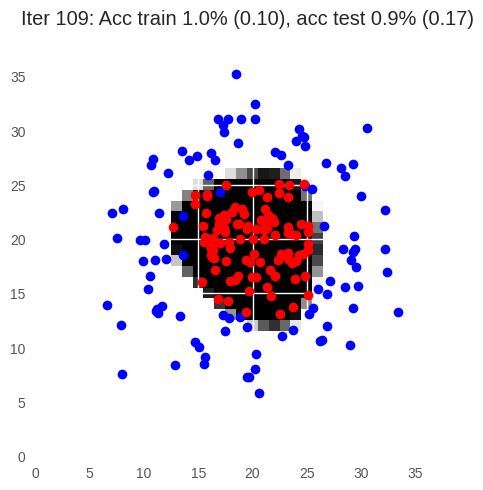

Iter 110: Acc train 1.0% (0.09), acc test 0.9% (0.16)


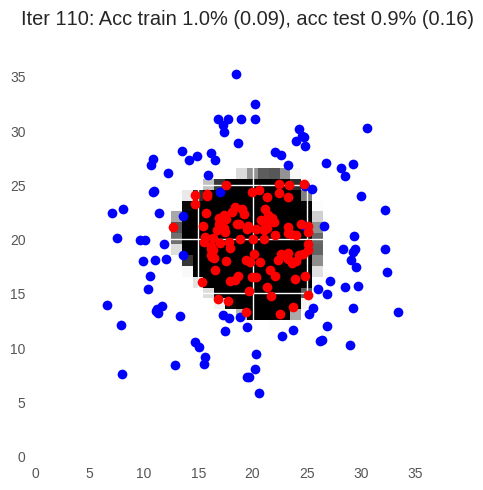

Iter 111: Acc train 1.0% (0.09), acc test 0.9% (0.16)


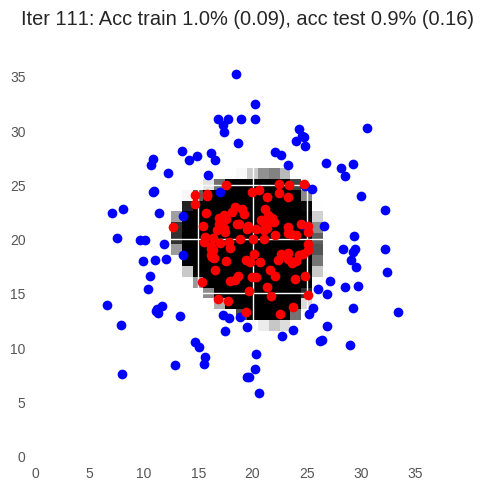

Iter 112: Acc train 1.0% (0.10), acc test 0.9% (0.18)


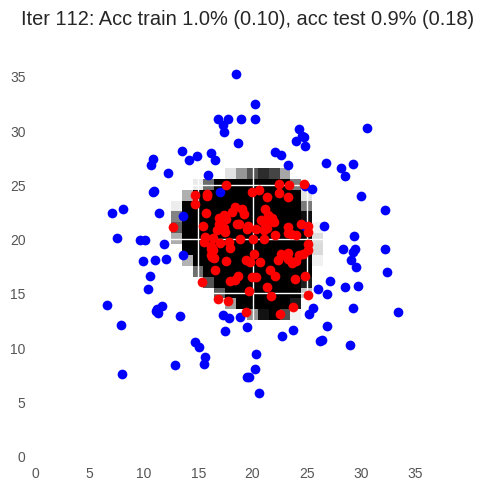

Iter 113: Acc train 1.0% (0.10), acc test 0.9% (0.17)


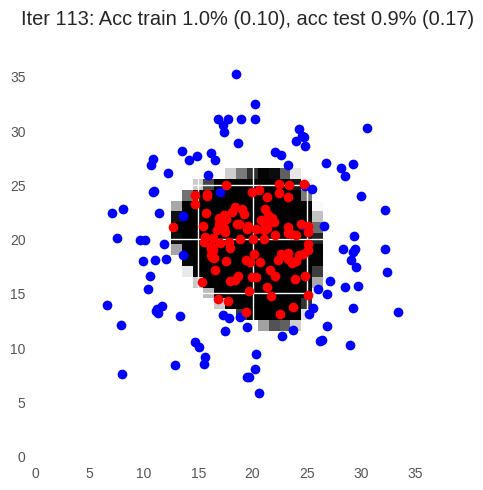

Iter 114: Acc train 1.0% (0.09), acc test 0.9% (0.17)


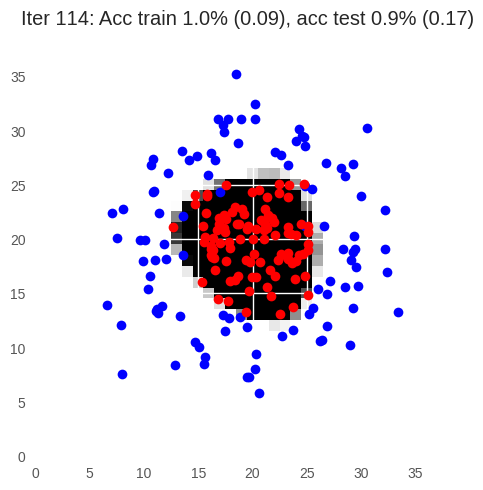

Iter 115: Acc train 1.0% (0.09), acc test 0.9% (0.17)


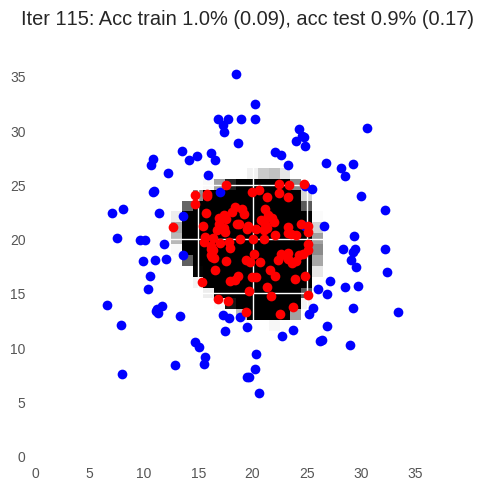

Iter 116: Acc train 1.0% (0.09), acc test 0.9% (0.16)


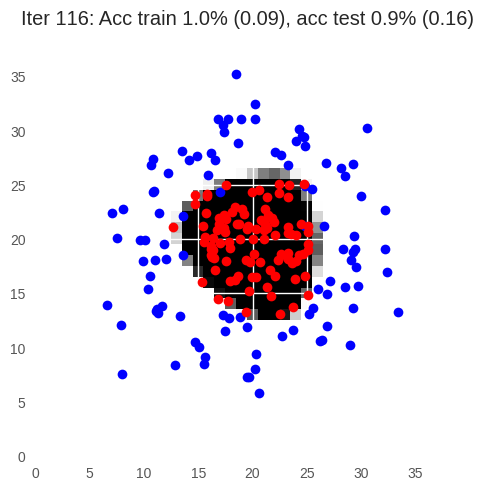

Iter 117: Acc train 1.0% (0.09), acc test 0.9% (0.17)


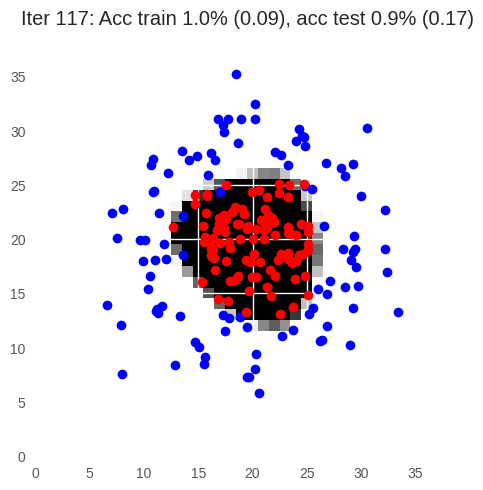

Iter 118: Acc train 1.0% (0.09), acc test 0.9% (0.16)


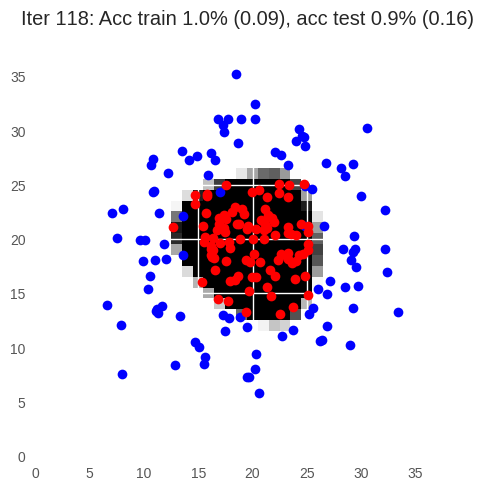

Iter 119: Acc train 1.0% (0.09), acc test 0.9% (0.16)


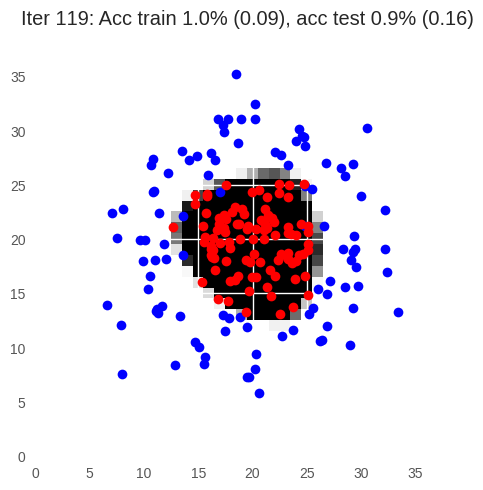

Iter 120: Acc train 1.0% (0.10), acc test 0.9% (0.15)


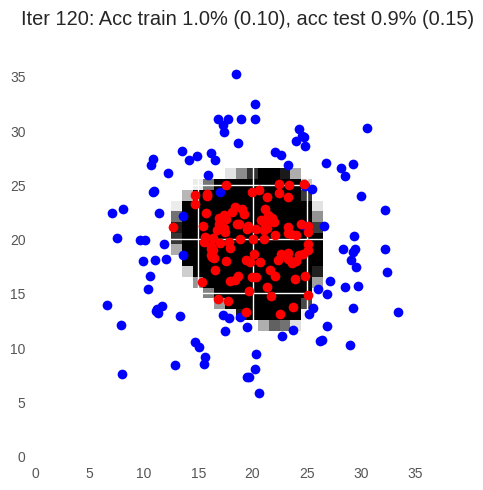

Iter 121: Acc train 1.0% (0.10), acc test 0.9% (0.18)


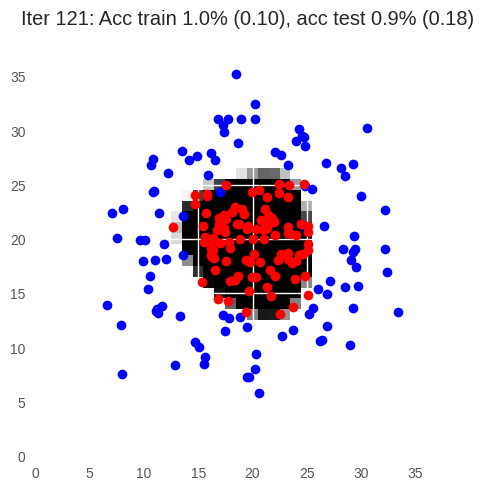

Iter 122: Acc train 1.0% (0.09), acc test 0.9% (0.17)


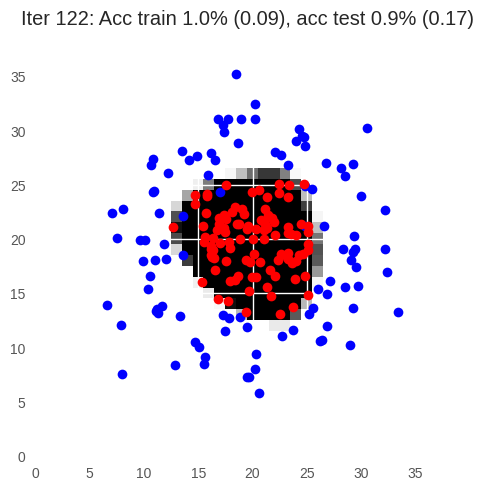

Iter 123: Acc train 1.0% (0.09), acc test 0.9% (0.17)


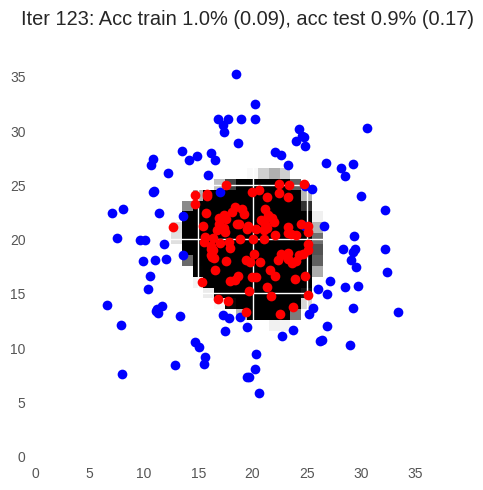

Iter 124: Acc train 1.0% (0.09), acc test 0.9% (0.16)


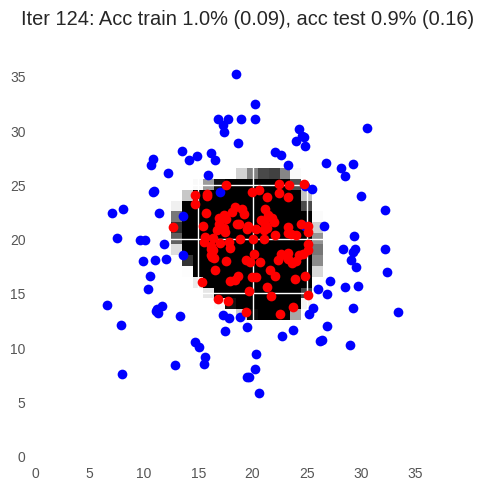

Iter 125: Acc train 1.0% (0.09), acc test 0.9% (0.16)


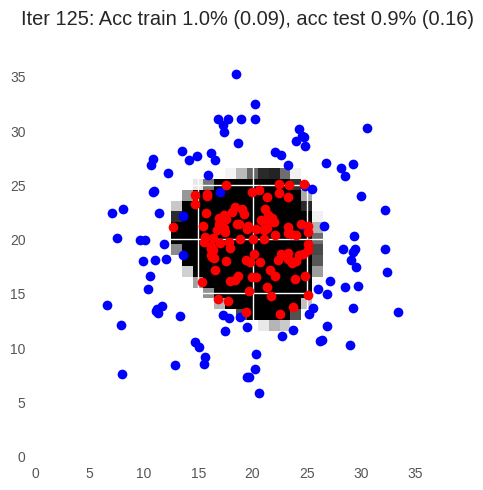

Iter 126: Acc train 1.0% (0.09), acc test 0.9% (0.18)


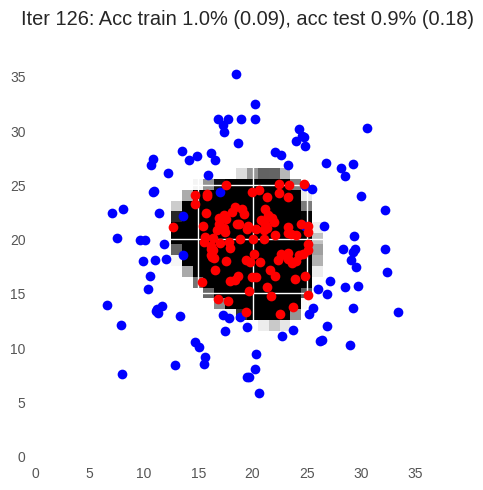

Iter 127: Acc train 1.0% (0.09), acc test 0.9% (0.16)


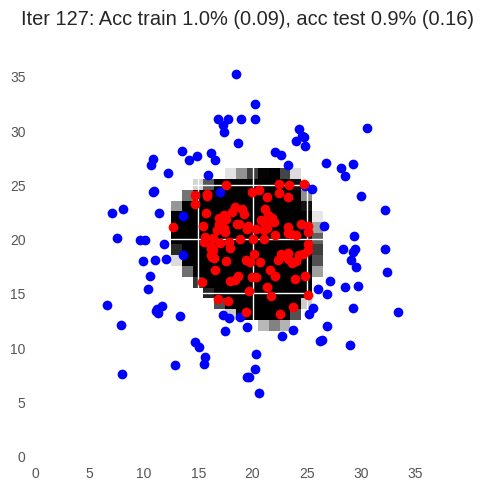

Iter 128: Acc train 1.0% (0.09), acc test 0.9% (0.16)


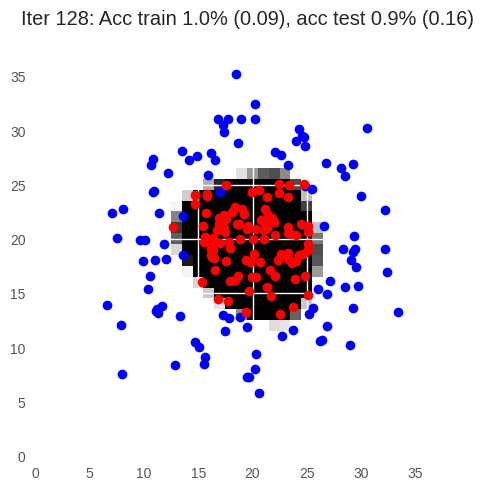

Iter 129: Acc train 1.0% (0.09), acc test 0.9% (0.16)


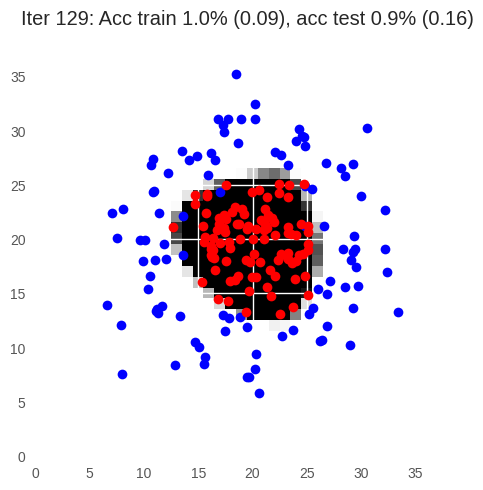

Iter 130: Acc train 1.0% (0.09), acc test 0.9% (0.15)


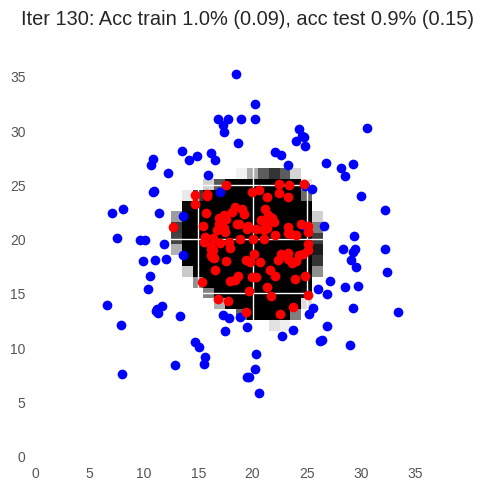

Iter 131: Acc train 1.0% (0.09), acc test 0.9% (0.17)


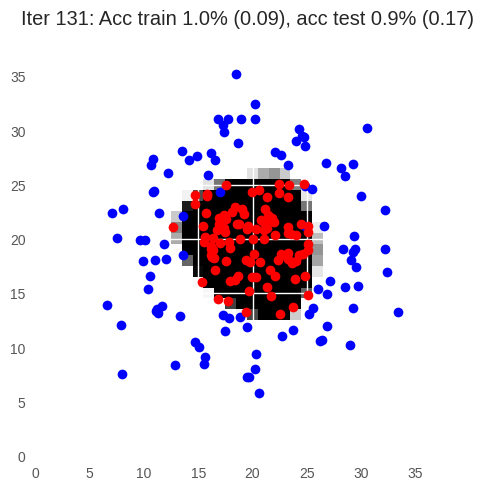

Iter 132: Acc train 1.0% (0.09), acc test 0.9% (0.17)


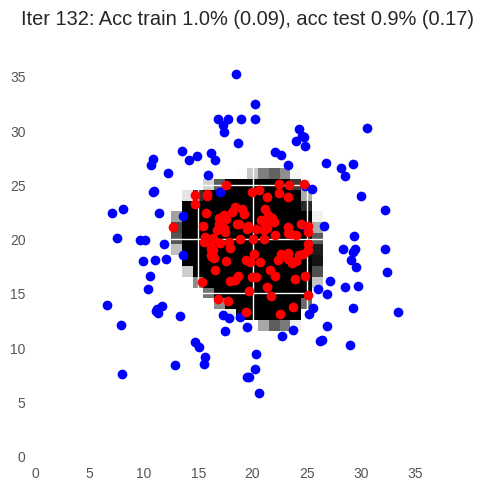

Iter 133: Acc train 1.0% (0.09), acc test 0.9% (0.17)


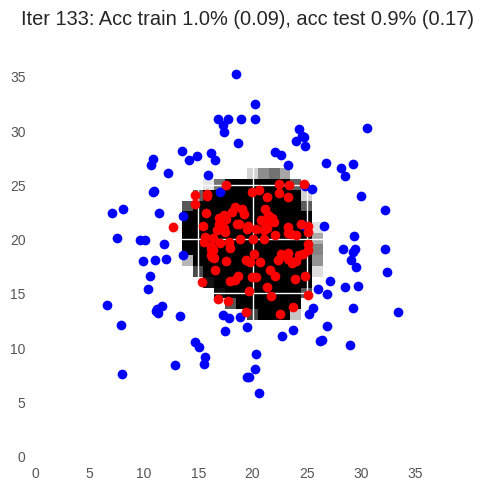

Iter 134: Acc train 1.0% (0.09), acc test 0.9% (0.17)


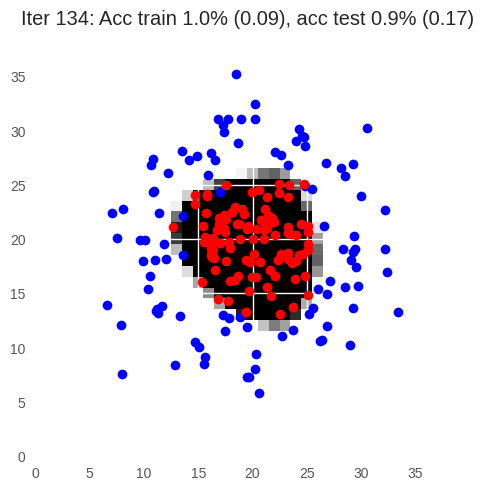

Iter 135: Acc train 1.0% (0.09), acc test 0.9% (0.16)


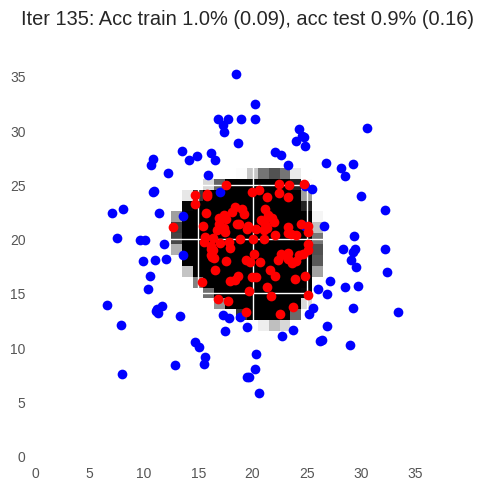

Iter 136: Acc train 1.0% (0.09), acc test 0.9% (0.17)


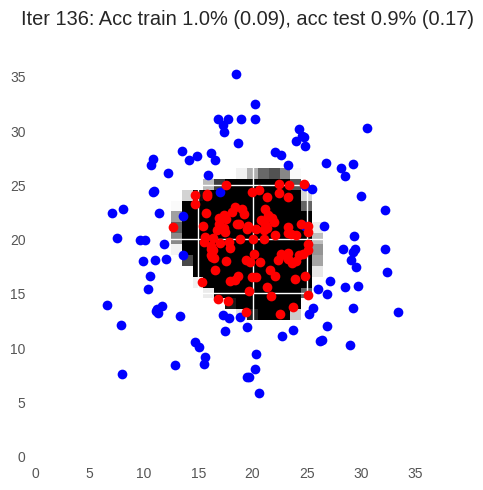

Iter 137: Acc train 1.0% (0.09), acc test 0.9% (0.16)


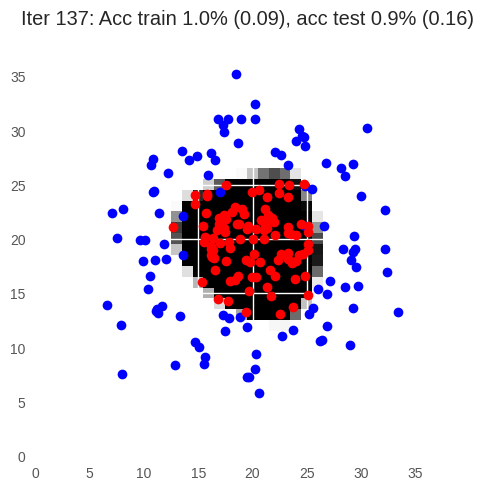

Iter 138: Acc train 1.0% (0.09), acc test 0.9% (0.17)


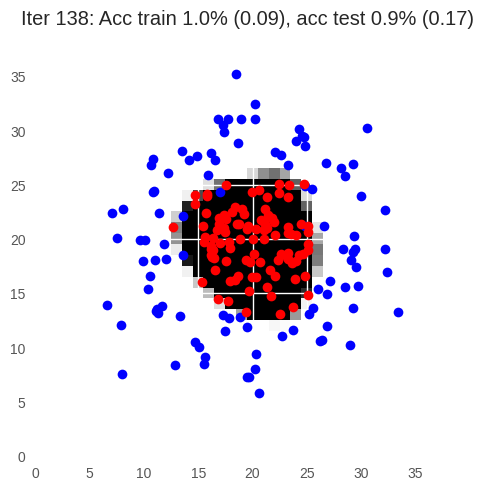

Iter 139: Acc train 1.0% (0.09), acc test 0.9% (0.16)


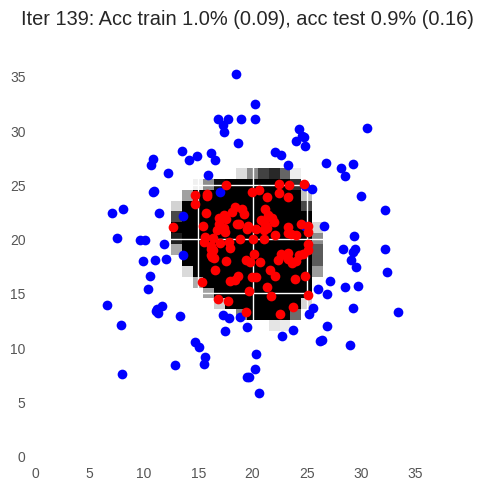

Iter 140: Acc train 1.0% (0.09), acc test 0.9% (0.17)


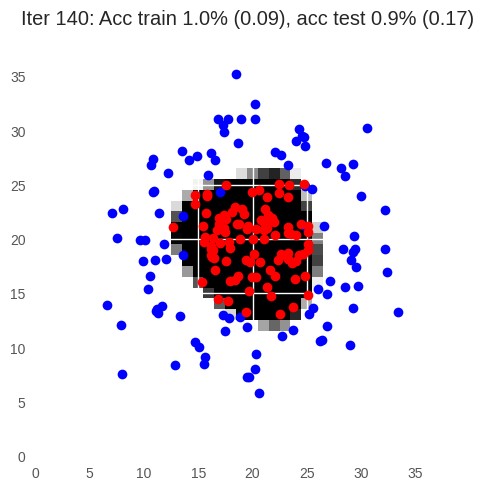

Iter 141: Acc train 1.0% (0.09), acc test 0.9% (0.15)


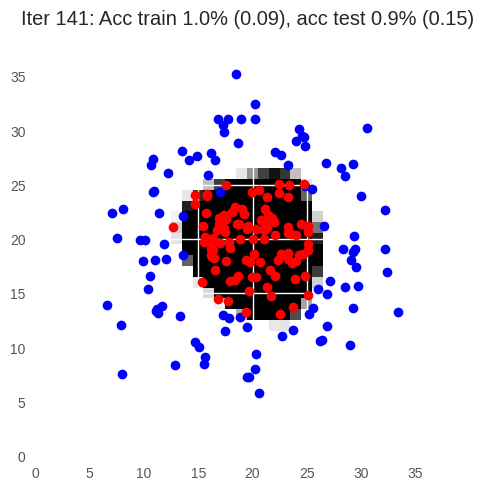

Iter 142: Acc train 1.0% (0.10), acc test 0.9% (0.20)


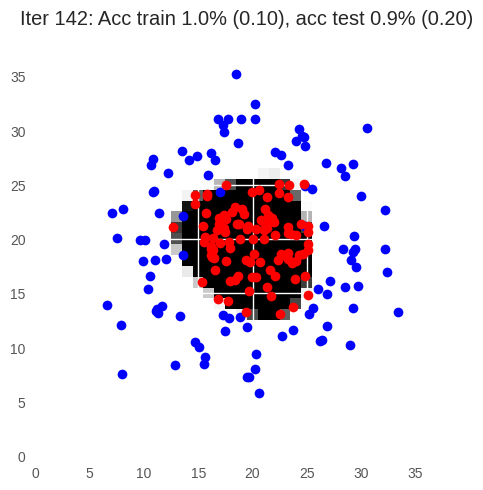

Iter 143: Acc train 1.0% (0.09), acc test 0.9% (0.16)


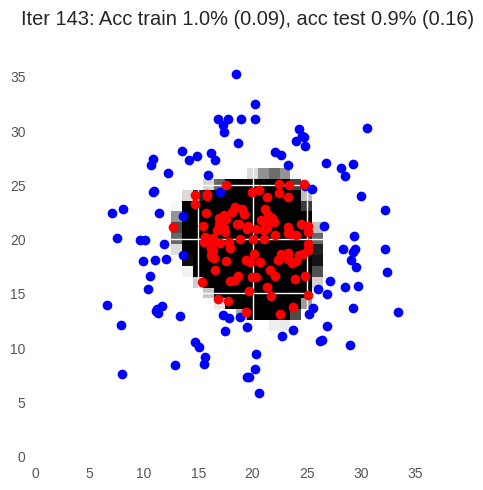

Iter 144: Acc train 1.0% (0.09), acc test 0.9% (0.16)


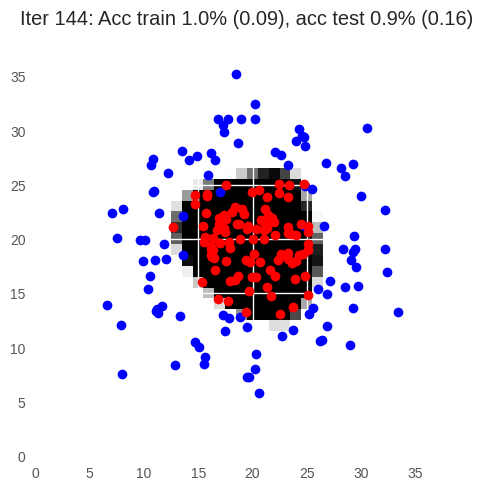

Iter 145: Acc train 1.0% (0.09), acc test 0.9% (0.17)


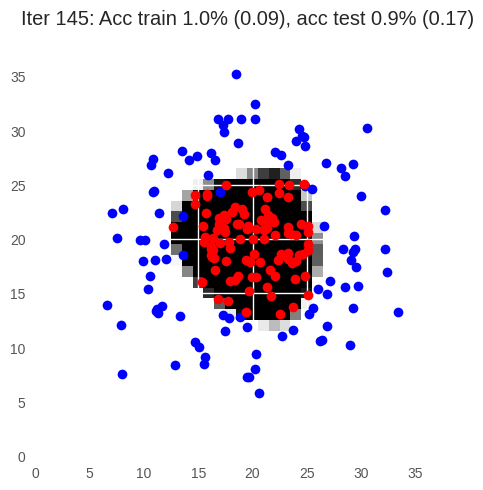

Iter 146: Acc train 1.0% (0.10), acc test 0.9% (0.16)


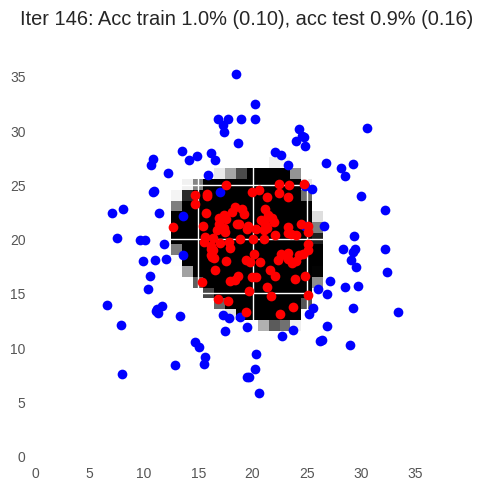

Iter 147: Acc train 1.0% (0.08), acc test 0.9% (0.17)


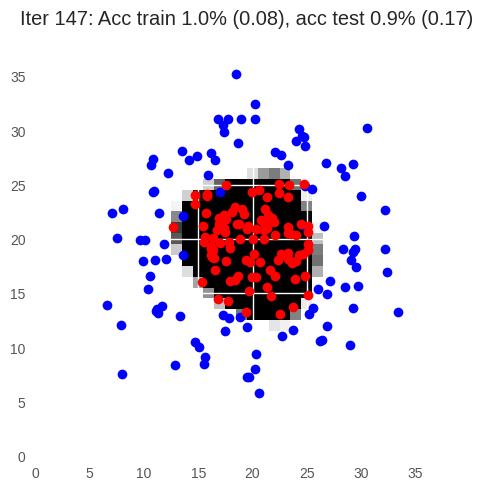

Iter 148: Acc train 1.0% (0.09), acc test 0.9% (0.17)


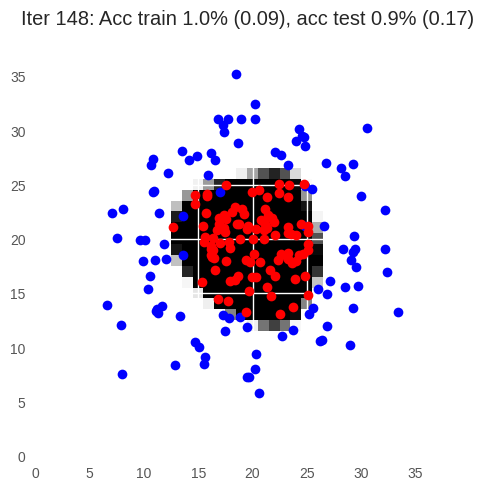

Iter 149: Acc train 1.0% (0.09), acc test 0.9% (0.17)


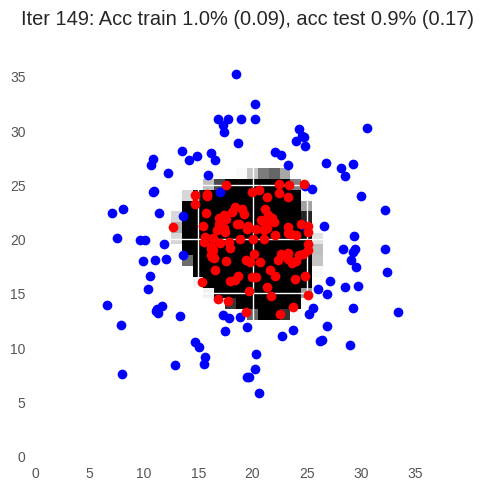

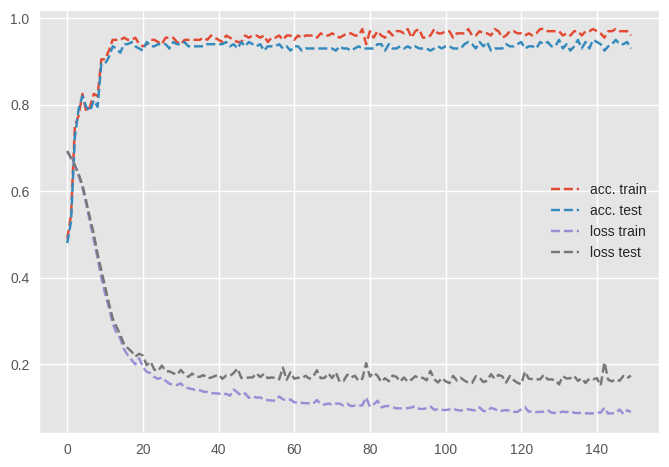

In [25]:
# init
plt.style.use('ggplot')

data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # Zero your gradients for every batch!
        optim.zero_grad()

        # the forward with the predict method from the model
        outputs = model(X)

        # using the functions: loss_accuracy
        batch_loss, _ = loss_accuracy(nn.CrossEntropyLoss(), outputs, Y)

        # the backward function with autograd
        batch_loss.backward()

        # and then an optimization step
        optim.step()


    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(nn.CrossEntropyLoss(), Yhat_train, data.Ytrain)
    Ltrain = Ltrain.item()
    Ltest, acctest = loss_accuracy(nn.CrossEntropyLoss(), Yhat_test, data.Ytest)
    Ltest = Ltest.item()
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")

plt.legend()
plt.show()

# Part 5 : MNIST

Apply the code from previous part code to the MNIST dataset.

In [26]:
def init_model(nx, nh, ny, eta):
    #####################
    ## Your code here  ##
    #####################

    model = simpleNN(input_size = nx, hidden_size=nh, output_size=ny)
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.Adam(model.parameters(), lr=eta)

    ####################
    ##      END        #
    ####################

    return model, loss, optim

In [27]:
# init
data = MNISTData() #from 200, 2 --> 60000, 784
N = data.Xtrain.shape[0]
Nbatch = 32
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03

print(data.Ytrain.unique())
print(data.Xtrain.shape)

tensor([0., 1.])
torch.Size([60000, 784])


In [28]:
# Initialize model for MNIST data
from tqdm import tqdm
model_MNIST = simpleNN(input_size = 28*28, hidden_size = 32, output_size = 10)

  1%|          | 1/100 [00:04<08:07,  4.92s/it]

Iter 0: Acc train 0.1% (2.33), acc test 0.1% (2.33)


  2%|▏         | 2/100 [00:09<07:52,  4.83s/it]

Iter 1: Acc train 0.1% (2.24), acc test 0.1% (2.23)


  3%|▎         | 3/100 [00:13<07:08,  4.42s/it]

Iter 2: Acc train 0.1% (2.28), acc test 0.1% (2.28)


  4%|▍         | 4/100 [00:18<07:13,  4.51s/it]

Iter 3: Acc train 0.2% (2.19), acc test 0.2% (2.19)


  5%|▌         | 5/100 [00:22<07:02,  4.45s/it]

Iter 4: Acc train 0.2% (2.12), acc test 0.2% (2.12)


  6%|▌         | 6/100 [00:26<06:50,  4.37s/it]

Iter 5: Acc train 0.2% (2.16), acc test 0.2% (2.16)


  7%|▋         | 7/100 [00:31<06:55,  4.47s/it]

Iter 6: Acc train 0.2% (2.14), acc test 0.2% (2.13)


  8%|▊         | 8/100 [00:35<06:31,  4.26s/it]

Iter 7: Acc train 0.2% (2.10), acc test 0.2% (2.08)


  9%|▉         | 9/100 [00:39<06:17,  4.15s/it]

Iter 8: Acc train 0.2% (2.04), acc test 0.2% (2.03)


 10%|█         | 10/100 [00:43<06:16,  4.18s/it]

Iter 9: Acc train 0.2% (2.09), acc test 0.2% (2.07)


 11%|█         | 11/100 [00:47<06:07,  4.13s/it]

Iter 10: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 12%|█▏        | 12/100 [00:51<05:55,  4.04s/it]

Iter 11: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 13%|█▎        | 13/100 [00:55<06:06,  4.21s/it]

Iter 12: Acc train 0.1% (2.23), acc test 0.1% (2.22)


 14%|█▍        | 14/100 [01:00<06:17,  4.39s/it]

Iter 13: Acc train 0.1% (2.25), acc test 0.1% (2.25)


 15%|█▌        | 15/100 [01:04<06:02,  4.27s/it]

Iter 14: Acc train 0.1% (2.28), acc test 0.1% (2.28)


 16%|█▌        | 16/100 [01:09<06:14,  4.46s/it]

Iter 15: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 17%|█▋        | 17/100 [01:13<05:54,  4.27s/it]

Iter 16: Acc train 0.1% (2.25), acc test 0.1% (2.25)


 18%|█▊        | 18/100 [01:17<05:36,  4.11s/it]

Iter 17: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 19%|█▉        | 19/100 [01:21<05:33,  4.12s/it]

Iter 18: Acc train 0.1% (2.30), acc test 0.1% (2.30)


 20%|██        | 20/100 [01:25<05:27,  4.09s/it]

Iter 19: Acc train 0.1% (2.28), acc test 0.1% (2.28)


 21%|██        | 21/100 [01:29<05:16,  4.00s/it]

Iter 20: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 22%|██▏       | 22/100 [01:33<05:11,  4.00s/it]

Iter 21: Acc train 0.1% (2.23), acc test 0.1% (2.22)


 23%|██▎       | 23/100 [01:37<05:10,  4.03s/it]

Iter 22: Acc train 0.1% (2.25), acc test 0.1% (2.25)


 24%|██▍       | 24/100 [01:41<05:05,  4.02s/it]

Iter 23: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 25%|██▌       | 25/100 [01:44<04:53,  3.91s/it]

Iter 24: Acc train 0.1% (2.25), acc test 0.1% (2.24)


 26%|██▌       | 26/100 [01:49<04:58,  4.03s/it]

Iter 25: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 27%|██▋       | 27/100 [01:53<04:50,  3.98s/it]

Iter 26: Acc train 0.1% (2.27), acc test 0.1% (2.28)


 28%|██▊       | 28/100 [01:57<04:46,  3.97s/it]

Iter 27: Acc train 0.1% (2.27), acc test 0.1% (2.27)


 29%|██▉       | 29/100 [02:01<04:55,  4.16s/it]

Iter 28: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 30%|███       | 30/100 [02:05<04:49,  4.13s/it]

Iter 29: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 31%|███       | 31/100 [02:09<04:36,  4.01s/it]

Iter 30: Acc train 0.1% (2.29), acc test 0.1% (2.28)


 32%|███▏      | 32/100 [02:14<04:50,  4.27s/it]

Iter 31: Acc train 0.1% (2.25), acc test 0.1% (2.24)


 33%|███▎      | 33/100 [02:18<04:37,  4.15s/it]

Iter 32: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 34%|███▍      | 34/100 [02:22<04:36,  4.19s/it]

Iter 33: Acc train 0.1% (2.28), acc test 0.1% (2.27)


 35%|███▌      | 35/100 [02:26<04:37,  4.27s/it]

Iter 34: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 36%|███▌      | 36/100 [02:30<04:27,  4.18s/it]

Iter 35: Acc train 0.1% (2.22), acc test 0.1% (2.22)


 37%|███▋      | 37/100 [02:35<04:24,  4.19s/it]

Iter 36: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 38%|███▊      | 38/100 [02:39<04:24,  4.26s/it]

Iter 37: Acc train 0.1% (2.22), acc test 0.1% (2.21)


 39%|███▉      | 39/100 [02:43<04:21,  4.29s/it]

Iter 38: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 40%|████      | 40/100 [02:48<04:23,  4.39s/it]

Iter 39: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 41%|████      | 41/100 [02:52<04:16,  4.35s/it]

Iter 40: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 42%|████▏     | 42/100 [02:57<04:11,  4.34s/it]

Iter 41: Acc train 0.1% (2.22), acc test 0.1% (2.22)


 43%|████▎     | 43/100 [03:02<04:17,  4.52s/it]

Iter 42: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 44%|████▍     | 44/100 [03:06<04:11,  4.49s/it]

Iter 43: Acc train 0.1% (2.20), acc test 0.1% (2.20)


 45%|████▌     | 45/100 [03:10<04:04,  4.45s/it]

Iter 44: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 46%|████▌     | 46/100 [03:15<04:10,  4.63s/it]

Iter 45: Acc train 0.1% (2.22), acc test 0.1% (2.21)


 47%|████▋     | 47/100 [03:19<03:54,  4.43s/it]

Iter 46: Acc train 0.1% (2.22), acc test 0.1% (2.21)


 48%|████▊     | 48/100 [03:24<03:54,  4.52s/it]

Iter 47: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 49%|████▉     | 49/100 [03:29<03:53,  4.57s/it]

Iter 48: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 50%|█████     | 50/100 [03:33<03:49,  4.58s/it]

Iter 49: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 51%|█████     | 51/100 [03:38<03:45,  4.60s/it]

Iter 50: Acc train 0.1% (2.20), acc test 0.1% (2.20)


 52%|█████▏    | 52/100 [03:43<03:45,  4.70s/it]

Iter 51: Acc train 0.1% (2.22), acc test 0.1% (2.22)


 53%|█████▎    | 53/100 [03:48<03:40,  4.68s/it]

Iter 52: Acc train 0.1% (2.27), acc test 0.1% (2.27)


 54%|█████▍    | 54/100 [03:53<03:43,  4.86s/it]

Iter 53: Acc train 0.1% (2.23), acc test 0.1% (2.22)


 55%|█████▌    | 55/100 [03:57<03:28,  4.64s/it]

Iter 54: Acc train 0.1% (2.25), acc test 0.1% (2.25)


 56%|█████▌    | 56/100 [04:01<03:20,  4.55s/it]

Iter 55: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 57%|█████▋    | 57/100 [04:06<03:21,  4.69s/it]

Iter 56: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 58%|█████▊    | 58/100 [04:11<03:14,  4.62s/it]

Iter 57: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 59%|█████▉    | 59/100 [04:15<03:04,  4.50s/it]

Iter 58: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 60%|██████    | 60/100 [04:20<03:04,  4.61s/it]

Iter 59: Acc train 0.1% (2.28), acc test 0.1% (2.27)


 61%|██████    | 61/100 [04:24<02:57,  4.55s/it]

Iter 60: Acc train 0.1% (2.28), acc test 0.1% (2.27)


 62%|██████▏   | 62/100 [04:29<02:56,  4.64s/it]

Iter 61: Acc train 0.1% (2.31), acc test 0.1% (2.31)


 63%|██████▎   | 63/100 [04:34<02:51,  4.63s/it]

Iter 62: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 64%|██████▍   | 64/100 [04:38<02:41,  4.49s/it]

Iter 63: Acc train 0.1% (2.21), acc test 0.1% (2.20)


 65%|██████▌   | 65/100 [04:43<02:41,  4.61s/it]

Iter 64: Acc train 0.1% (2.25), acc test 0.1% (2.24)


 66%|██████▌   | 66/100 [04:47<02:34,  4.55s/it]

Iter 65: Acc train 0.1% (2.25), acc test 0.1% (2.24)


 67%|██████▋   | 67/100 [04:51<02:27,  4.46s/it]

Iter 66: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 68%|██████▊   | 68/100 [04:57<02:29,  4.68s/it]

Iter 67: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 69%|██████▉   | 69/100 [05:01<02:24,  4.66s/it]

Iter 68: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 70%|███████   | 70/100 [05:06<02:17,  4.60s/it]

Iter 69: Acc train 0.1% (2.25), acc test 0.1% (2.24)


 71%|███████   | 71/100 [05:11<02:16,  4.70s/it]

Iter 70: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 72%|███████▏  | 72/100 [05:15<02:09,  4.61s/it]

Iter 71: Acc train 0.1% (2.25), acc test 0.1% (2.25)


 73%|███████▎  | 73/100 [05:20<02:06,  4.70s/it]

Iter 72: Acc train 0.1% (2.22), acc test 0.1% (2.21)


 74%|███████▍  | 74/100 [05:25<02:01,  4.68s/it]

Iter 73: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 75%|███████▌  | 75/100 [05:29<01:53,  4.56s/it]

Iter 74: Acc train 0.1% (2.23), acc test 0.1% (2.22)


 76%|███████▌  | 76/100 [05:34<01:54,  4.76s/it]

Iter 75: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 77%|███████▋  | 77/100 [05:39<01:48,  4.70s/it]

Iter 76: Acc train 0.1% (2.22), acc test 0.1% (2.21)


 78%|███████▊  | 78/100 [05:43<01:40,  4.57s/it]

Iter 77: Acc train 0.1% (2.23), acc test 0.1% (2.22)


 79%|███████▉  | 79/100 [05:48<01:36,  4.60s/it]

Iter 78: Acc train 0.1% (2.27), acc test 0.1% (2.26)


 80%|████████  | 80/100 [05:52<01:33,  4.65s/it]

Iter 79: Acc train 0.1% (2.27), acc test 0.1% (2.27)


 81%|████████  | 81/100 [05:57<01:27,  4.59s/it]

Iter 80: Acc train 0.1% (2.24), acc test 0.1% (2.23)


 82%|████████▏ | 82/100 [06:01<01:22,  4.60s/it]

Iter 81: Acc train 0.1% (2.21), acc test 0.1% (2.21)


 83%|████████▎ | 83/100 [06:06<01:16,  4.51s/it]

Iter 82: Acc train 0.1% (2.22), acc test 0.1% (2.22)


 84%|████████▍ | 84/100 [06:11<01:13,  4.62s/it]

Iter 83: Acc train 0.1% (2.21), acc test 0.1% (2.21)


 85%|████████▌ | 85/100 [06:15<01:08,  4.57s/it]

Iter 84: Acc train 0.1% (2.28), acc test 0.1% (2.27)


 86%|████████▌ | 86/100 [06:19<01:01,  4.36s/it]

Iter 85: Acc train 0.1% (2.24), acc test 0.1% (2.24)


 87%|████████▋ | 87/100 [06:24<00:59,  4.58s/it]

Iter 86: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 88%|████████▊ | 88/100 [06:28<00:53,  4.47s/it]

Iter 87: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 89%|████████▉ | 89/100 [06:32<00:47,  4.36s/it]

Iter 88: Acc train 0.1% (2.21), acc test 0.1% (2.21)


 90%|█████████ | 90/100 [06:37<00:44,  4.47s/it]

Iter 89: Acc train 0.1% (2.22), acc test 0.1% (2.21)


 91%|█████████ | 91/100 [06:41<00:39,  4.38s/it]

Iter 90: Acc train 0.1% (2.25), acc test 0.1% (2.25)


 92%|█████████▏| 92/100 [06:46<00:35,  4.41s/it]

Iter 91: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 93%|█████████▎| 93/100 [06:51<00:31,  4.56s/it]

Iter 92: Acc train 0.1% (2.26), acc test 0.1% (2.25)


 94%|█████████▍| 94/100 [06:55<00:26,  4.39s/it]

Iter 93: Acc train 0.1% (2.29), acc test 0.1% (2.29)


 95%|█████████▌| 95/100 [06:59<00:22,  4.40s/it]

Iter 94: Acc train 0.1% (2.26), acc test 0.1% (2.26)


 96%|█████████▌| 96/100 [07:04<00:18,  4.51s/it]

Iter 95: Acc train 0.1% (2.23), acc test 0.1% (2.23)


 97%|█████████▋| 97/100 [07:08<00:13,  4.54s/it]

Iter 96: Acc train 0.1% (2.27), acc test 0.1% (2.26)


 98%|█████████▊| 98/100 [07:13<00:09,  4.54s/it]

Iter 97: Acc train 0.1% (2.22), acc test 0.1% (2.22)


 99%|█████████▉| 99/100 [07:18<00:04,  4.56s/it]

Iter 98: Acc train 0.1% (2.21), acc test 0.1% (2.21)


100%|██████████| 100/100 [07:22<00:00,  4.42s/it]

Iter 99: Acc train 0.1% (2.28), acc test 0.1% (2.28)


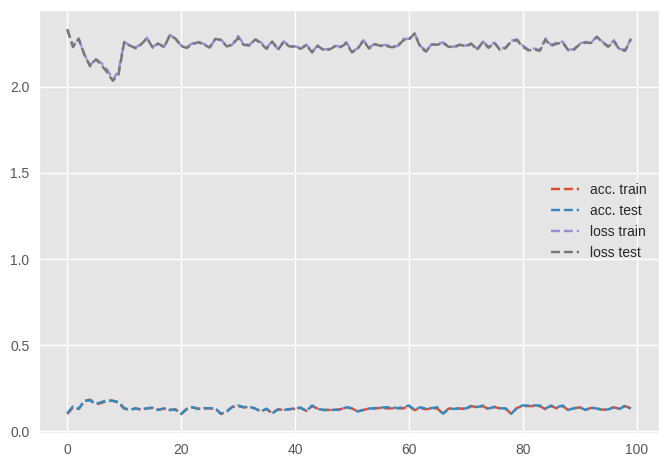

In [29]:
# Write main
plt.style.use('ggplot')

data = MNISTData()

N = data.Xtrain.shape[0]
Nbatch = 32

nx = data.Xtrain.shape[1]

nh = 8

ny = data.Ytrain.shape[1]
eta = 0.05

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in tqdm(range(100)):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # Zero your gradients for every batch!
        optim.zero_grad()

        # the forward with the predict method from the model
        outputs = model(X)

        # using the functions: loss_accuracy
        batch_loss, _ = loss_accuracy(nn.CrossEntropyLoss(), outputs, Y)

        # the backward function with autograd
        batch_loss.backward()

        # and then an optimization step
        optim.step()


    ####################
    ##      FIN        #
    ####################

    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(nn.CrossEntropyLoss(), Yhat_train, data.Ytrain)
    Ltrain = Ltrain.item()
    Ltest, acctest = loss_accuracy(nn.CrossEntropyLoss(), Yhat_test, data.Ytest)
    Ltest = Ltest.item()

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 6: Bonus: SVM


Train a SVM model on the Circles dataset.

Ideas :
- First try a linear SVM (sklearn.svm.LinearSVC dans scikit-learn). Does it work well ? Why ?
- Then try more complex kernels (sklearn.svm.SVC). Which one is the best ? why ?
- Does the parameter C of regularization have an impact? Why ?

In [30]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions):
      plt.figure(2)
      plt.clf()
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

In [31]:
#Imports for plotting

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

#Settings for nicer plots
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']


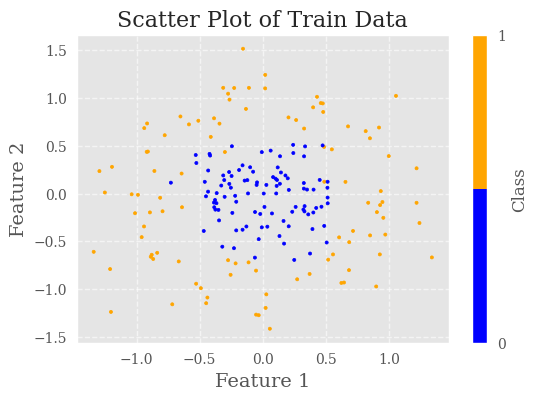

In [32]:
plt.figure(figsize=(6, 4))

#Colors of plot
colors = ['blue', 'orange']
cmap = ListedColormap(colors)

#Plotting
plt.title('Scatter Plot of Train Data', fontsize=16)
scatter = plt.scatter(Xtrain[:, 0], Xtrain[:, 1], s=5, c=Ytrain, cmap=cmap)

#Labels
plt.xlabel('Feature 1', fontsize=14)
plt.ylabel('Feature 2', fontsize=14)

plt.grid(True, linestyle='--', alpha=0.6)
#Color bar
cbar = plt.colorbar(scatter, ticks=np.unique(Ytrain))
cbar.set_label('Class', fontsize=12)

plt.show()

In [33]:
import sklearn.svm

############################
### Your code here   #######
### Train the SVM    #######
## See https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html
## and https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
############################

from sklearn.svm import LinearSVC

clf = LinearSVC(random_state=0, tol=1e-5)
svm = clf.fit(Xtrain, Ytrain)

###########################

Accuracy : 53.00%


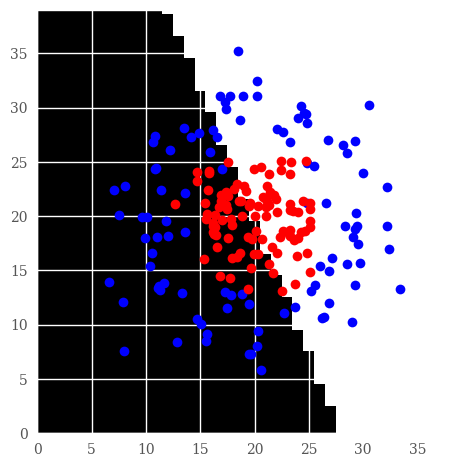

In [34]:
## Print results
Ytest_pred = svm.predict(Xtest)
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}%")
Ygrid_pred = svm.predict(Xgrid)

plot_svm_predictions(data, Ygrid_pred)

#### non-linear SVM:

In [35]:
from sklearn.svm import SVC

clf = SVC(gamma='auto')
svm_nonlinear = clf.fit(Xtrain, Ytrain)

Accuracy : 96.00%


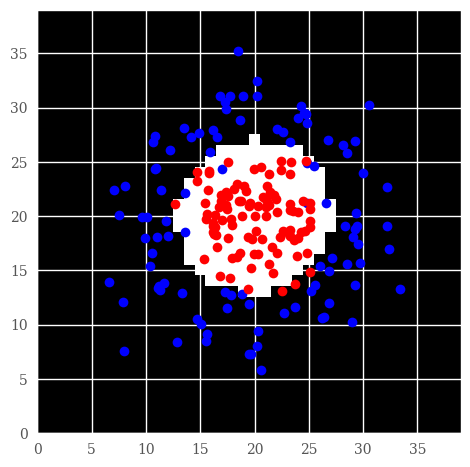

In [36]:
## Print results for non-linear SVM

Ytest_pred = svm_nonlinear.predict(Xtest)
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}%")
Ygrid_pred = svm_nonlinear.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred)